In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

In [2]:
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(8,8))

In [3]:
sc.logging.print_header()

scanpy==1.7.2 anndata==0.7.6 umap==0.5.1 numpy==1.20.3 scipy==1.7.1 pandas==1.2.5 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 louvain==0.7.0


# Load raw data

In [4]:
adata = sc.read_10x_h5('../../../filtered_feature_bc_matrix.h5', gex_only=False)
adata

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 38790 × 191946
    var: 'gene_ids', 'feature_types', 'genome'

In [5]:
adata.obs['samp'] = [idx.split('-')[1] for idx in adata.obs_names]

In [6]:
sample_map = {'1': 'S1D1',
 '2': 'S1D2',
 '3': 'S1D3',
 '4': 'S2D1',
 '5': 'S2D4'
}

adata.obs['sample'] = [sample_map[s] for s in adata.obs['samp']]
del adata.obs['samp']

In [7]:
adata_s2d4 = adata[adata.obs['sample'].isin(['S2D4'])].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [8]:
adata_atac = adata_s2d4[:,adata_s2d4.var['feature_types'].isin(['Peaks'])].copy()
adata_gex = adata_s2d4[:,adata_s2d4.var['feature_types'].isin(['Gene Expression'])].copy()
adata_atac
adata_gex

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


AnnData object with n_obs × n_vars = 10062 × 36601
    obs: 'sample'
    var: 'gene_ids', 'feature_types', 'genome'

In [9]:
adata_gex.var_names_make_unique()

# Test R methods

Note: you might have to set your `.libPaths()` variable to only track the libraries from your conda environment. This can be done by writing something like the following into a jupyter cell:

```
%R .libPaths(.libPaths()c[3,2])
```

The `c[3,2]` should be altered here to give priority to the relevant libraries. Note that the first library is given priority (in this example, the library originally in 3rd position in the `.libPaths()` output.

In [10]:
import rpy2.rinterface_lib.callbacks
import logging
from rpy2.robjects import pandas2ri
import anndata2ri

# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [11]:
%R library(scran)

'scran','scuttle','SingleCe...,...,'datasets','methods','base'


# QC

QC is done mainly by filtering jointly on the number of counts, the number of genes, and considering the fraction of mitochondrial reads

In [12]:
# Compute QC metrics
adata_gex.var["mt"] = adata_gex.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata_gex, qc_vars=["mt"], inplace=True)

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


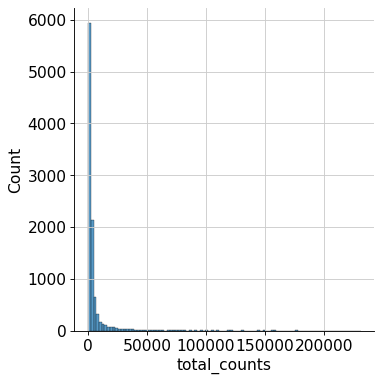

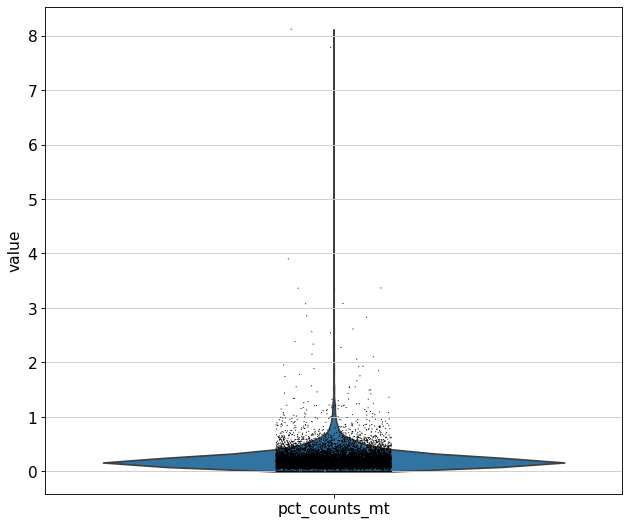

In [13]:
t1 = sns.displot(adata_gex.obs['total_counts'], bins=100, kde=False)
t2 = sc.pl.violin(adata_gex, 'pct_counts_mt')

Note there is quite low MT read fraction (mostly <5%), so might not need to filter on this, unless this coincides with low count depth and low number of genes.

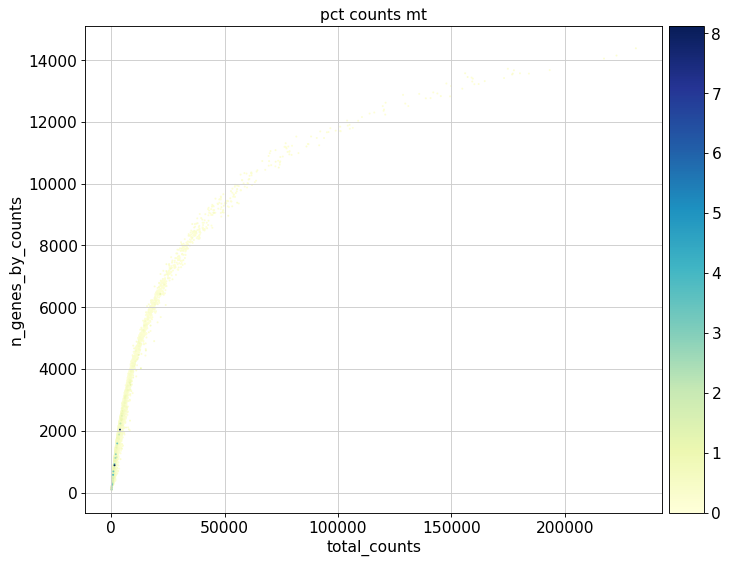

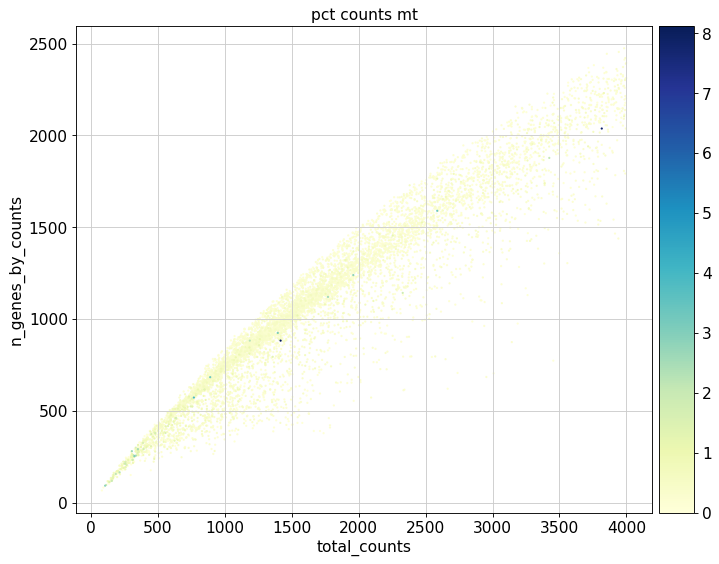

In [14]:
#Data quality summary plots
p1 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')
p2 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<4000], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt')

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


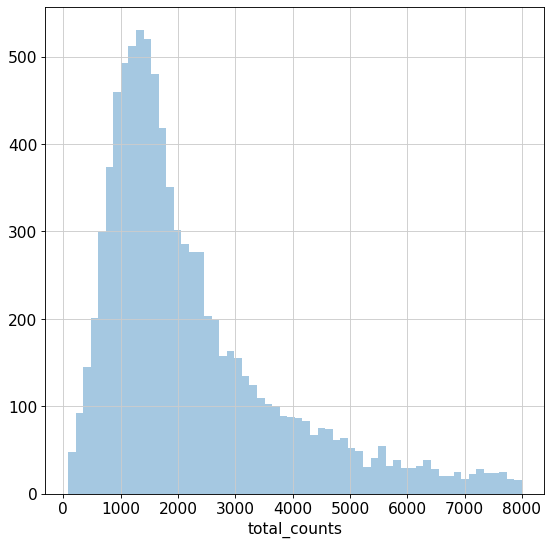

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


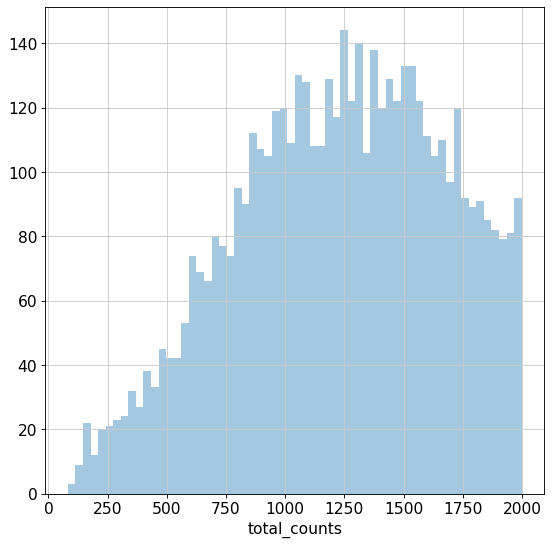

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


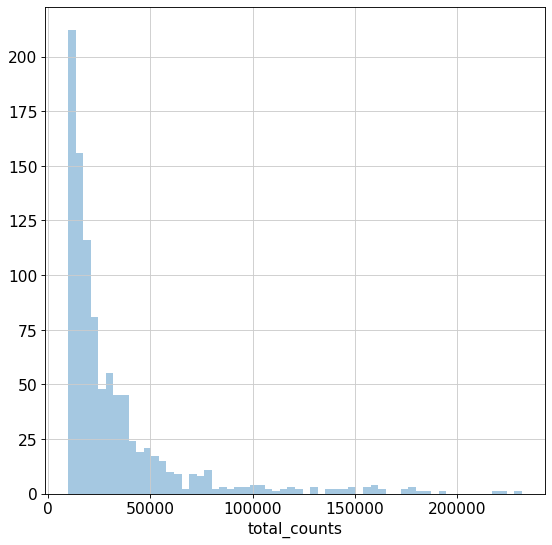

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


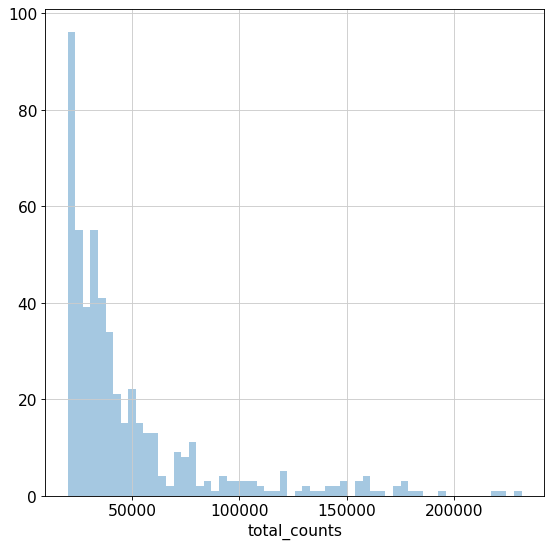

In [15]:
#Thresholding decision: counts
# Here we check the univariate distributions for low-quality outlier peaks. We especially zoom in on lower values
p3 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<8000], kde=False, bins=60)
plt.show()

p4 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']<2000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>10000], kde=False, bins=60)
plt.show()

p6 = sns.distplot(adata_gex.obs['total_counts'][adata_gex.obs['total_counts']>20000], kde=False, bins=60)
plt.show()

Thresholding options:

Lower bound:
- 250
- 500 -> use this
- 1100

Upper bound:
- 25,000 -> go for this
- 32,000
- 50,000

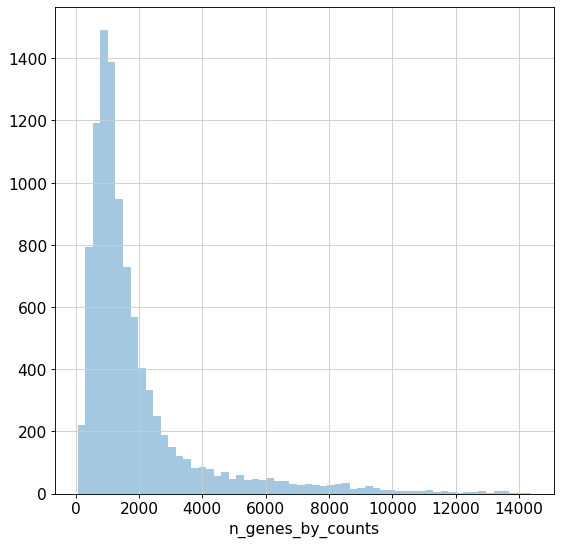

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


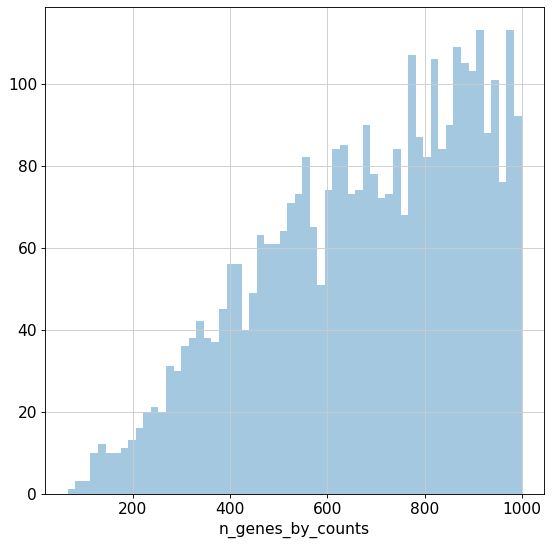

In [16]:
#Thresholding decision: genes
p7 = sns.distplot(adata_gex.obs['n_genes_by_counts'], kde=False, bins=60)
plt.show()

p8 = sns.distplot(adata_gex.obs['n_genes_by_counts'][adata_gex.obs['n_genes_by_counts']<1000], kde=False, bins=60)
plt.show()


Gene thresholding options:
- 200 -> try this first
- 600

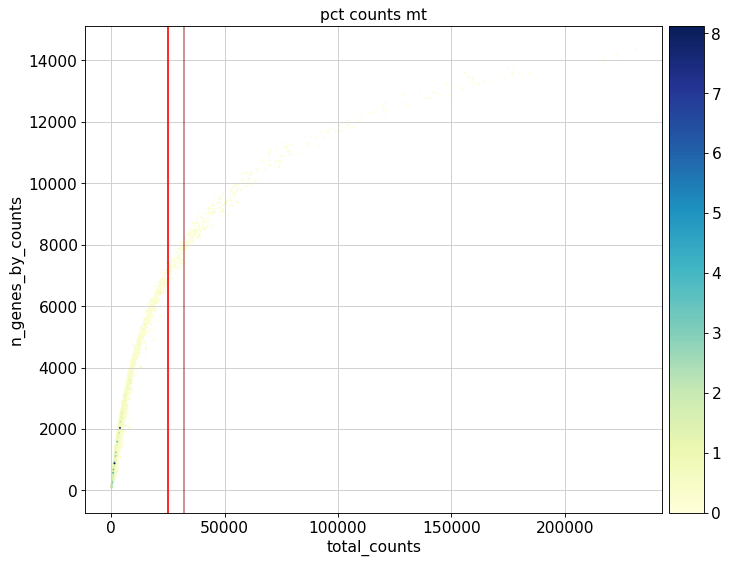

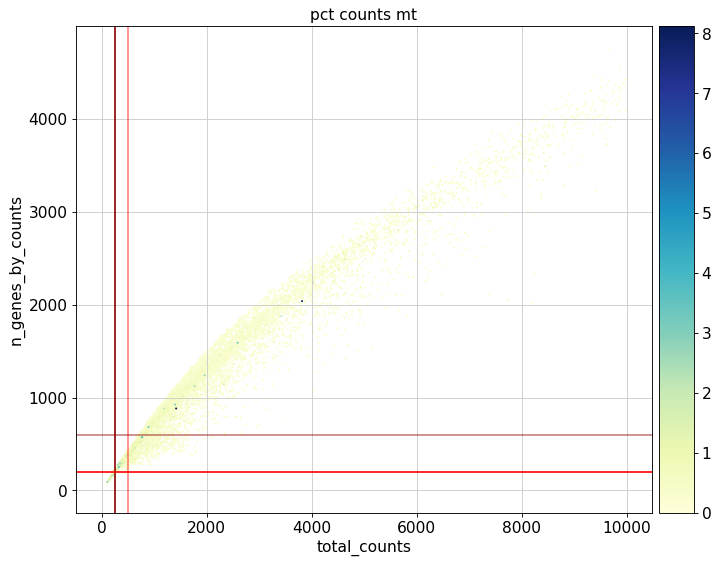

In [17]:
# Visualize the chosen thresholds jointly, before filtering out cells
counts_upper = 25000
counts_upper_alt = 32000
counts_lower = 500
counts_lower_alt = 250
genes_lower = 200
genes_lower_alt = 600

p9 = sc.pl.scatter(adata_gex, 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p9.axline((counts_upper,0),(counts_upper,1), color='red')
p9.axline((counts_upper_alt,0),(counts_upper_alt,1), color='darkred', alpha=0.5)
plt.show()

count_lim = 10000
p10 = sc.pl.scatter(adata_gex[adata_gex.obs['total_counts']<count_lim], 'total_counts', 'n_genes_by_counts', color='pct_counts_mt', show=False)
p10.axline((counts_lower,0),(counts_lower,1), color='red', alpha=0.5)
p10.axline((counts_lower_alt,0),(counts_lower_alt,1), color='darkred')
p10.axline((0,genes_lower),(1,genes_lower), color='red')
p10.axline((0,genes_lower_alt),(1,genes_lower_alt), color='darkred', alpha=0.5)
plt.show()

Final thresholding decisions:
- Counts lower: 500 (but 250 might work too)
- Counts upper: 25k is fine
- Genes: 200 is final
- no MT threshold is needed

These thresholds were chosen to preserve the group of cells moving away from the main distribution at around 620 counts, but still remove most higher MT fraction cells. Using a less permissive upper count threshold is fine, as these cells are often challenging to annotate and might be doublets.

In [18]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_counts = 500)
print('Number of cells after min count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, max_counts = 25000)
print('Number of cells after max count filter: {:d}'.format(adata_gex.n_obs))

sc.pp.filter_cells(adata_gex, min_genes = 200)
print('Number of cells after gene filter: {:d}'.format(adata_gex.n_obs))

Total number of cells: 10062
Number of cells after min count filter: 9750
Number of cells after max count filter: 9350
Number of cells after gene filter: 9350


In [19]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_gex.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_gex, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_gex.n_vars))

Total number of genes: 36601
Number of genes after cell filter: 18507


# Normalization

In [20]:
#Perform a clustering for scran normalization in clusters
adata_pp = adata_gex.copy()
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.leiden(adata_pp, key_added='groups', resolution=0.5)

In [21]:
#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata_gex.X.T.A

In [22]:
%%R -i data_mat -i input_groups -o size_factors

size_factors = sizeFactors(computeSumFactors(SingleCellExperiment(list(counts=data_mat)), clusters=input_groups, min.mean=0.1))

In [23]:
#Delete adata_pp
del adata_pp

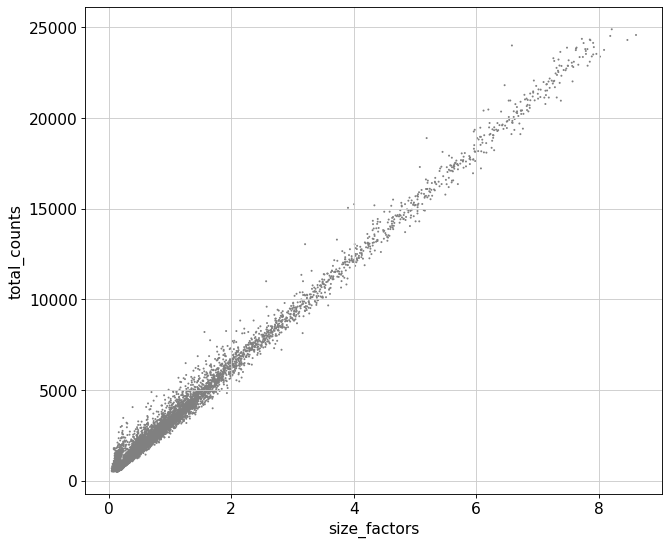

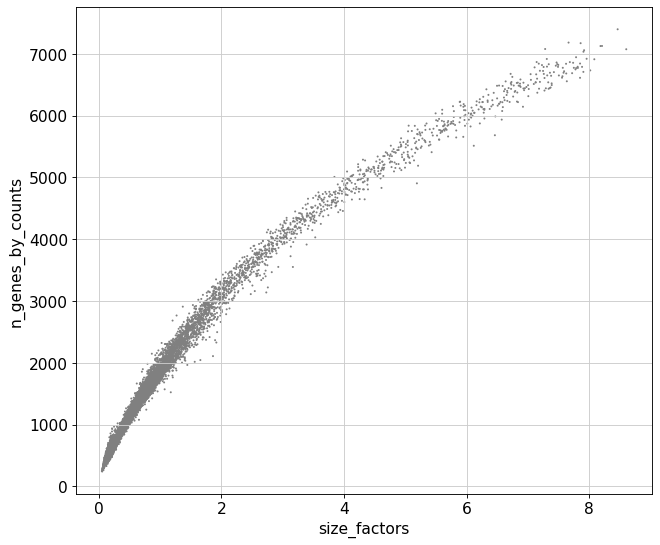

/srv/conda/envs/saturn/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


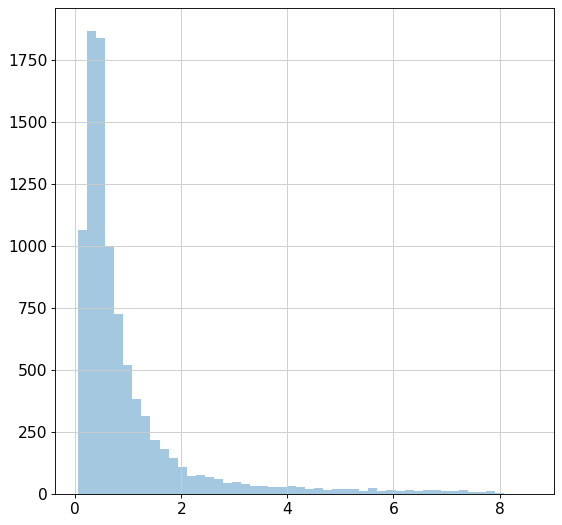

In [24]:
# Visualize the estimated size factors
adata_gex.obs['size_factors'] = size_factors

sc.pl.scatter(adata_gex, 'size_factors', 'total_counts')
sc.pl.scatter(adata_gex, 'size_factors', 'n_genes_by_counts')

sns.distplot(size_factors, bins=50, kde=False)
plt.show()

No size factorss are below 0, and the range of size factors is manageable (not >10, and mostly <4)

In [25]:
#Keep the count data in a counts layer
adata_gex.layers["counts"] = adata_gex.X.copy()

#Normalize adata 
adata_gex.X /= adata_gex.obs['size_factors'].values[:,None]
sc.pp.log1p(adata_gex)

#Transform back into a sparse matrix
adata_gex.X = sp.sparse.csr_matrix(adata_gex.X)

#Store the full data set in 'raw' as log-normalised data for statistical testing
adata_gex.raw = adata_gex

# HVGs

In [26]:
sc.pp.highly_variable_genes(adata_gex, flavor='cell_ranger', n_top_genes=4000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_gex.var['highly_variable'])))


 Number of highly variable genes: 4000


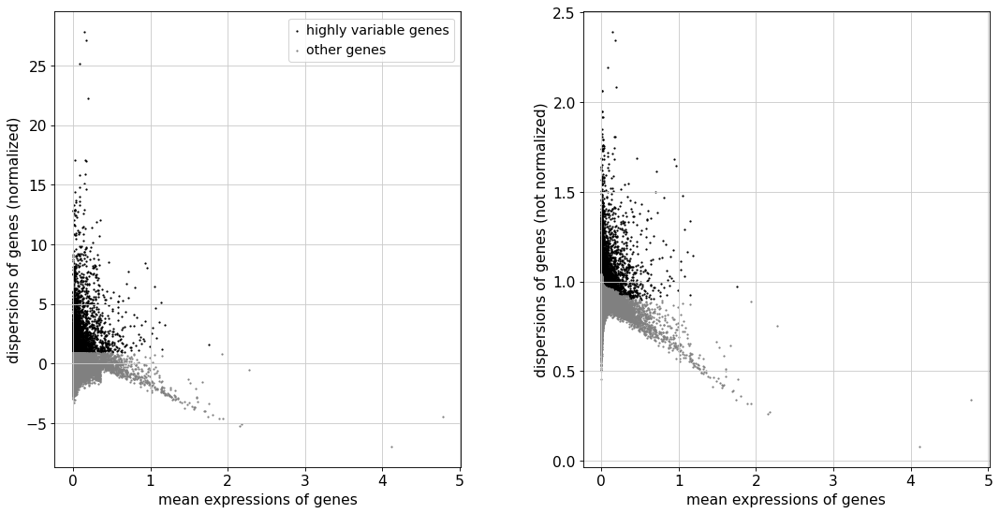

In [27]:
sc.pl.highly_variable_genes(adata_gex)

# Visualization

In [28]:
# Calculate the visualizations
sc.pp.pca(adata_gex, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_gex)
sc.tl.umap(adata_gex)

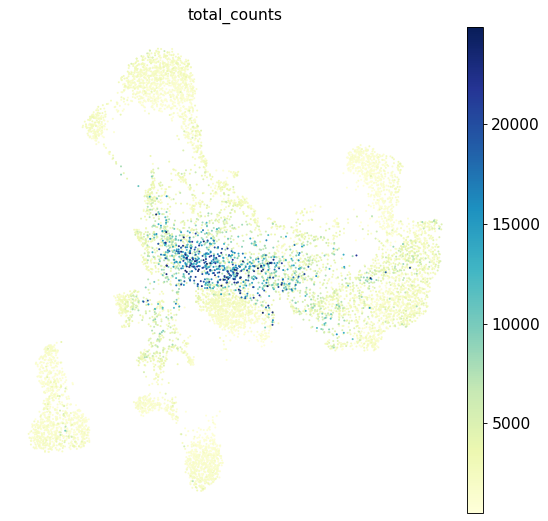

In [29]:
sc.pl.umap(adata_gex, color='total_counts')

We see a high count area aggregated in the middle of the UMAP... this can be problematic, but we can deal with this later as well.

# CC scoring

In [30]:
cc_genes_file = '../gene_lists/Macosko_cell_cycle_genes.txt'

In [31]:
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, s_genes)]
g2m_genes_ens = adata_gex.var_names[np.in1d(adata_gex.var_names, g2m_genes)]

sc.tl.score_genes_cell_cycle(adata_gex, s_genes=s_genes_ens, g2m_genes=g2m_genes_ens)

... storing 'phase' as categorical


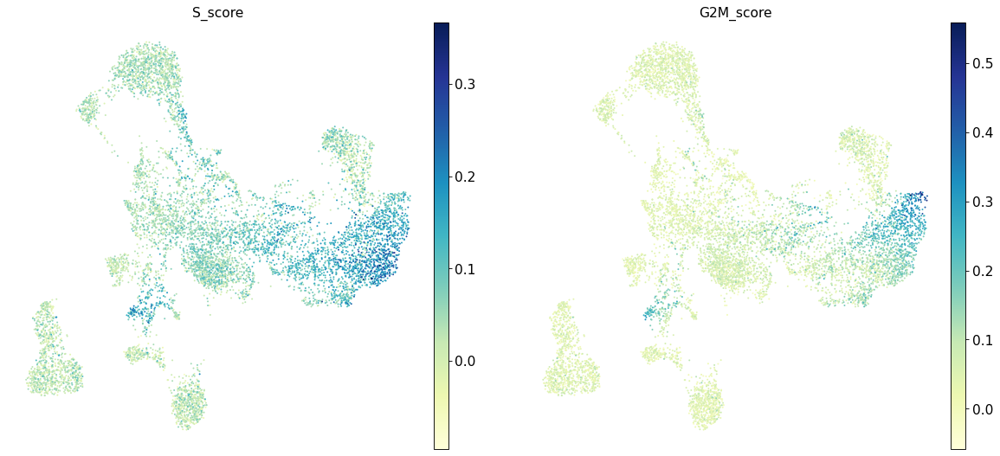

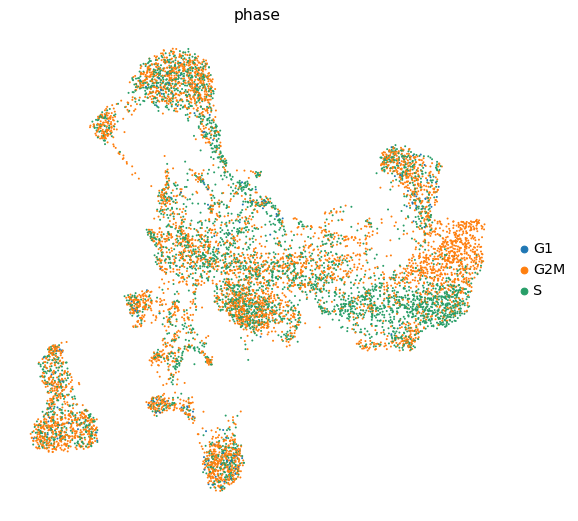

In [32]:
sc.pl.umap(adata_gex, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata_gex, color='phase', use_raw=False)

There is 1 cluster with a clear cell cycle separation, this is likely cycling erythroblasts. This gives the first hint at where the erythrocyte differentiation trajectory is.

# Clustering

Let the fun begin! First step, cluster at several resolutions and select the resolution that broadly captures the structure you see in the UMAP. Try to avoid getting into detailed substructure already at this early stage.

In [33]:
sc.tl.leiden(adata_gex, resolution=0.3, key_added='leiden_res0.3')
sc.tl.leiden(adata_gex, resolution=0.5, key_added='leiden_res0.5')
sc.tl.leiden(adata_gex, resolution=0.8, key_added='leiden_res0.8')
sc.tl.leiden(adata_gex, resolution=1, key_added='leiden_res1')

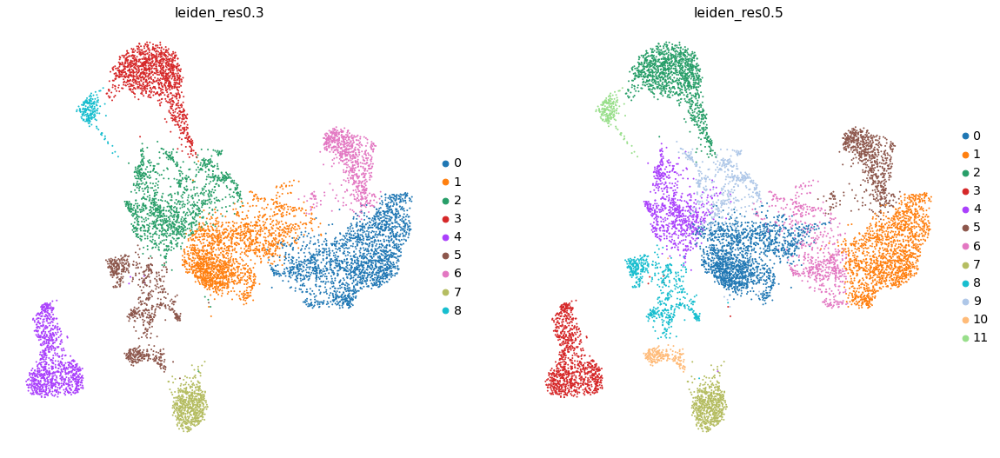

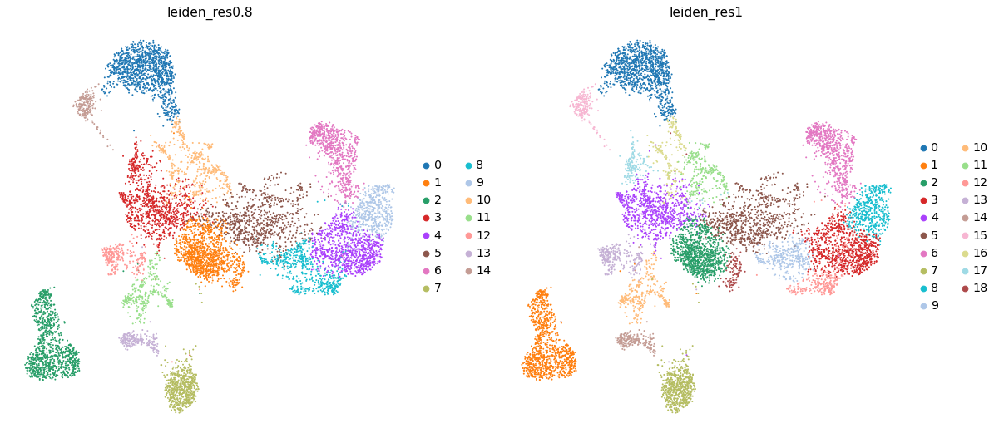

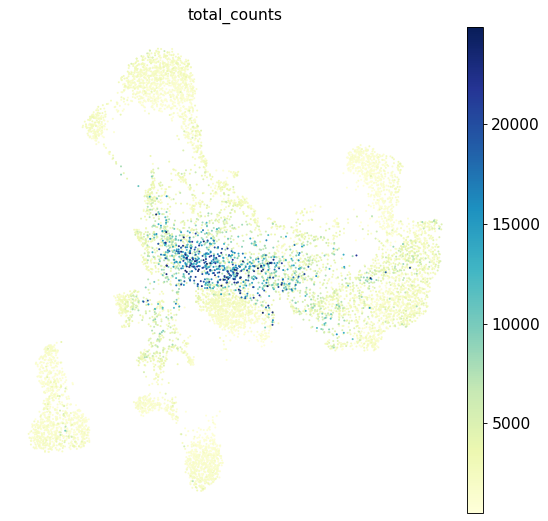

In [34]:
sc.pl.umap(adata_gex, color=['leiden_res0.3', 'leiden_res0.5'])
sc.pl.umap(adata_gex, color=['leiden_res0.8', 'leiden_res1'])
sc.pl.umap(adata_gex, color='total_counts')

Check which clusters have the problematic aggregation of high-count cells... these might be difficult to annotate and could be doublets.

# Doublet detection

Doublet detection to gain extra evidence for which cells are actually two separate cells that happen to be assigned to the same barcode (doublets).

In [35]:
test_dat = adata_gex.copy()
test_dat.X = adata_gex.raw.X

In [36]:
sc.external.pp.scrublet(test_dat)

/srv/conda/envs/saturn/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.61
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 4.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 3.2%


In [37]:
sc.external.pl.scrublet_score_distribution(test_dat)

(<Figure size 640x240 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

The distribution of simulated doublets show that potentially a score over 0.25 is already indicative of a doublet. Note that not all doublets will be detectable in this way and it will be more valuable to remove entire clusters based on these scores.

In [38]:
adata_gex.obs['doublet_score'] = test_dat.obs['doublet_score']
adata_gex.obs['predicted_doublet'] = test_dat.obs['predicted_doublet'].astype(str)

In [39]:
del test_dat

... storing 'predicted_doublet' as categorical


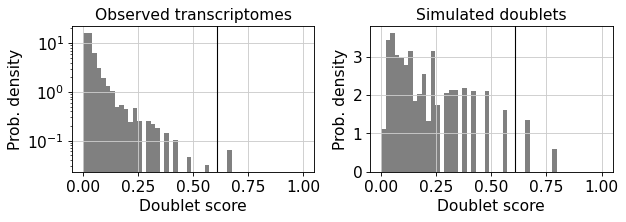

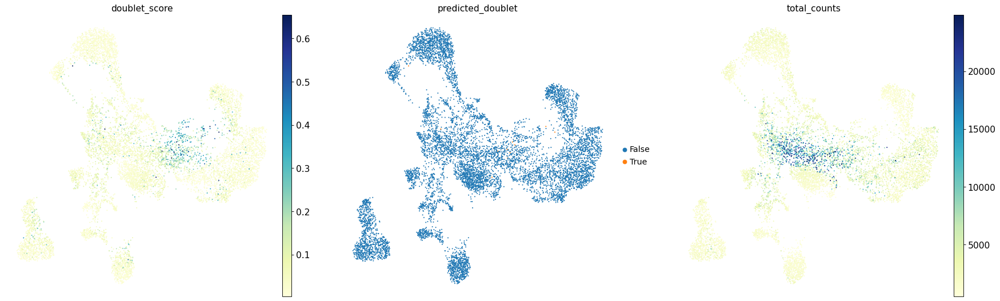

In [40]:
sc.pl.umap(adata_gex, color=['doublet_score', 'predicted_doublet', 'total_counts'])

# Marker genes

In [41]:
!old one
marker_genes = {
    'CD14+ Mono': ['FCN1', 'CD14'],
    'CD16+ Mono': ['TCF7L2', 'FCGR3A', 'LYN'],
    'CD14+ Mono prog': ['CD14', 'ID2', 'VCAN', 'S100A9', 'CLEC12A', 'KLF4', 'PLAUR'],
    'cDC2': ['CLEC10A', 'FCER1A', 'CST3', 'COTL1', 'LYZ', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['SLC4A1', 'SLC25A37', 'HBB', 'HBA2', 'HBA1', 'TFRC'],
    'Erythroblast': ['MKI67', 'HBA1', 'HBB'],
    'Proerythroblast': ['CDK6', 'SYNGR1', 'HBM', 'GYPA'], #, 'CRACD' # Note HBM and GYPA are negative markers
    'NK': ['GNLY', 'NKG7', 'CD247', 'GRIK4'],
    'ILC': ['ID2', 'PLCG2', 'GNLY', 'SYNE1'],
    'Lymph prog': ['IGLL1', 'VPREB1', 'MME', 'EBF1', 'SSBP2', 'BACH2', 'CD79B', 'IGHM', 'PAX5', 'PRKCE', 'DNTT'],
    'Naive CD20+ B': ['MS4A1', 'IL4R', 'IGHD', 'FCRL1', 'IGHM'],
    'B1 B': ['MS4A1', 'SSPN', 'ITGB1', 'EPHA4', 'COL4A4', 'IGHD', 'IGHM'], # Note IGHD and IGHM are negative markers
    'Transitional B': ['MME', 'CD38', 'CD24', 'ACSM3', 'MSI2'],
    'Plasma cells': ['MZB1', 'HSP90B1', 'FNDC3B', 'PRDM1', 'IGKC', 'JCHAIN'],
    'CD4+ T activated': ['CD4', 'IL7R', 'TRBC2', 'ITGB1'],
    'CD4+ T naive': ['CD4', 'IL7R', 'TRBC2'],
    'CD8+ T': ['CD8A', 'CD8B', 'GZMB', 'GZMA'],
    'pDCs': ['GZMB', 'IL3RA', 'COBLL1', 'TCF4'],
    'HSPC/Mono prog': ['MPO', 'BCL2', 'KCNQ5', 'CSF3R', 'PRTN3'],
    'HSC': ['NRIP1', 'MECOM', 'PROM1', 'CD34', 'NKAIN2'],
    'MK/E prog': ['ZNF385D', 'ITGA2B', 'RYR3', 'PLCB1']
}


/bin/bash: old: command not found


In [81]:
marker_genes = {
    'CD14+ Mono': ['FCN1', 'CD14'],
    'CD16+ Mono': ['TCF7L2', 'FCGR3A', 'LYN'],
    'ID2-hi myeloid prog': ['CD14', 'ID2', 'VCAN', 'S100A9', 'CLEC12A', 'KLF4', 'PLAUR'],
    'cDC1': ['CLEC9A', 'CADM1'],
    'cDC2': ['CLEC10A', 'FCER1A', 'CST3', 'COTL1', 'LYZ', 'DMXL2'], # Note: DMXL2 should be negative
    'Reticulocyte': ['SLC4A1', 'SLC25A37', 'HBB', 'HBA2', 'HBA1', 'TFRC'],
    'Erythroblast': ['MKI67', 'HBA1', 'HBB'],
    'Proerythroblast': ['CDK6', 'SYNGR1', 'HBM', 'GYPA'], #, 'CRACD' # Note HBM and GYPA are negative markers
    'NK': ['GNLY', 'NKG7', 'CD247', 'GRIK4', 'FCER1G', 'TYROBP', 'KLRG1', 'FCGR3A'],
    'ILC': ['ID2', 'PLCG2', 'GNLY', 'SYNE1'],
    'Lymph prog': ['IGLL1', 'VPREB1', 'MME', 'EBF1', 'SSBP2', 'BACH2', 'CD79B', 'IGHM', 'PAX5', 'PRKCE', 'DNTT'],
    'Naive CD20+ B': ['MS4A1', 'IL4R', 'IGHD', 'FCRL1', 'IGHM'],
    'B1 B': ['MS4A1', 'SSPN', 'ITGB1', 'EPHA4', 'COL4A4', 'PRDM1', 'ZNF215', 'IRF4', 'CD38', 'XBP1', 'PAX5', 'BCL11A', 'BLK', 'IGHD', 'IGHM'], # Note IGHD and IGHM are negative markers
    'Transitional B': ['MME', 'CD38', 'CD24', 'ACSM3', 'MSI2'],
    'Plasma cells': ['MZB1', 'HSP90B1', 'FNDC3B', 'PRDM1', 'IGKC', 'JCHAIN'],
    'Plasmablast': ['XBP1', 'RF4', 'PRDM1', 'PAX5'],  # Note PAX5 is a negative marker
    'CD4+ T activated': ['CD4', 'IL7R', 'TRBC2', 'ITGB1'],
    'CD4+ T naive': ['CD4', 'IL7R', 'TRBC2', 'CCR7'],
    'CD8+ T': ['CD8A', 'CD8B', 'GZMB', 'GZMA', 'CCL5', 'GZMK', 'GZMH', 'GZMA'],
    'T activation': ['CD69', 'CD38'], # CD69 much better marker!
    'T naive': ['LEF1', 'CCR7', 'TCF7'],
    'pDCs': ['GZMB', 'IL3RA', 'COBLL1', 'TCF4'],
    'G/M prog': ['MPO', 'BCL2', 'KCNQ5', 'CSF3R', 'PRTN3'],
    'HSC': ['NRIP1', 'MECOM', 'PROM1', 'CD34', 'NKAIN2'],
    'MK/E prog': ['ZNF385D', 'ITGA2B', 'RYR3', 'PLCB1']
}

In [43]:
sc.tl.rank_genes_groups(adata_gex, groupby='leiden_res0.5', key_added='rank_genes_res0.5')

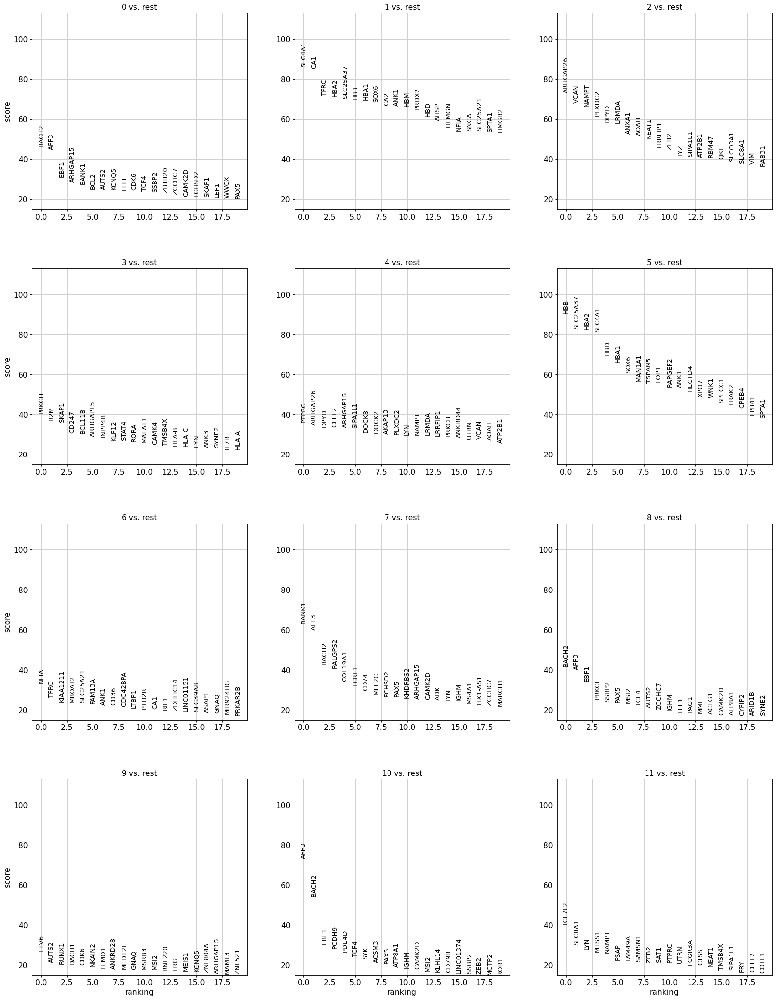

In [44]:
sc.pl.rank_genes_groups(adata_gex, key='rank_genes_res0.5', ncols=3, fontsize=12)

## Literature markers

In [45]:
from matplotlib import colors

In [46]:
#Define a nice colour map for gene expression
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,3))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [47]:
sns.heatmap(sc.tl.marker_gene_overlap(adata_gex, reference_markers=marker_genes, key='rank_genes_res0.5'), annot=True)

<AxesSubplot:>

First overview of clusters suggests:
- 0: lymph prog./ Transitional B
- 1: Reticulocyte / Erythroblast
- 2: CD14+ Mono prog/cDC2
- 3: 
- 4: 
- 5: Reticulocyte / Erythroblast
- 6: Reticulocyte / Proerythroblast
- 7: Lymph Prog / Naive CD20 + B / B1 B
- 8: Lymph Prog
- 9: HSC
- 10: Lymph Prog / Transitional B
- 11: CD16+ Mono/ cDC2

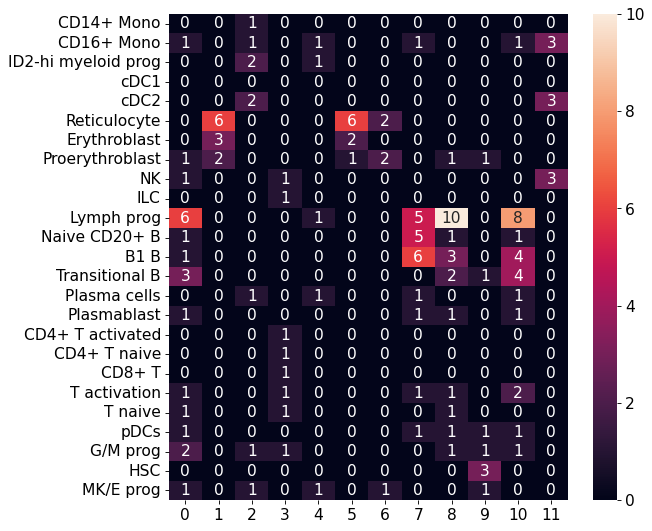

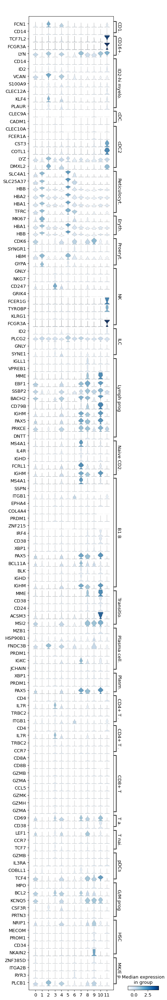

In [48]:
# Look at the marker genes in a concise manner
filt_marker_genes = dict()
for key,val in marker_genes.items():
    filt_vals = [i for i in val if i in adata_gex.var_names]
    filt_marker_genes[key] = filt_vals

adata_plot = adata_gex.copy()
sc.pp.scale(adata_plot, max_value=5)
    
sc.pl.stacked_violin(adata_plot, var_names = filt_marker_genes, groupby='leiden_res0.5', use_raw=False, swap_axes=True)

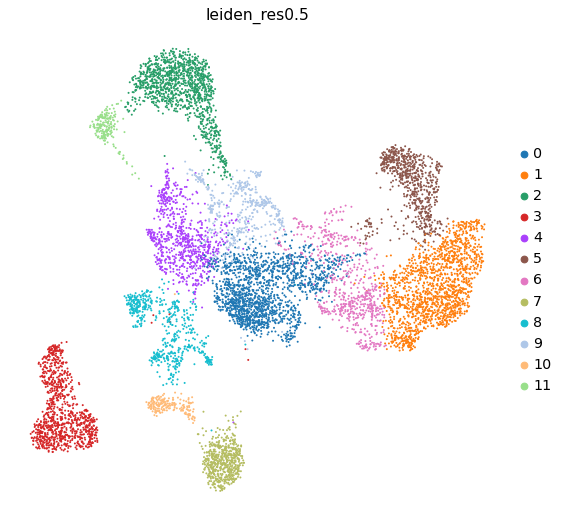

In [49]:
sc.pl.umap(adata_gex, color=['leiden_res0.5'])

First overview of clusters suggests:
- 0: lymph prog./ Transitional B
- 1: Reticulocyte / Erythroblast
- 2: CD14+ Mono prog/cDC2
- 3: 
- 4: 
- 5: Reticulocyte / Erythroblast
- 6: Reticulocyte / Proerythroblast
- 7: Lymph Prog / Naive CD20 + B / B1 B
- 8: Lymph Prog
- 9: HSC
- 10: Lymph Prog / Transitional B
- 11: CD16+ Mono/ cDC2

Cluster: CD14+ Mono


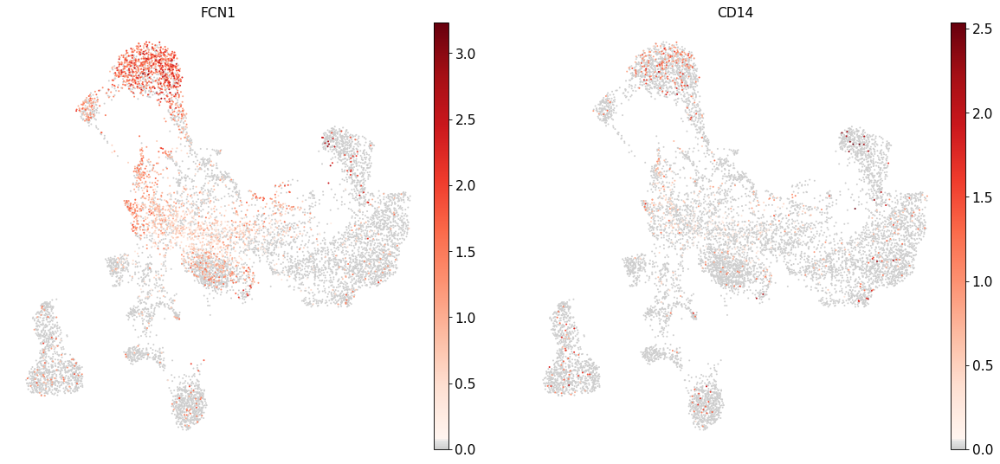

Cluster: CD16+ Mono


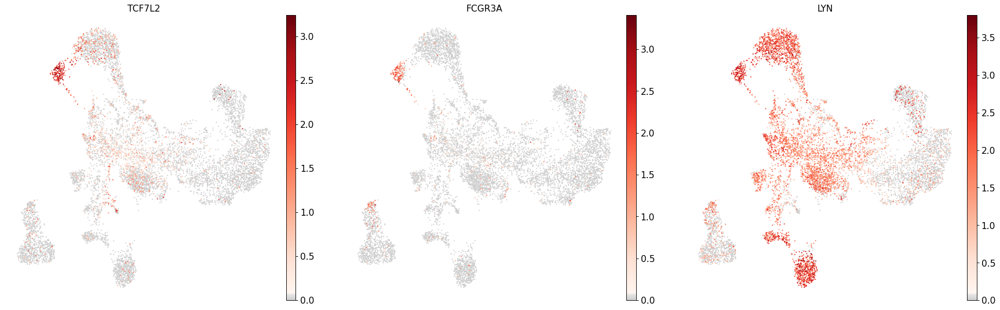

Cluster: ID2-hi myeloid prog


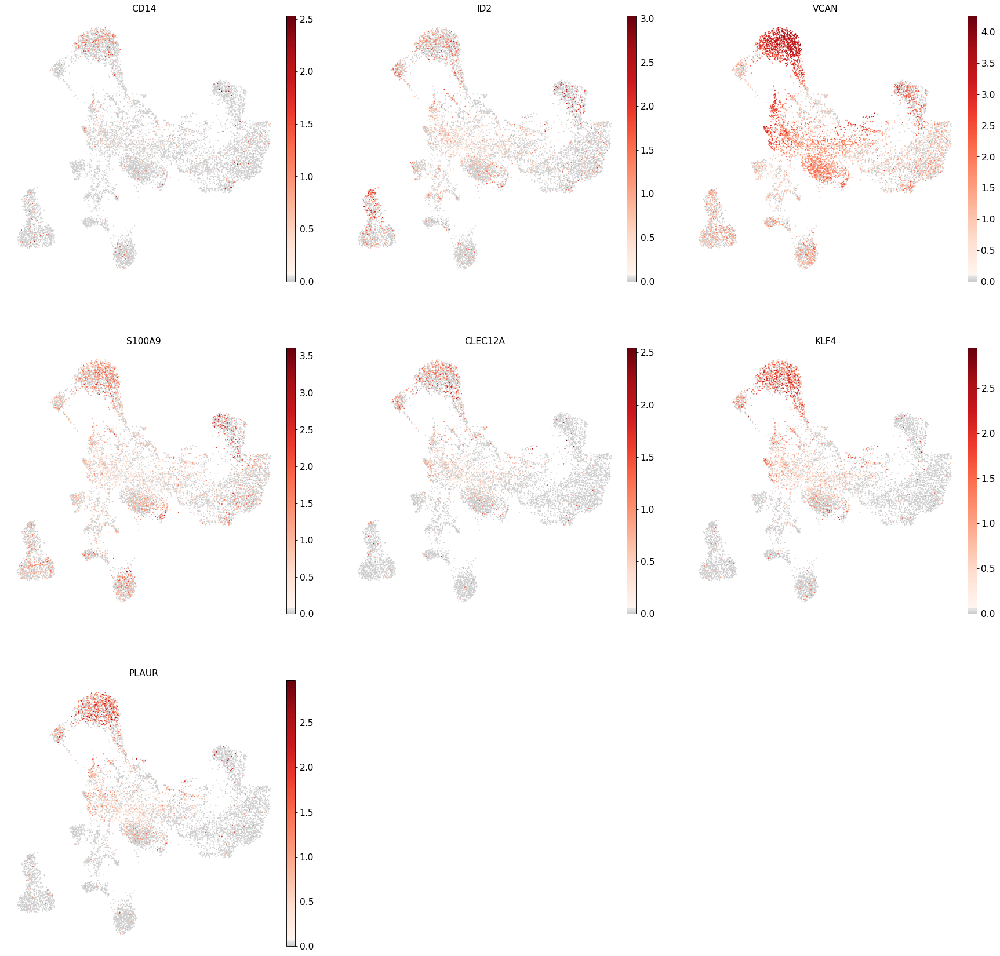

Cluster: cDC1


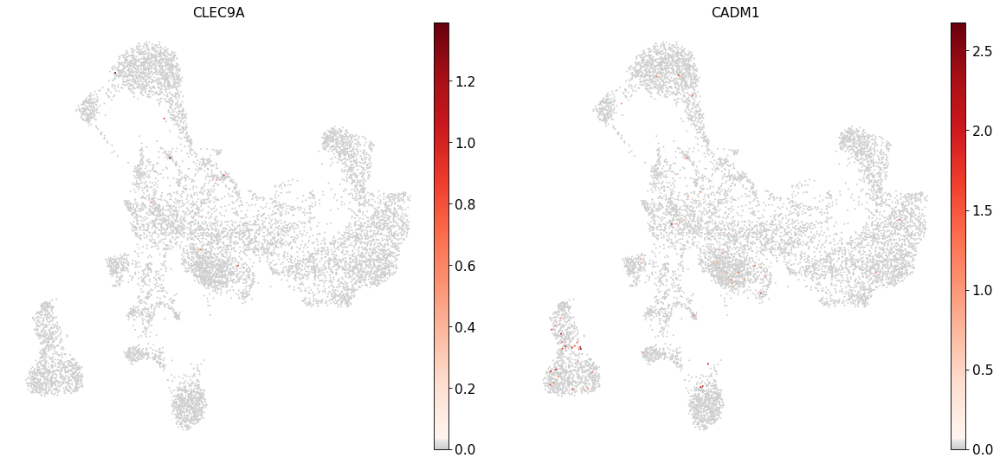

Cluster: cDC2


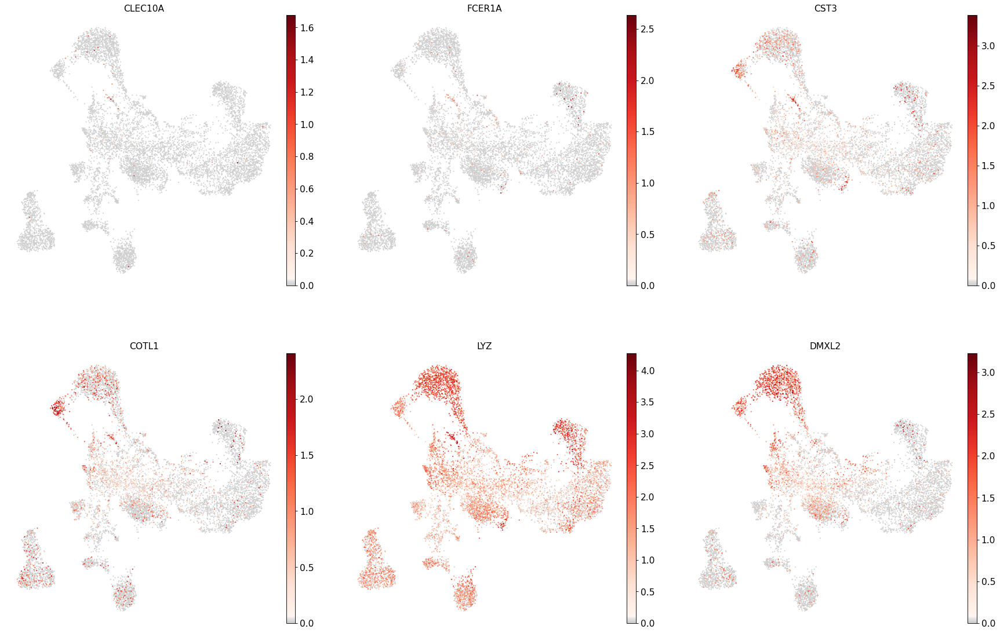

Cluster: Reticulocyte


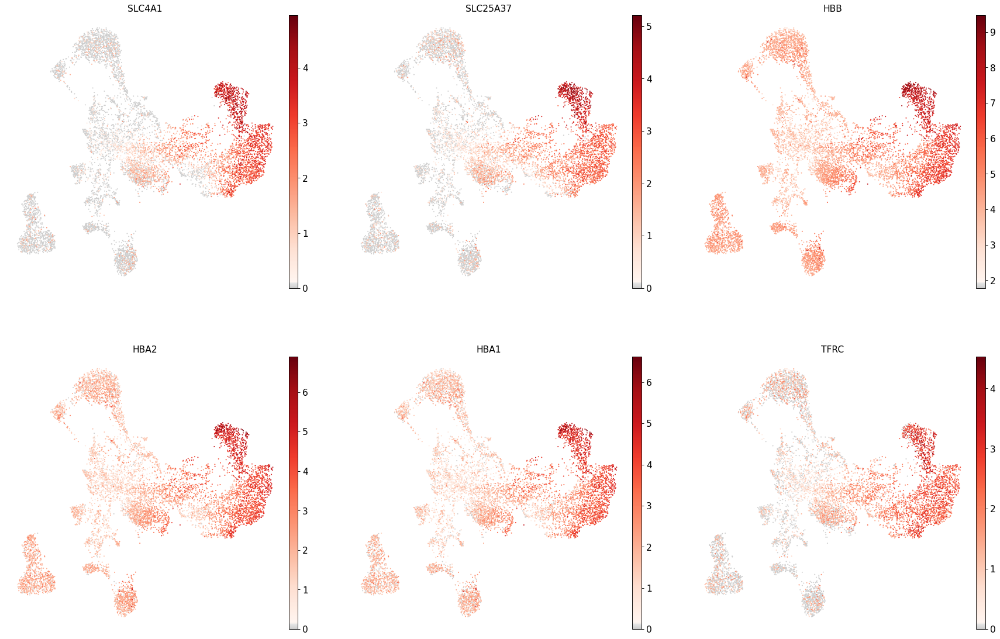

Cluster: Erythroblast


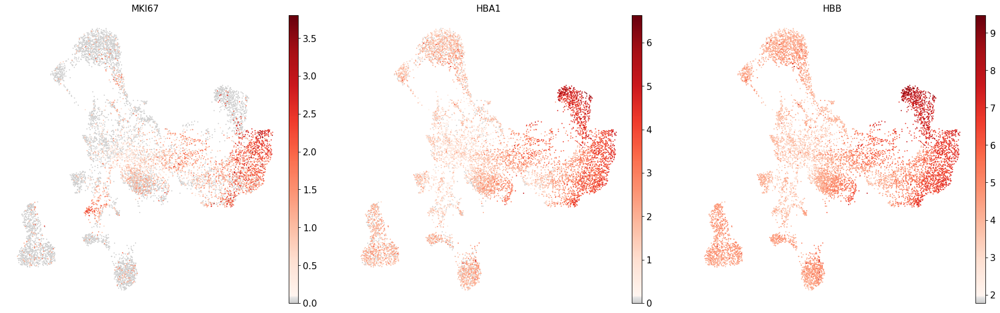

Cluster: Proerythroblast


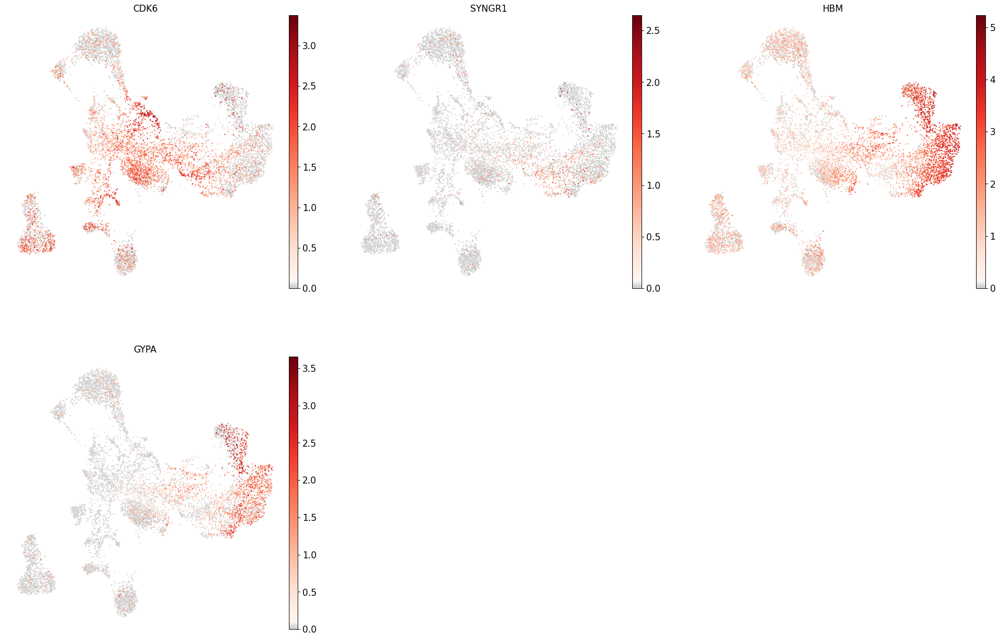

Cluster: NK


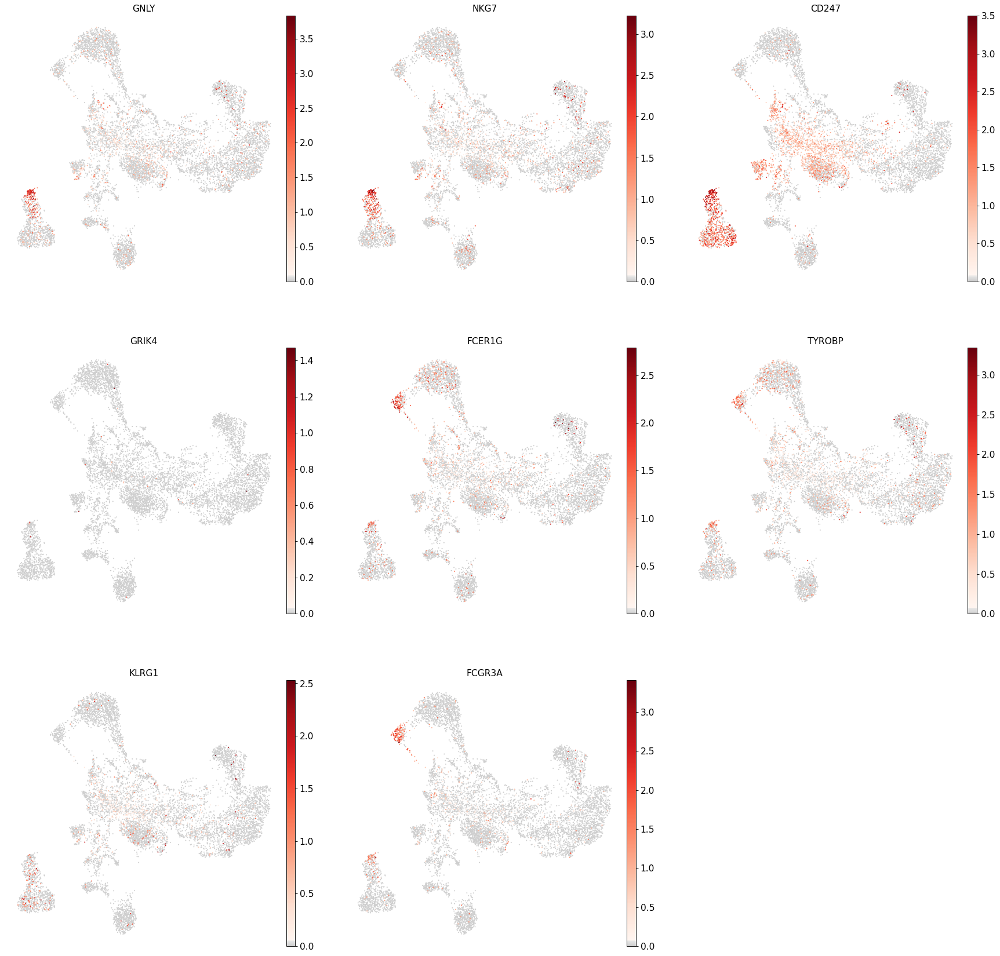

Cluster: ILC


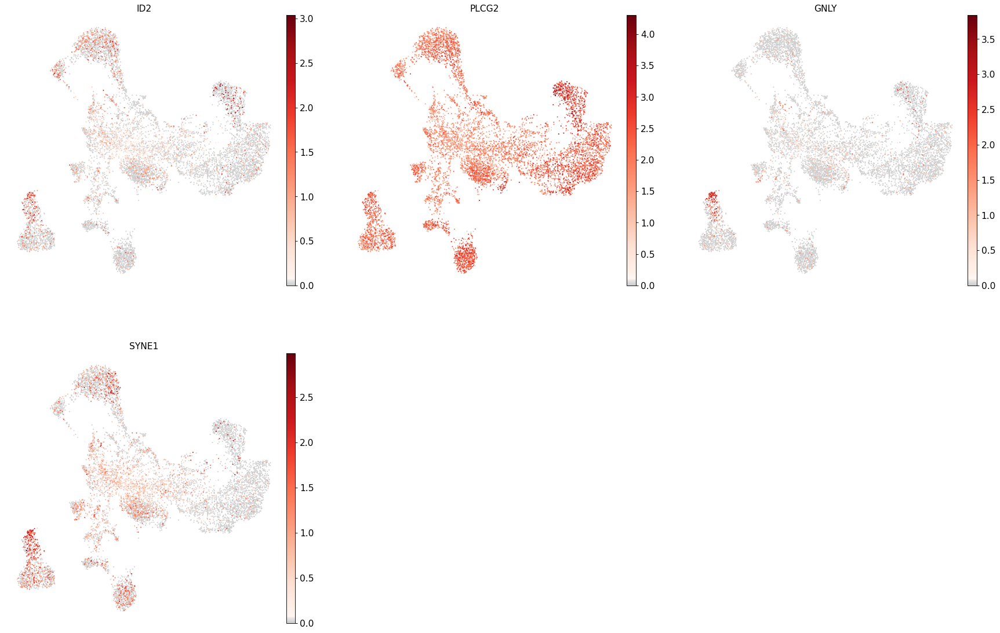

Cluster: Lymph prog


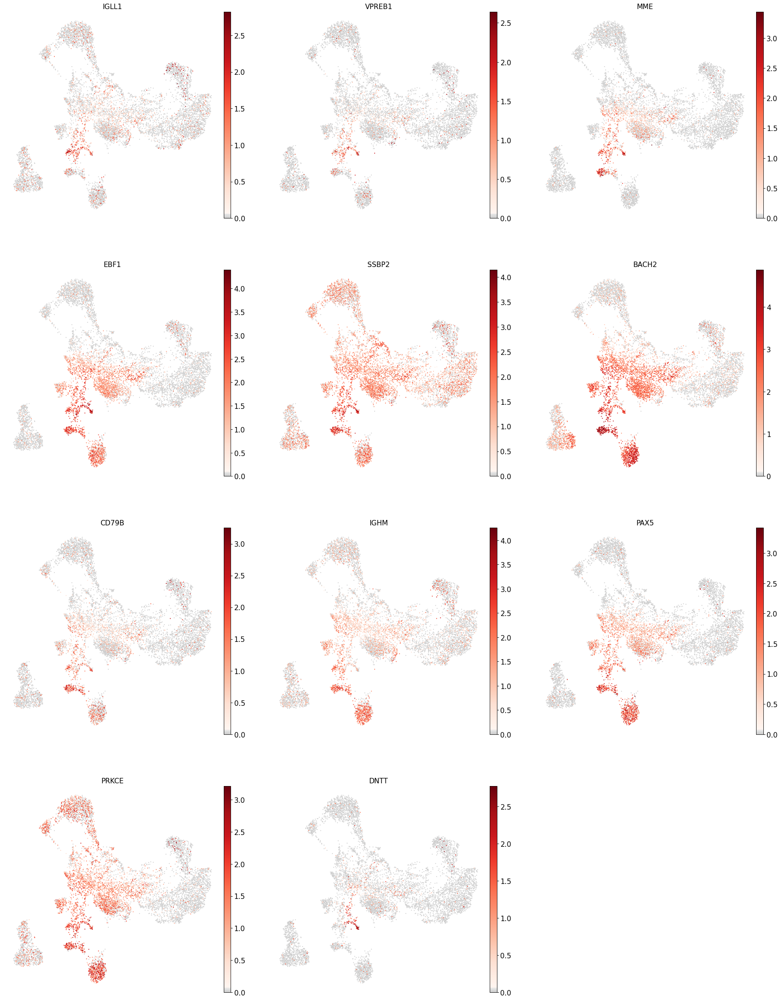

Cluster: Naive CD20+ B


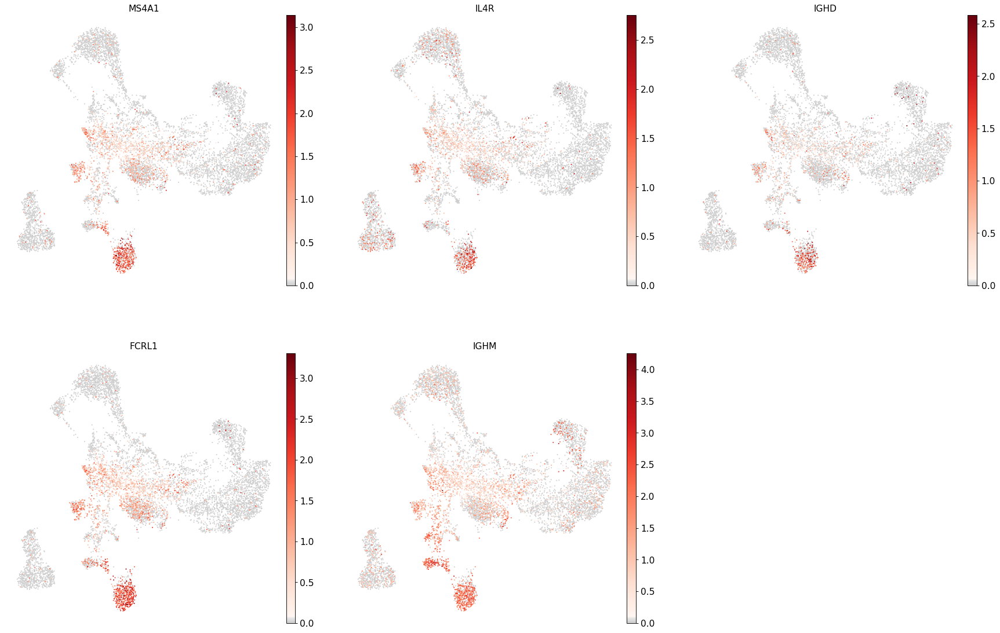

Cluster: B1 B


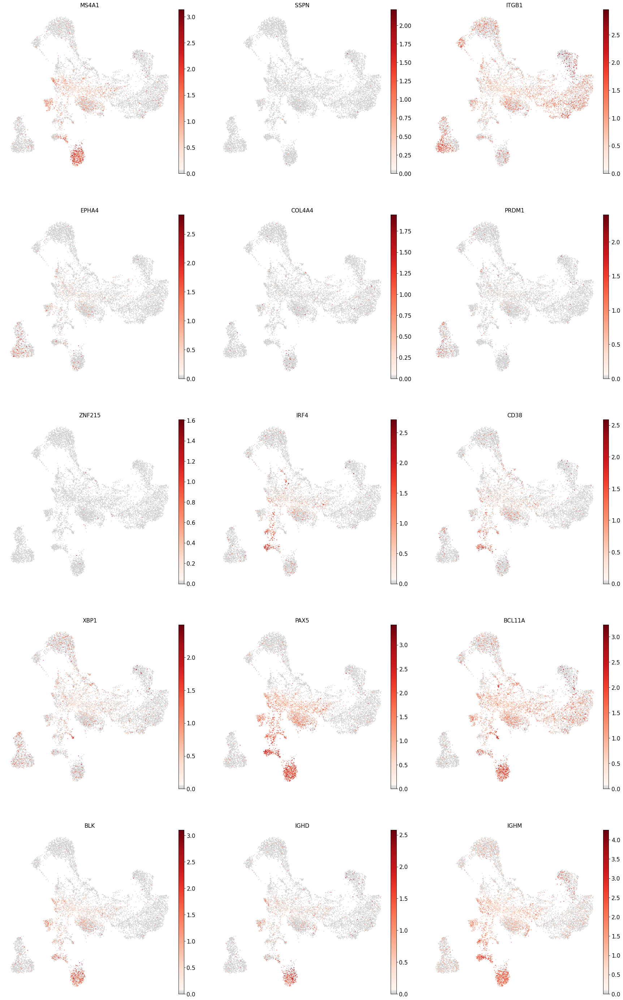

Cluster: Transitional B


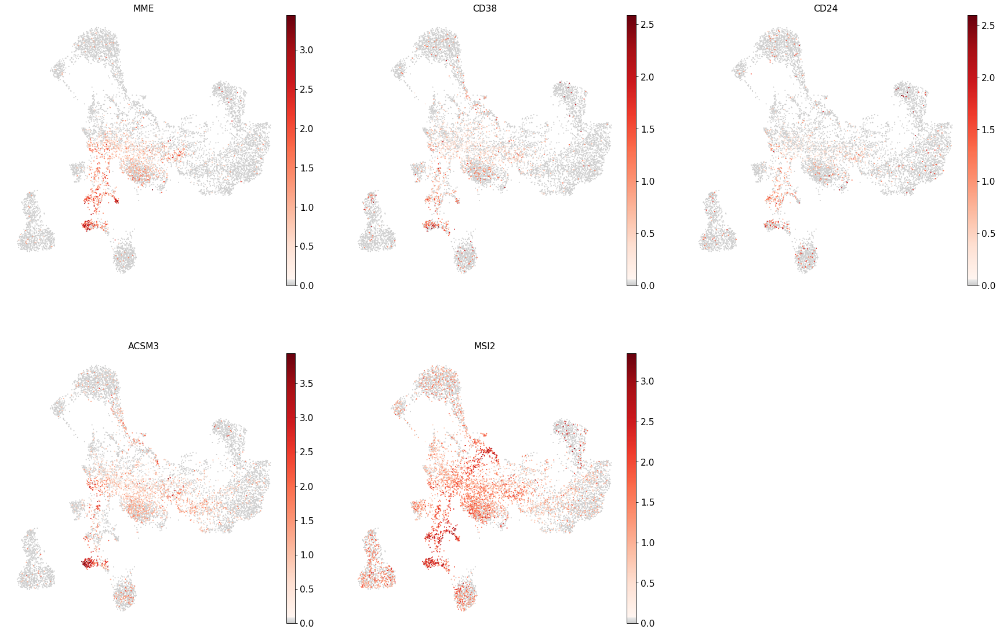

Cluster: Plasma cells


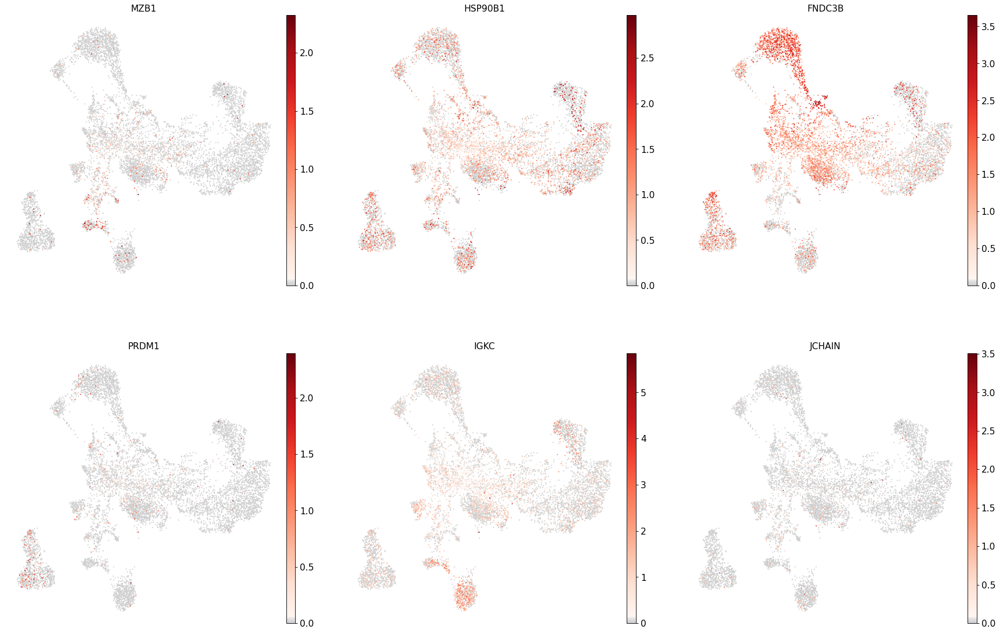

Cluster: Plasmablast


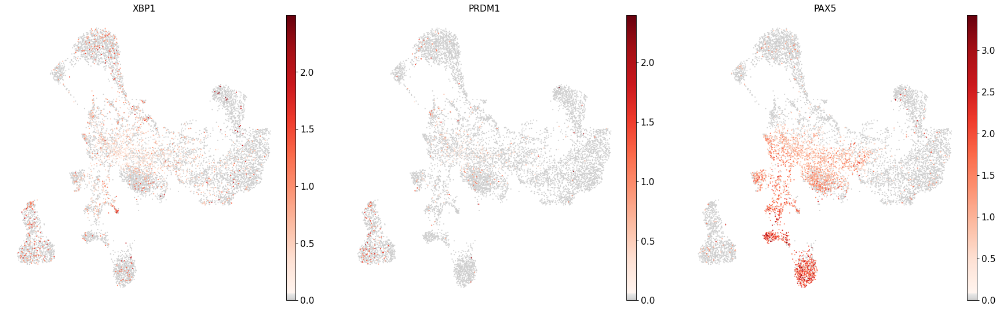

Cluster: CD4+ T activated


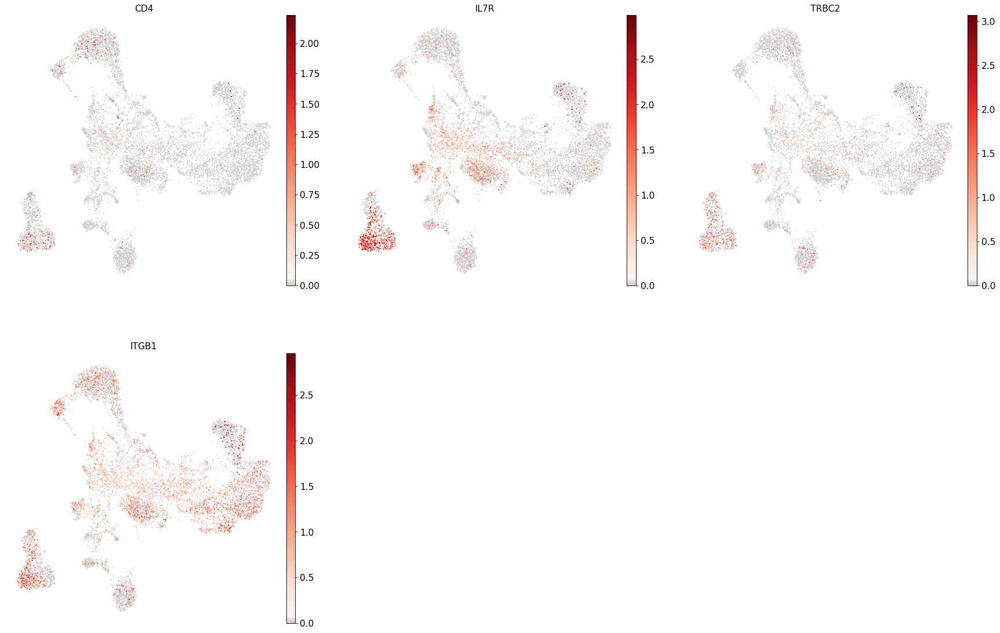

Cluster: CD4+ T naive


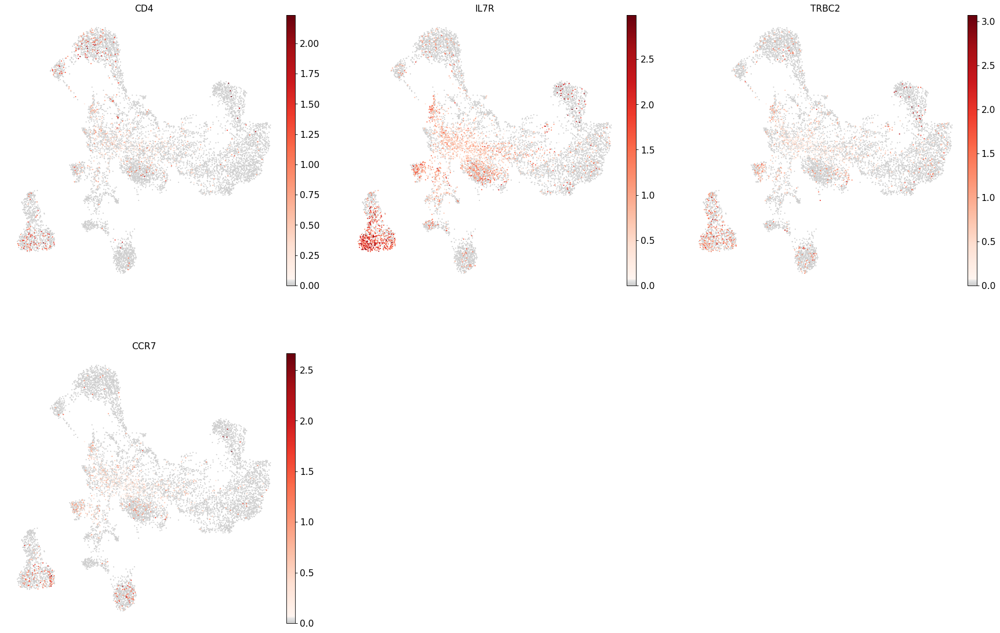

Cluster: CD8+ T


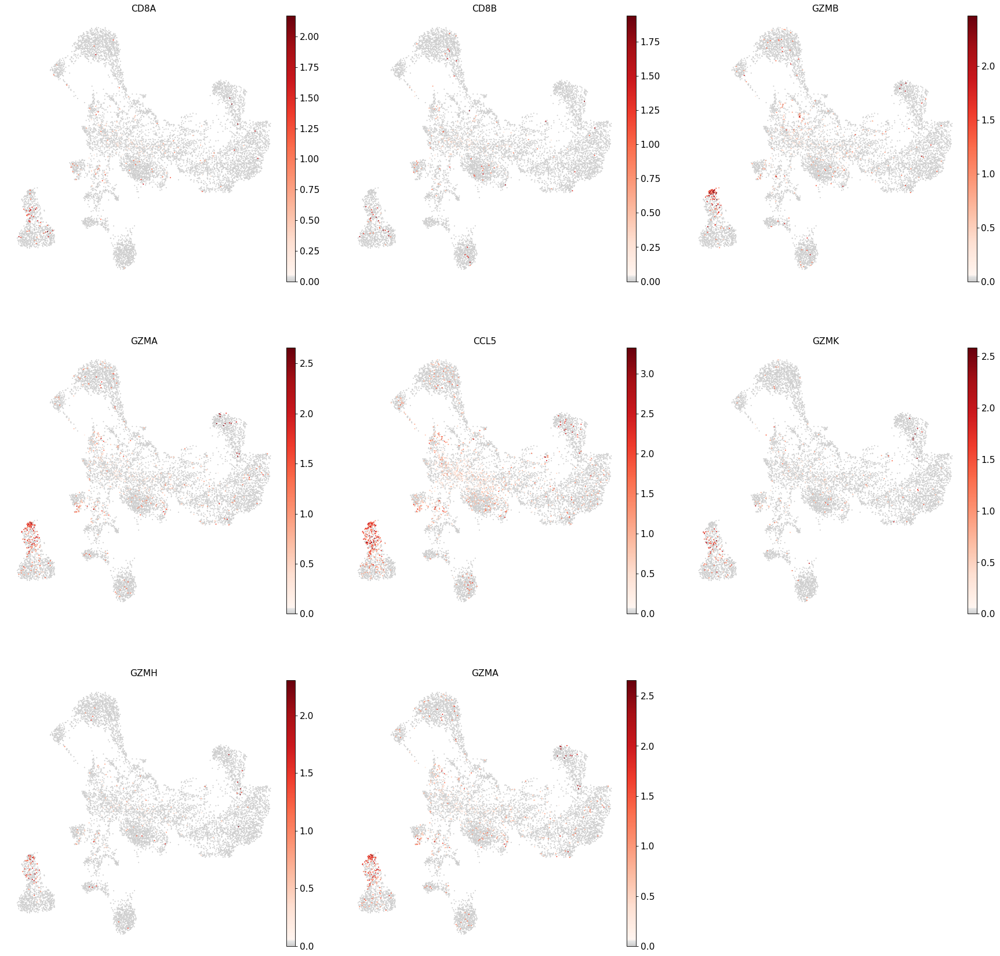

Cluster: T activation


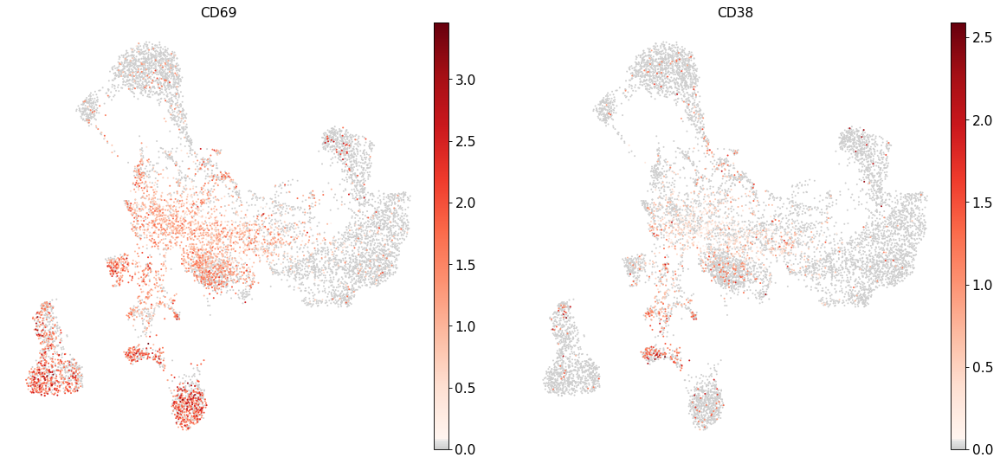

Cluster: T naive


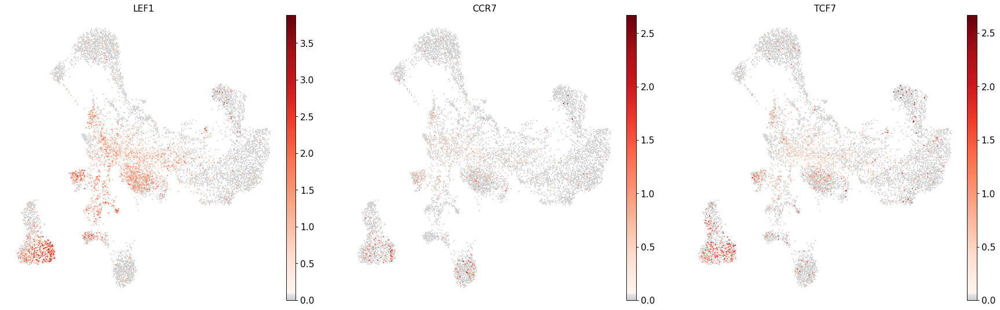

Cluster: pDCs


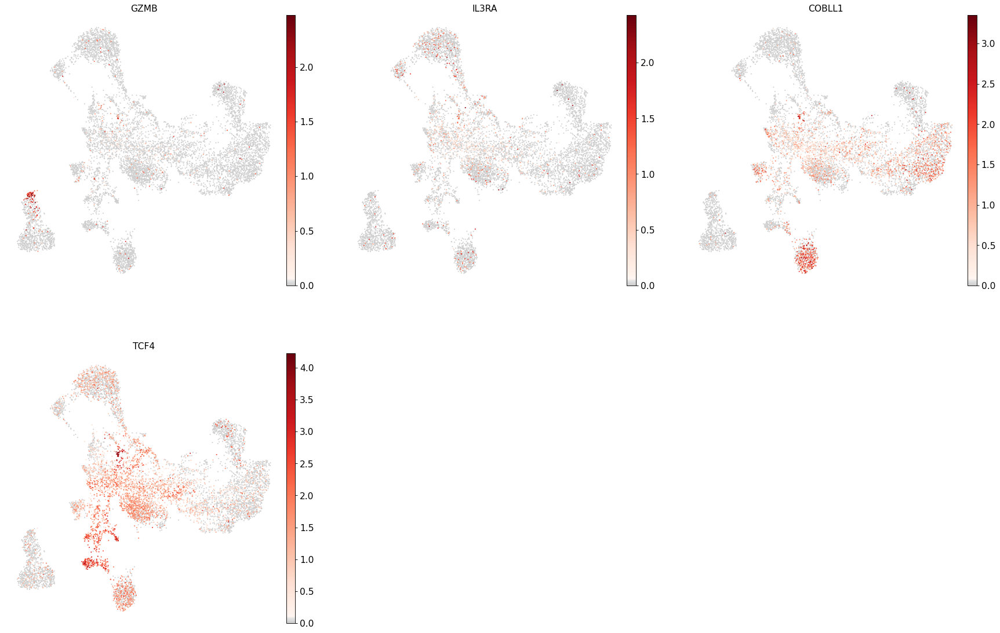

Cluster: G/M prog


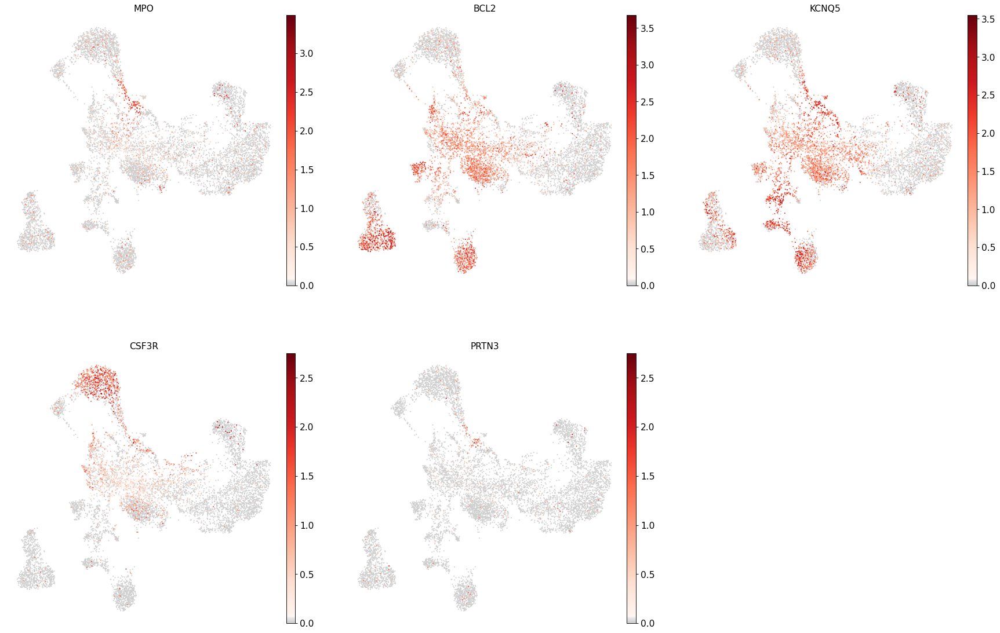

Cluster: HSC


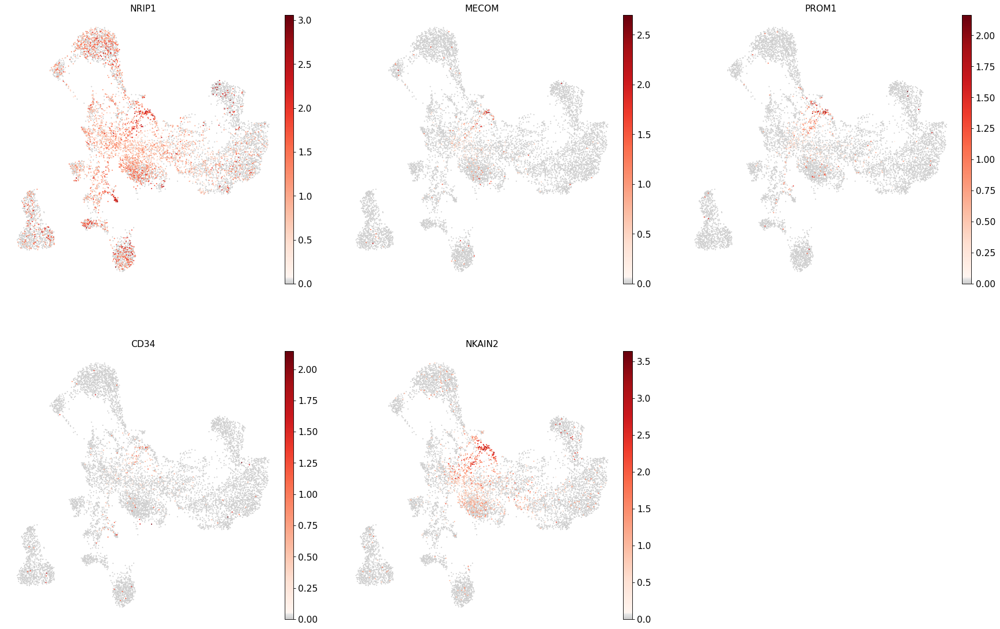

Cluster: MK/E prog


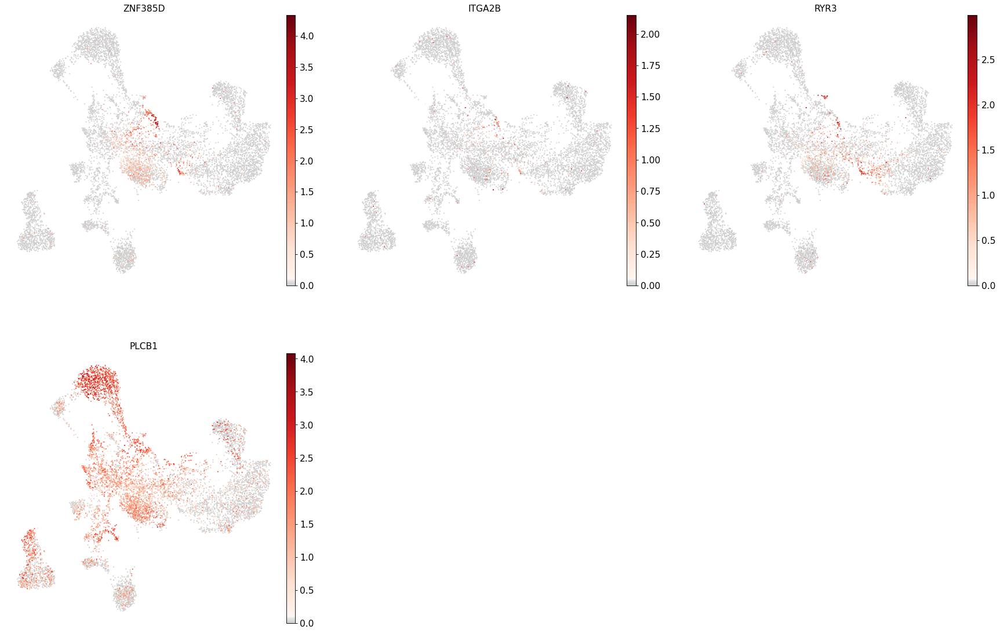

In [50]:
# Look at marker expression 
# Note that some markers are meant to be negative! (DMXL2, HBM, GYPA, IGHD, IGHM for some cell types)
#they are negative 
for i in marker_genes.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in marker_genes[i] if i in adata_gex.var_names]
    sc.pl.umap(adata_gex, color=genes_to_plot, ncols=3, use_raw=False, cmap=mymap)

Suggests from markers:
- 0: lymph prog./ Transitional B
- 1: Reticulocyte / Erythroblast / Proerythroblast
- 2: CD14+ Mono prog/ CD14+ Mono
- 3: top cells: CD8+ T / ILC / NK, bottom cells: CD4+ Naive T/CD4+ T activated
- 4: ~lymph prog./ Transitional B
- 5: Reticulocyte / Erythroblast
- 6: Reticulocyte / Erythroblast / Proerythroblast
- 7: Naive CD20 + B / B1 B
- 8: Lymph Prog
- 9: HSC, MK/E prog,HSPC mono prog,
- 10: Lymph Prog / Transitional B
- 11: CD16+ Mono/ cDC2

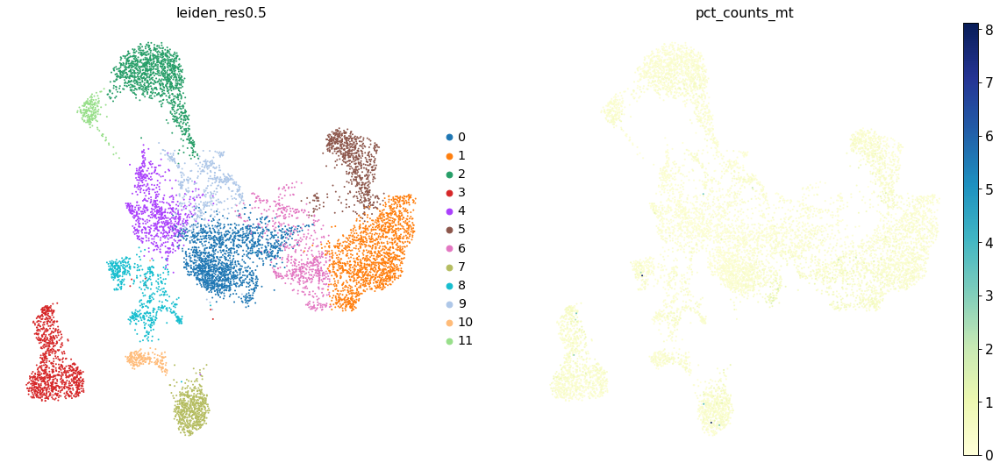

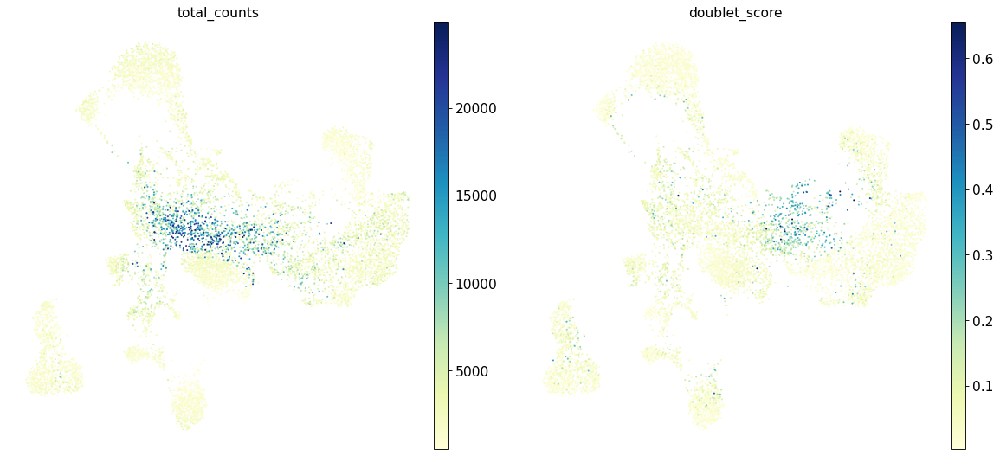

In [51]:
# Check some technical markers to assess potential doublet or low quality clusters
sc.pl.umap(adata_gex, color=['leiden_res0.5', 'pct_counts_mt'])
sc.pl.umap(adata_gex, color=['total_counts', 'doublet_score'])

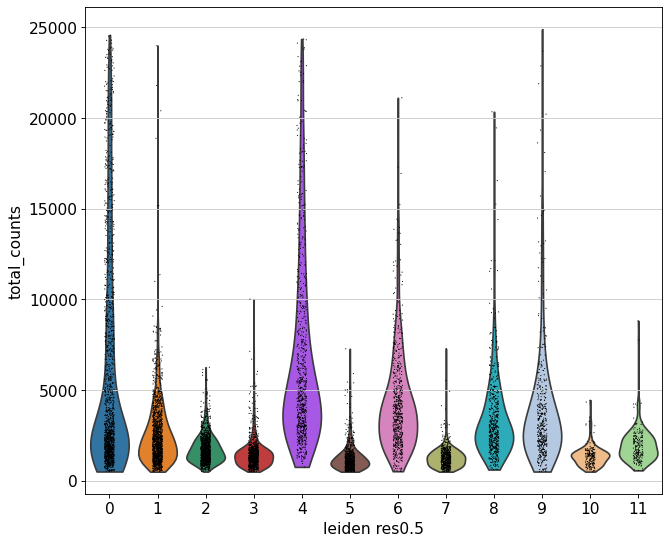

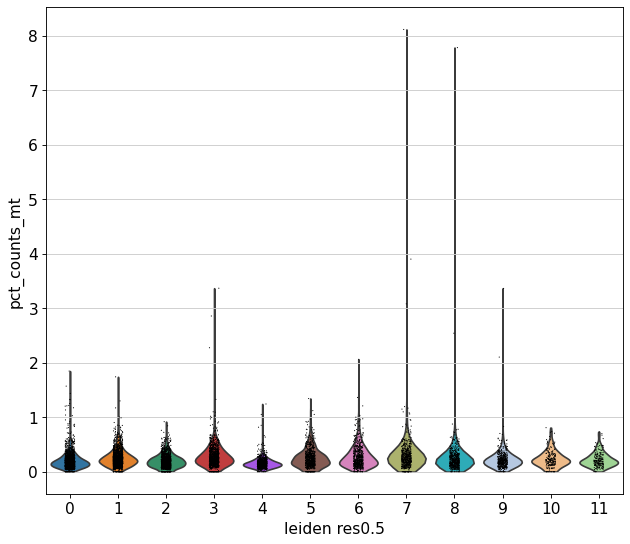

In [52]:
sc.pl.violin(adata_gex, keys='total_counts', groupby='leiden_res0.5')
sc.pl.violin(adata_gex, keys='pct_counts_mt', groupby='leiden_res0.5')

Note:
- part of 4 and 6 don't look great! -> large central blob with high counts!
- at least part of clusters 0 and 6 likely doublets

Clusters 0 and 6 can potentially contain doublets

Suggests from markers:
- 0: lymph prog./ Transitional B
- 1: Reticulocyte / Erythroblast / Proerythroblast
- 2: CD14+ Mono prog/ CD14+ Mono
- 3: top cells: CD8+ T / ILC / NK, bottom cells: CD4+ Naive T/CD4+ T activated
- 4: ~lymph prog./ Transitional B
- 5: Reticulocyte / Erythroblast
- 6: Reticulocyte / Erythroblast / Proerythroblast
- 7: Naive CD20 + B / B1 B
- 8: Lymph Prog
- 9: HSC, MK/E prog,HSPC mono prog,
- 10: Lymph Prog / Transitional B
- 11: CD16+ Mono/ cDC2

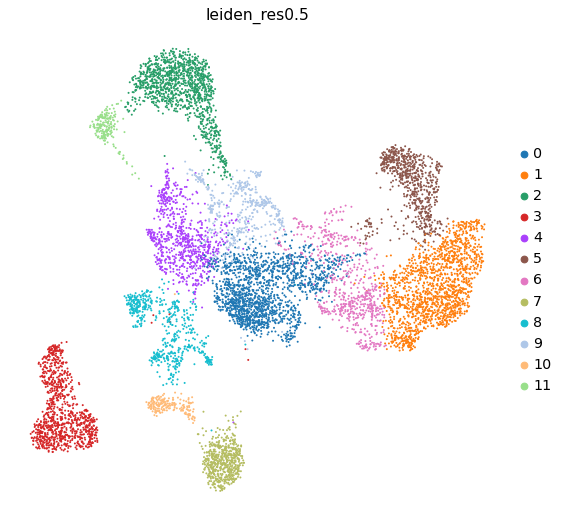

In [53]:
sc.pl.umap(adata_gex, color=['leiden_res0.5'])

# Subclustering

Note that you will likely need to adapt the `resolution` parameter to optimally represent the substructure you see in the data.

## Lymph Prog / Transitional B - clusters 0,4,8,10

### Cluster 0

In [54]:
orig_key = 'leiden_res0.5'
new_key = 'leiden_res0.5_lymph_TrasB'
new_rg_key = 'rg_res0.5_lymph_TrasB'
sub_key = '0'

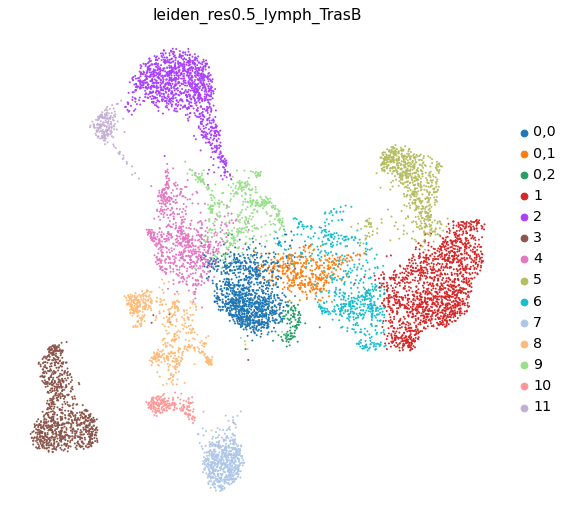

1      1517
2      1212
0,0    1122
3       980
4       750
5       695
6       610
7       585
8       543
9       445
0,1     393
10      197
11      196
0,2     105
Name: leiden_res0.5_lymph_TrasB, dtype: int64

In [55]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

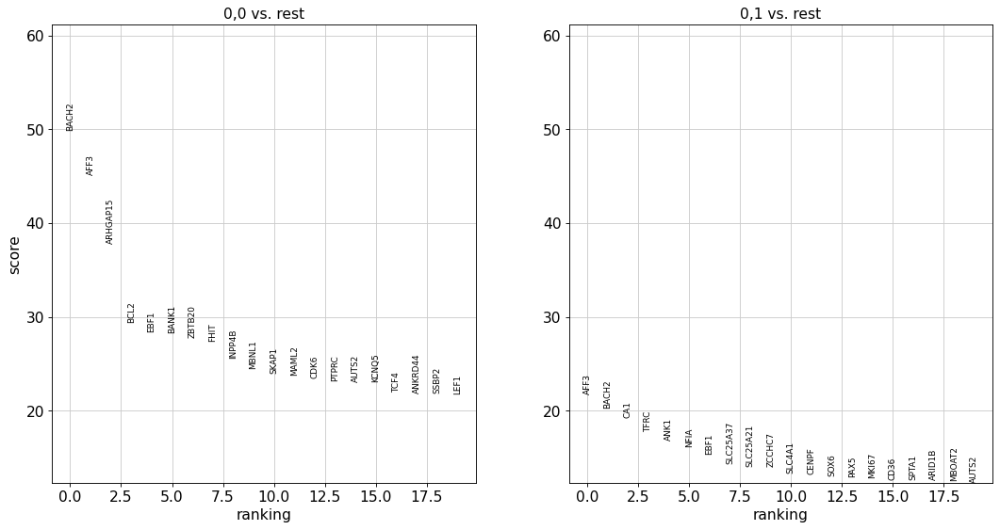

In [56]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

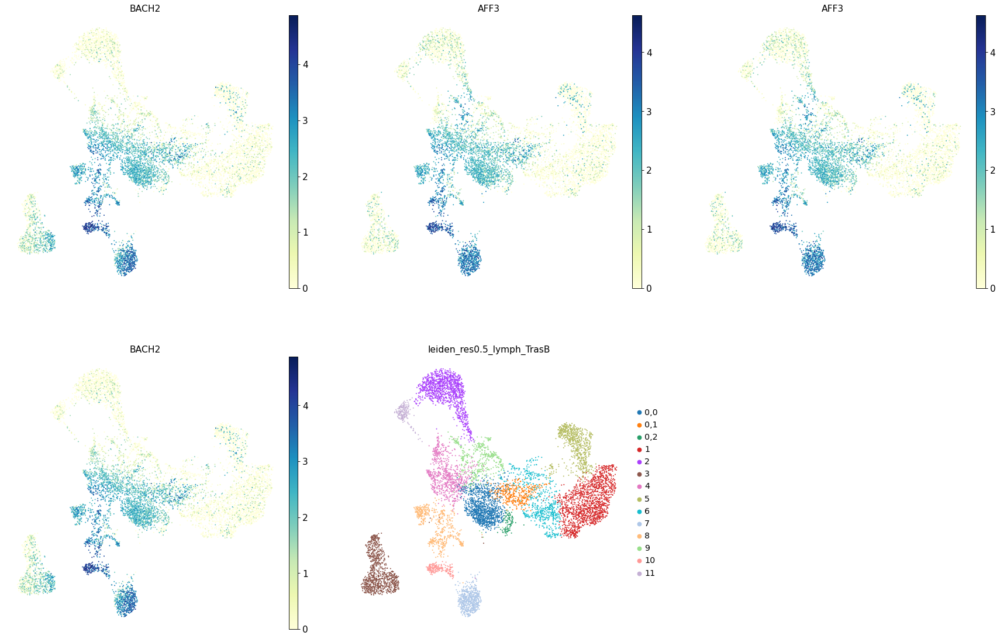

In [57]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

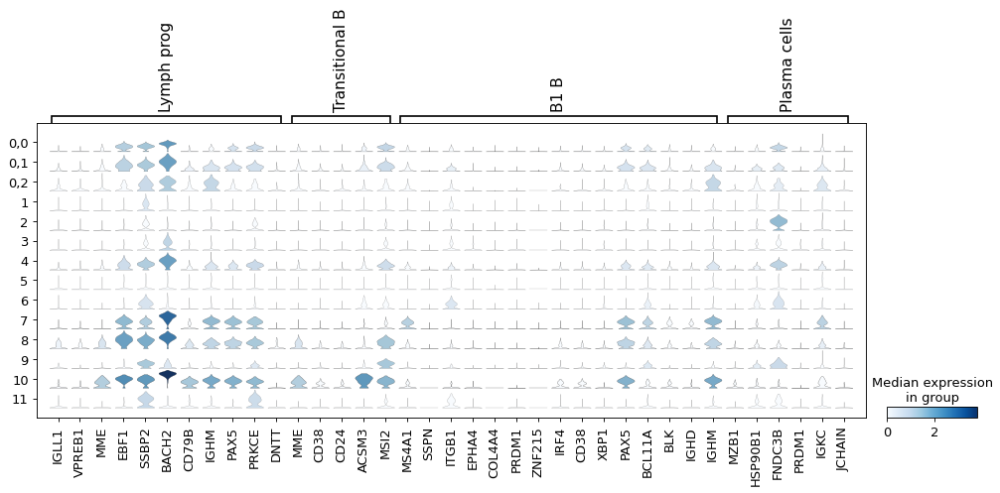

In [58]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog','Transitional B', 'B1 B','Plasma cells']}, groupby=new_key)

Looks like 0 is closer to Lymph prog but can also be all doublet


### Summary

not sure if they are doublet or part of it is Lymph prog

### Cluster 4

In [59]:
orig_key = 'leiden_res0.5_lymph_TrasB'
new_key = 'leiden_res0.5_lymph_TrasB_4'
new_rg_key = 'rg_res0.5_lymph_TrasB_4'
sub_key = '4'

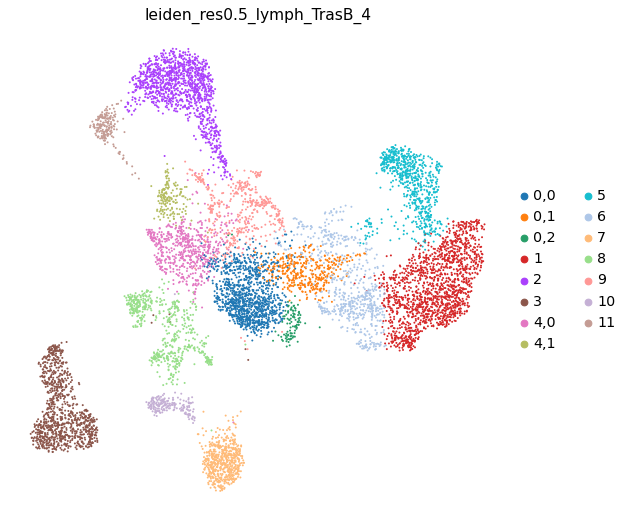

1      1517
2      1212
0,0    1122
3       980
5       695
6       610
4,0     589
7       585
8       543
9       445
0,1     393
10      197
11      196
4,1     161
0,2     105
Name: leiden_res0.5_lymph_TrasB_4, dtype: int64

In [60]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

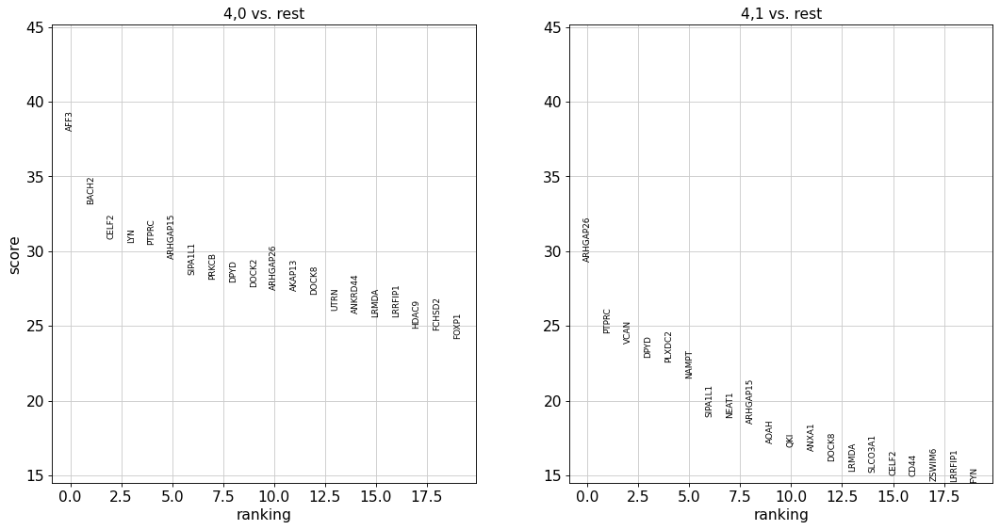

In [61]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

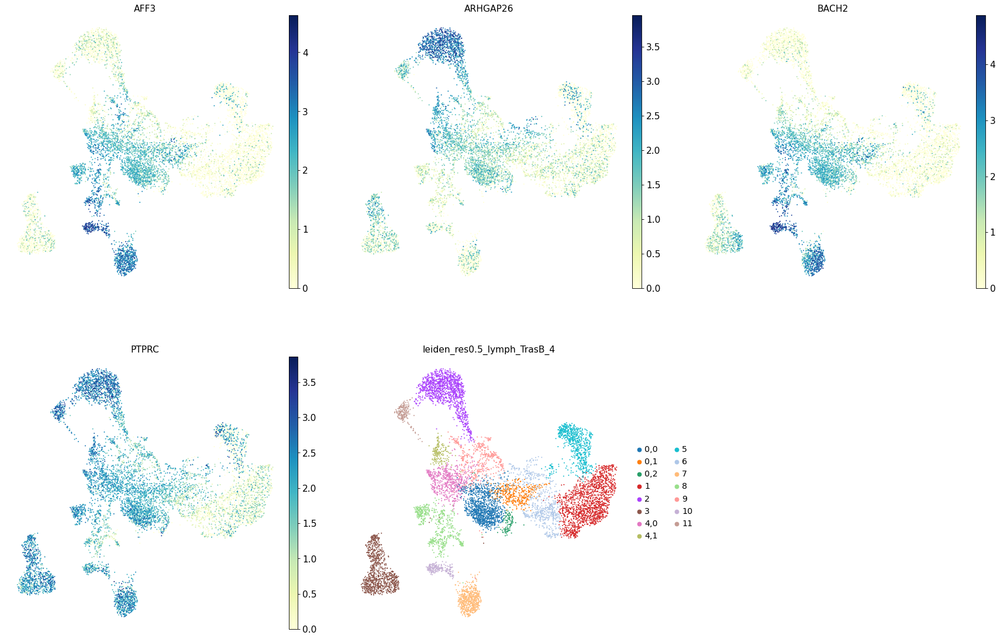

In [62]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

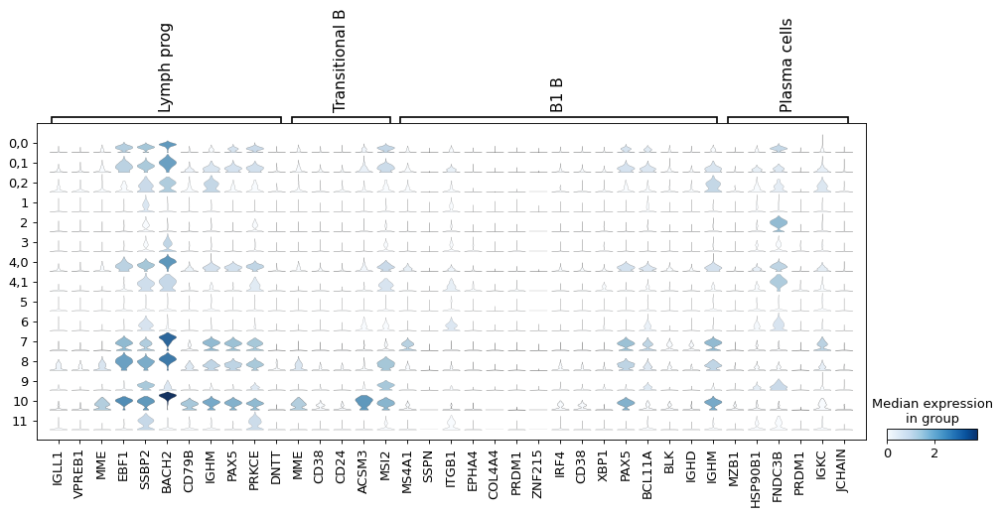

In [63]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog','Transitional B', 'B1 B','Plasma cells']}, groupby=new_key)

Looks like 4,0 is closer to Lymph prog
4,1 is also closer to Lymph prog but can be another cell type


### Summary

- 4,0 is all Lymph prog or doublet
- 4,1 can be Lymph prog or doublets

### Cluster 8

In [64]:
orig_key = 'leiden_res0.5_lymph_TrasB_4'
new_key = 'leiden_res0.5_lymph_TrasB_8'
new_rg_key = 'rg_res0.5_lymph_TrasB_8'
sub_key = '8'

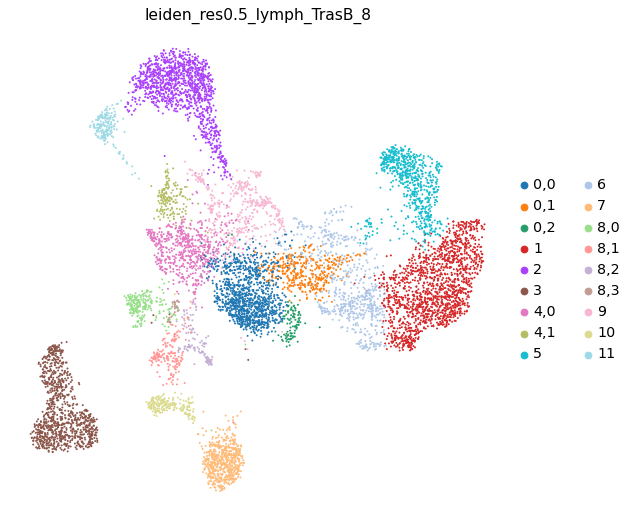

1      1517
2      1212
0,0    1122
3       980
5       695
6       610
4,0     589
7       585
9       445
0,1     393
8,0     221
10      197
11      196
8,1     181
4,1     161
8,2     111
0,2     105
8,3      30
Name: leiden_res0.5_lymph_TrasB_8, dtype: int64

In [65]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

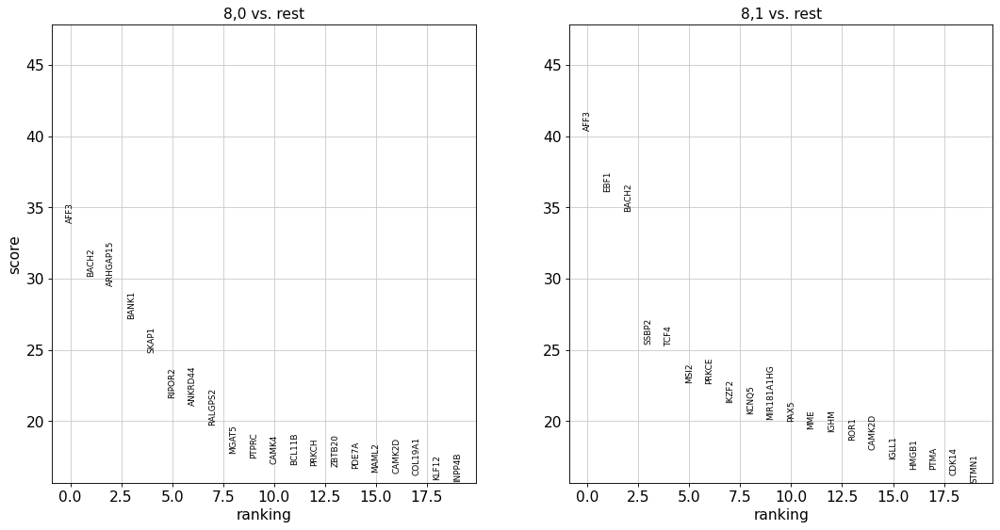

In [66]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

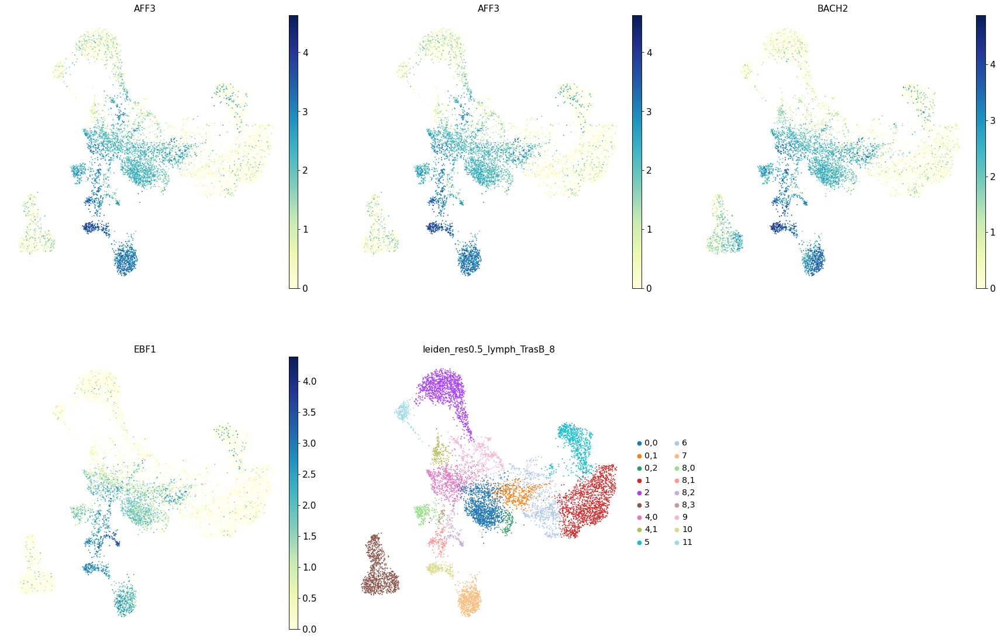

In [67]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

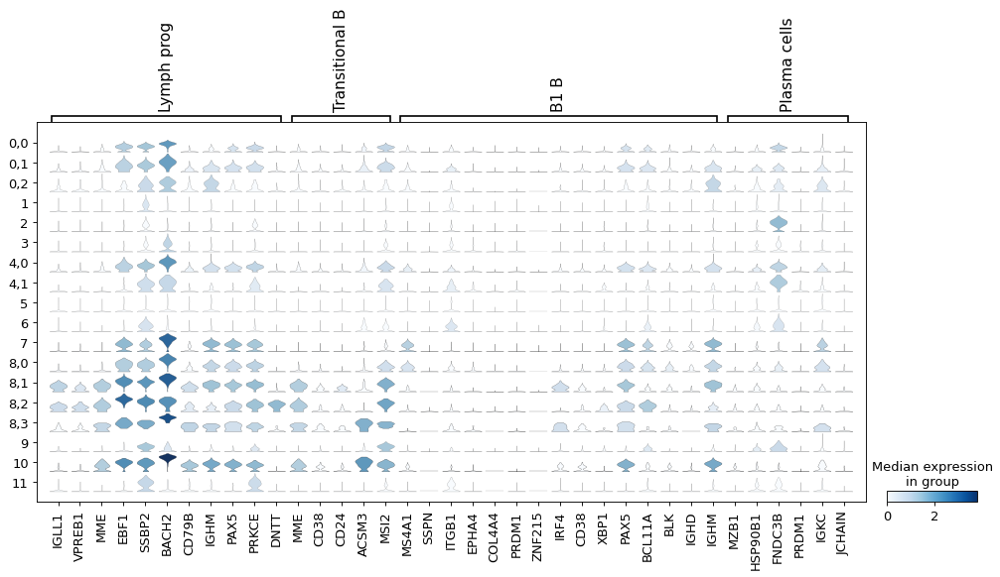

In [68]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog','Transitional B', 'B1 B','Plasma cells']}, groupby=new_key)

### Summary

- 8,0 are likely to be Lymph prog
- 8,1 is all Lymph prog
- 8,2 is all Lymph prog
- 8,3 is all Lymph prog

### Cluster 10

In [69]:
orig_key = 'leiden_res0.5_lymph_TrasB_8'
new_key = 'leiden_res0.5_lymph_TrasB_10'
new_rg_key = 'rg_res0.5_lymph_TrasB_10'
sub_key = '10'

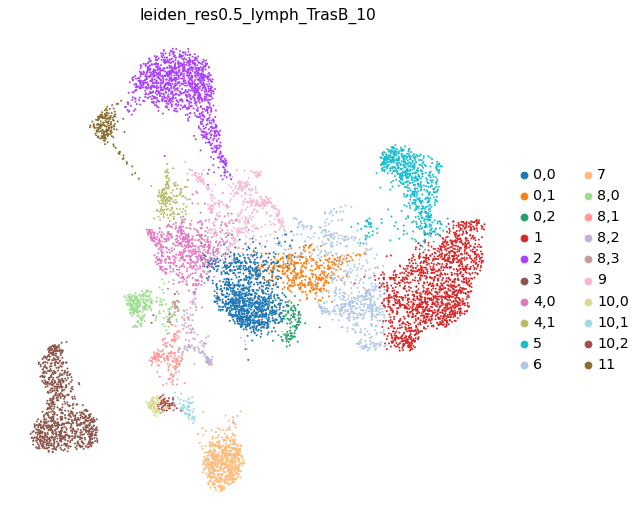

1       1517
2       1212
0,0     1122
3        980
5        695
6        610
4,0      589
7        585
9        445
0,1      393
8,0      221
11       196
8,1      181
4,1      161
8,2      111
0,2      105
10,0      77
10,1      63
10,2      57
8,3       30
Name: leiden_res0.5_lymph_TrasB_10, dtype: int64

In [70]:
res = 0.5
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

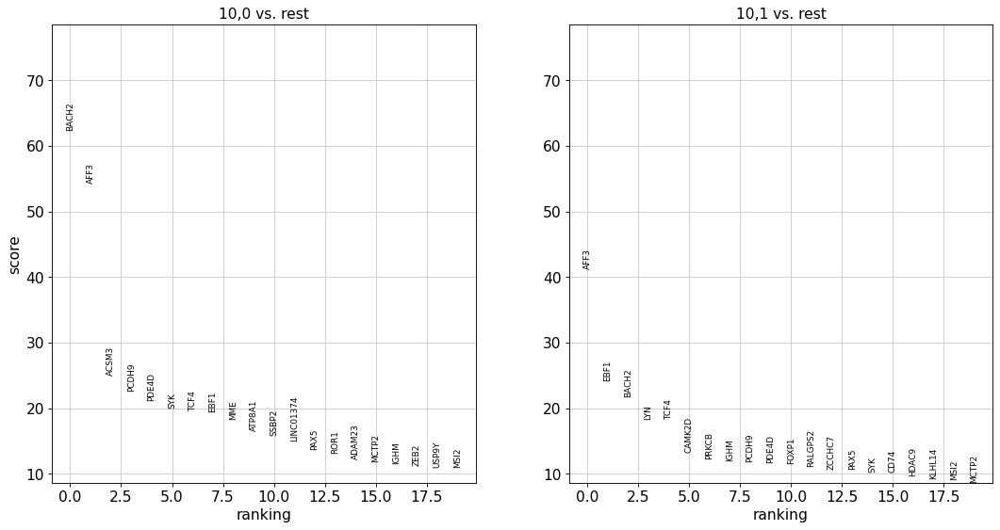

In [71]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

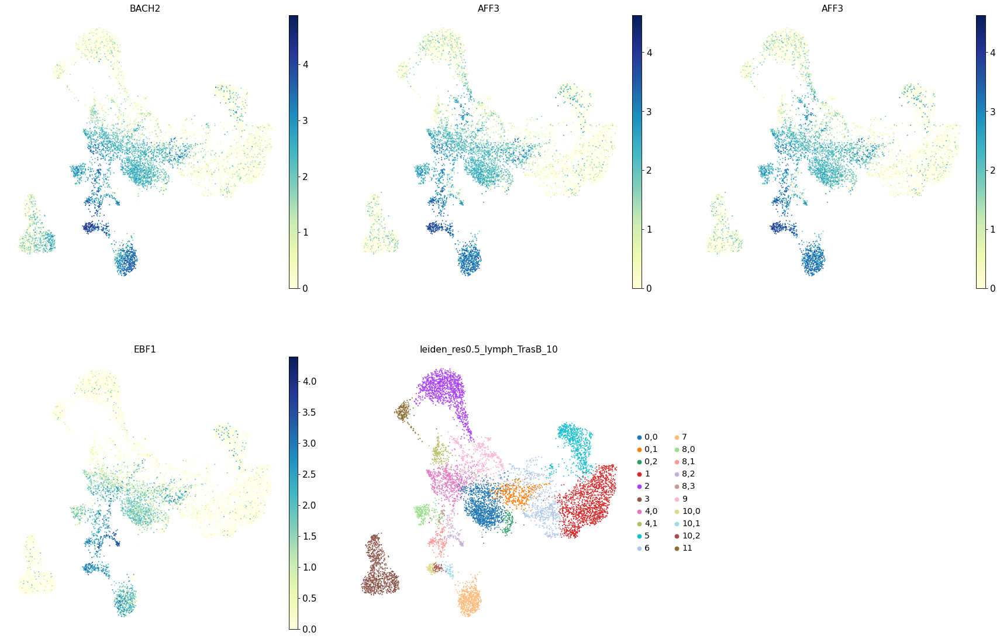

In [72]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

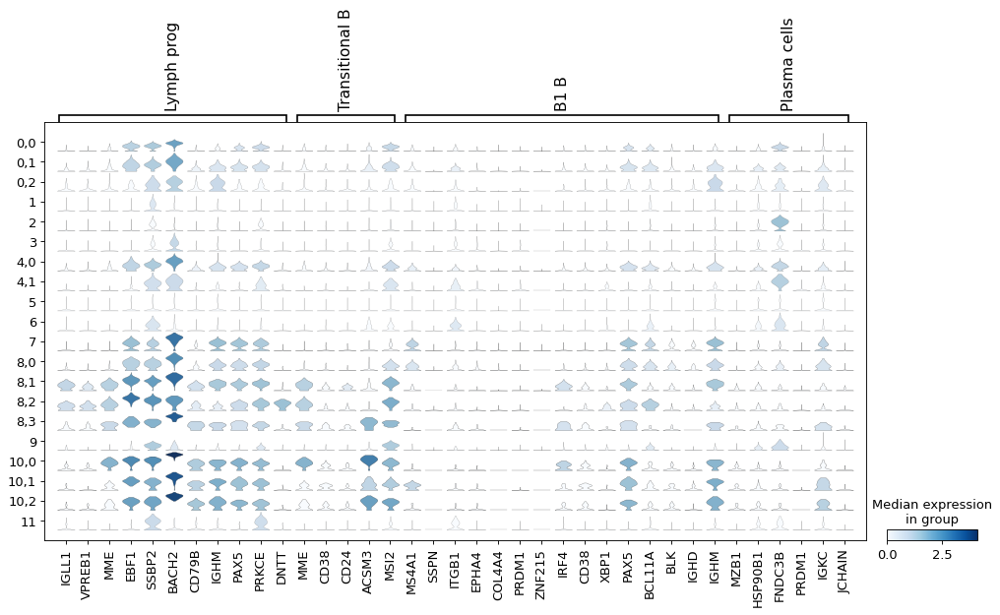

In [73]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Lymph prog','Transitional B', 'B1 B','Plasma cells']}, groupby=new_key)

### Summary

## Reticuloocytes/Erythroblast/Proerythroblast - clusters 1, 5 and 6

### Cluster 1

In [74]:
orig_key = 'leiden_res0.5_lymph_TrasB_10'
new_key = 'leiden_res0.5_blast_1'
new_rg_key = 'rg_res0.5_blast_1'
sub_key = '1'

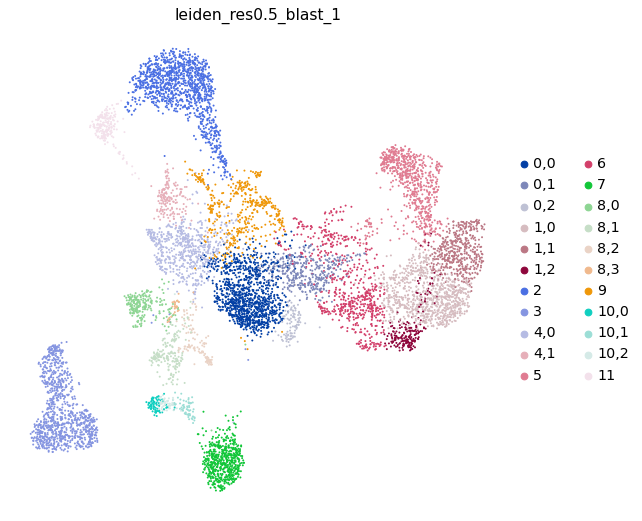

2       1212
0,0     1122
3        980
1,0      852
5        695
6        610
4,0      589
7        585
1,1      449
9        445
0,1      393
8,0      221
1,2      216
11       196
8,1      181
4,1      161
8,2      111
0,2      105
10,0      77
10,1      63
10,2      57
8,3       30
Name: leiden_res0.5_blast_1, dtype: int64

In [75]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

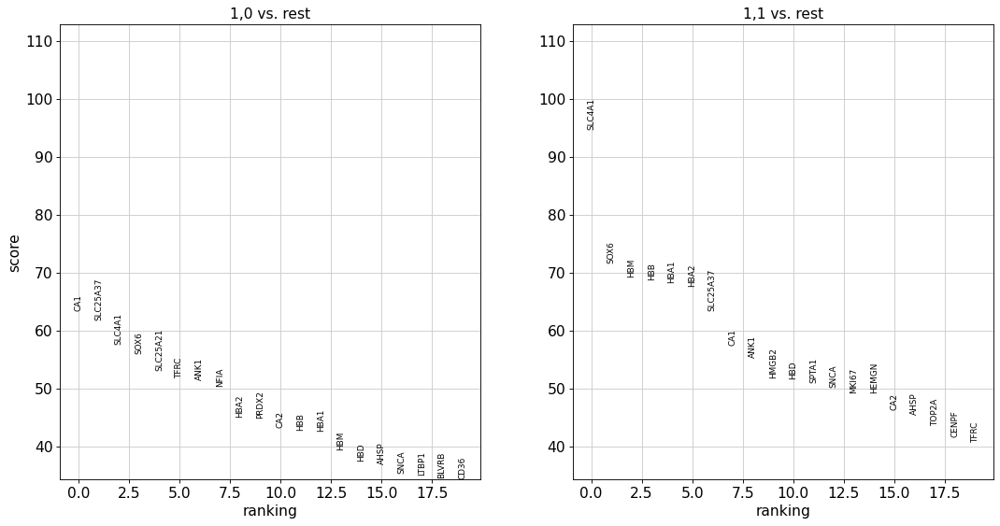

In [76]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

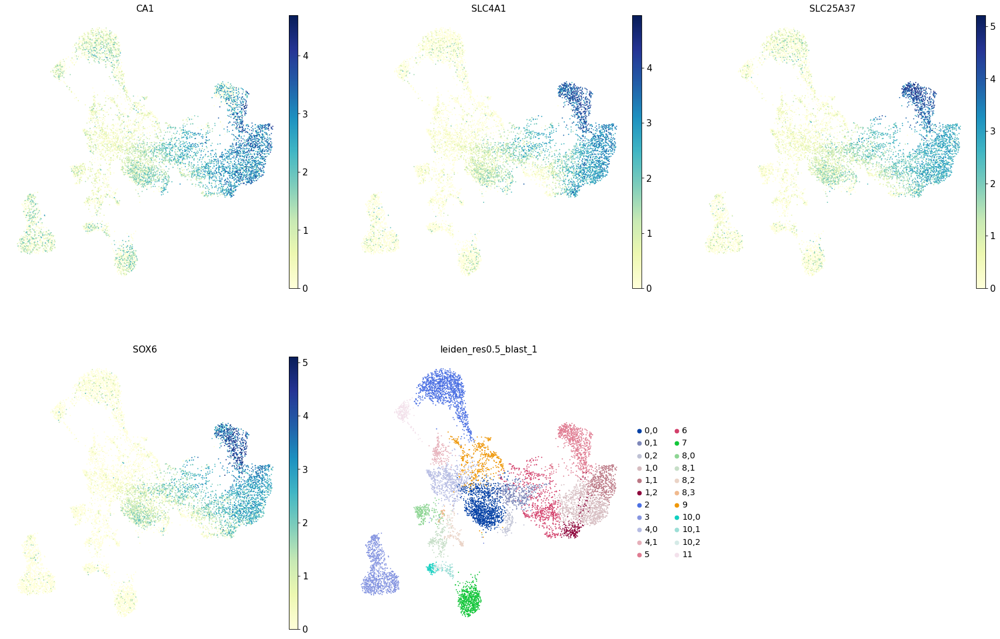

In [77]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

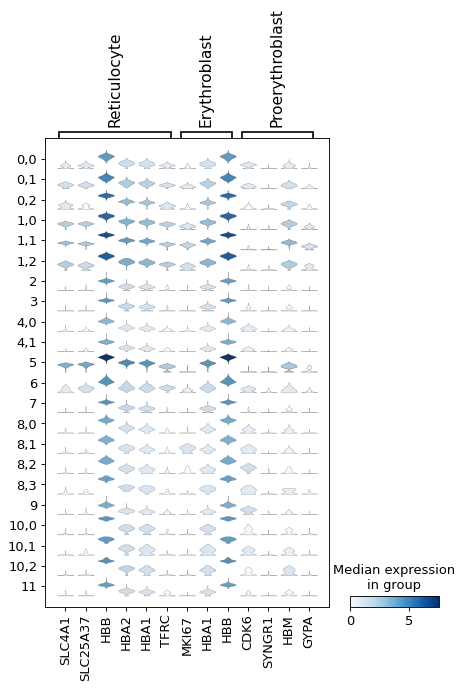

In [82]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Reticulocyte','Erythroblast', 'Proerythroblast']}, groupby=new_key)

Looks like 1 is closer to Erythroblast


### Summary

- 1 can potentially be all Erythroblast

### Cluster 5

In [83]:
orig_key = 'leiden_res0.5_blast_1'
new_key = 'leiden_res0.5_blast_5'
new_rg_key = 'rg_res0.5_blast_5'
sub_key = '5'

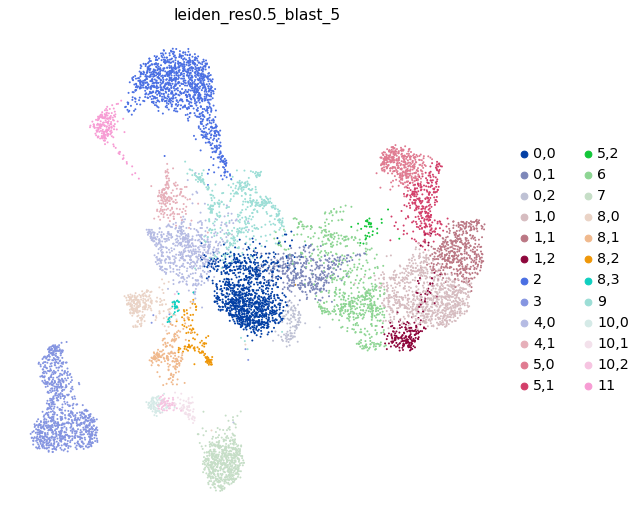

2       1212
0,0     1122
3        980
1,0      852
6        610
4,0      589
7        585
1,1      449
9        445
0,1      393
5,0      360
5,1      302
8,0      221
1,2      216
11       196
8,1      181
4,1      161
8,2      111
0,2      105
10,0      77
10,1      63
10,2      57
5,2       33
8,3       30
Name: leiden_res0.5_blast_5, dtype: int64

In [84]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

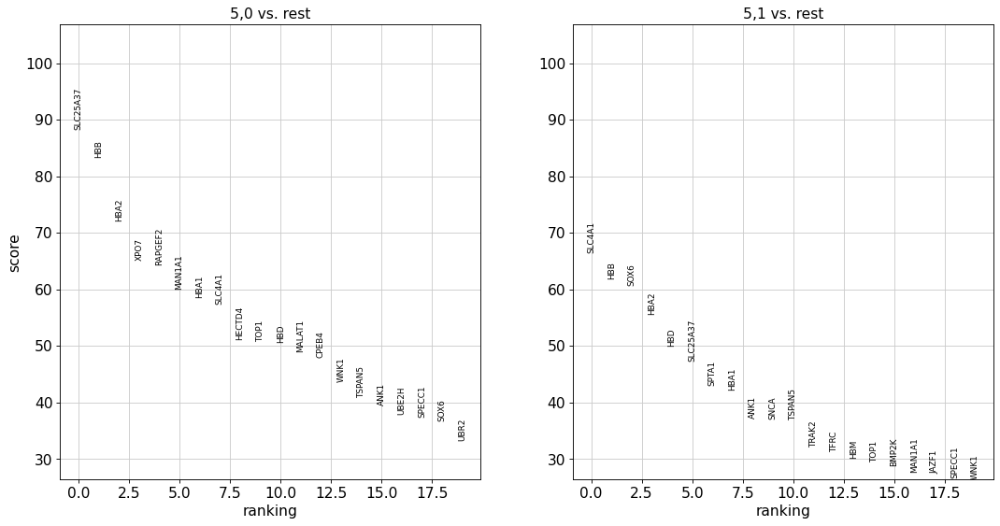

In [85]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

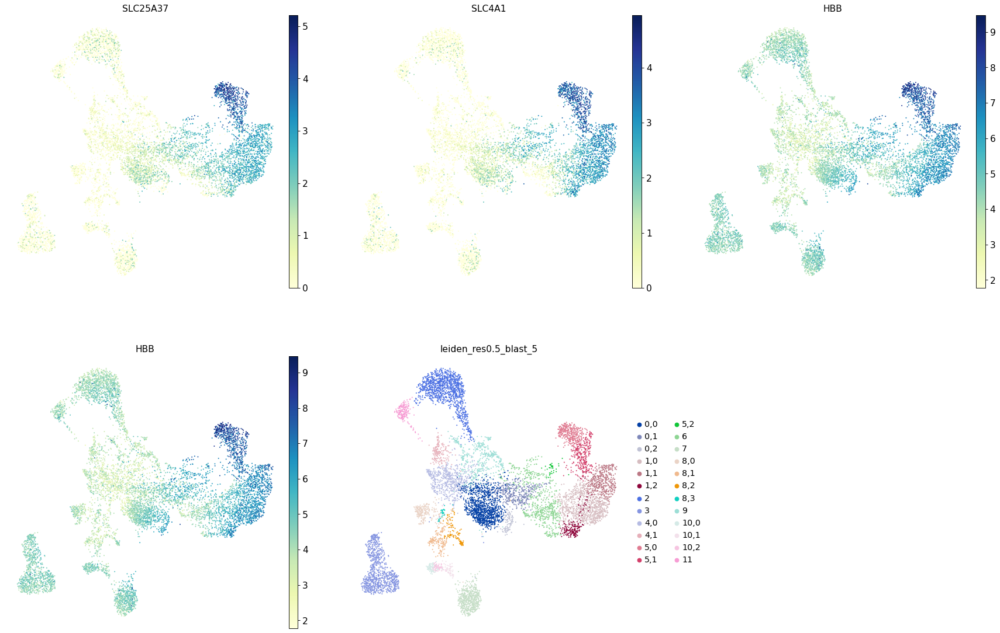

In [86]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

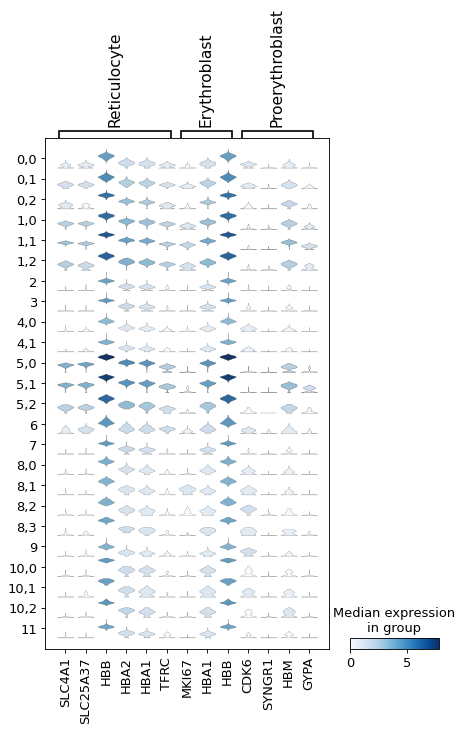

In [87]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Reticulocyte','Erythroblast', 'Proerythroblast']}, groupby=new_key)

Looks like 5,0 and 5,1 are closer to Reticulocyte
5,2 can be doublets


### Summary

- 5,0 and 5,1 are Reticulocyte
- 5,2 is probabely doublet

### Cluster 6

In [88]:
orig_key = 'leiden_res0.5_blast_5'
new_key = 'leiden_res0.5_blast_6'
new_rg_key = 'rg_res0.5_blast_6'
sub_key = '6'

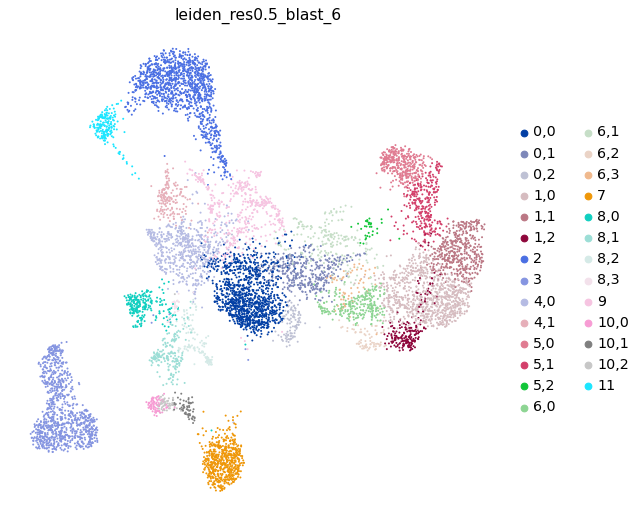

2       1212
0,0     1122
3        980
1,0      852
4,0      589
7        585
1,1      449
9        445
0,1      393
5,0      360
5,1      302
6,0      258
8,0      221
6,1      216
1,2      216
11       196
8,1      181
4,1      161
8,2      111
0,2      105
10,0      77
6,2       74
10,1      63
6,3       62
10,2      57
5,2       33
8,3       30
Name: leiden_res0.5_blast_6, dtype: int64

In [89]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

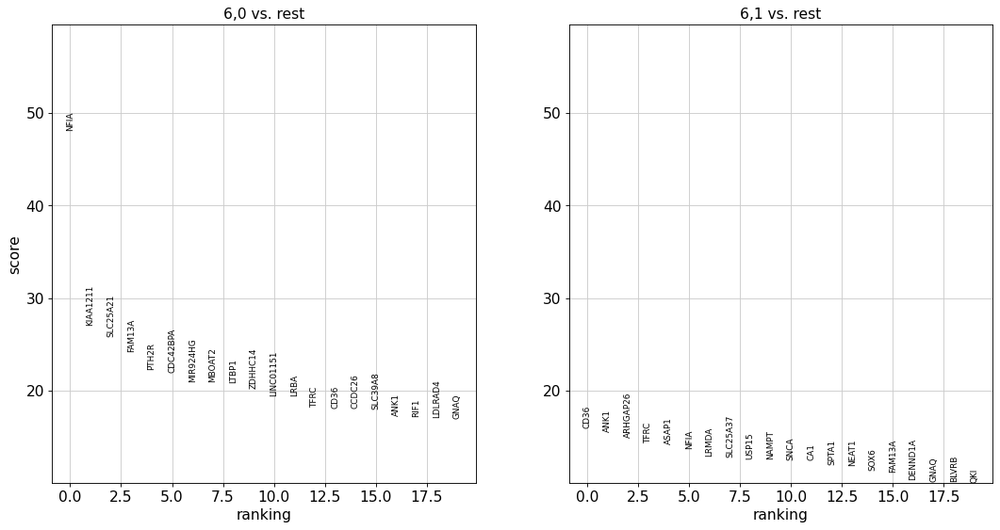

In [90]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

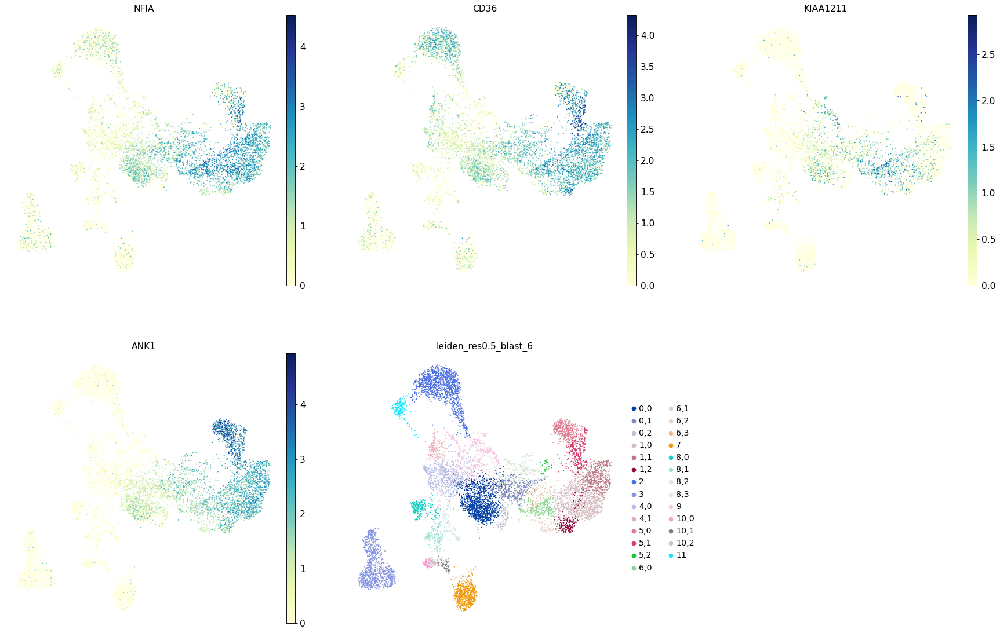

In [91]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

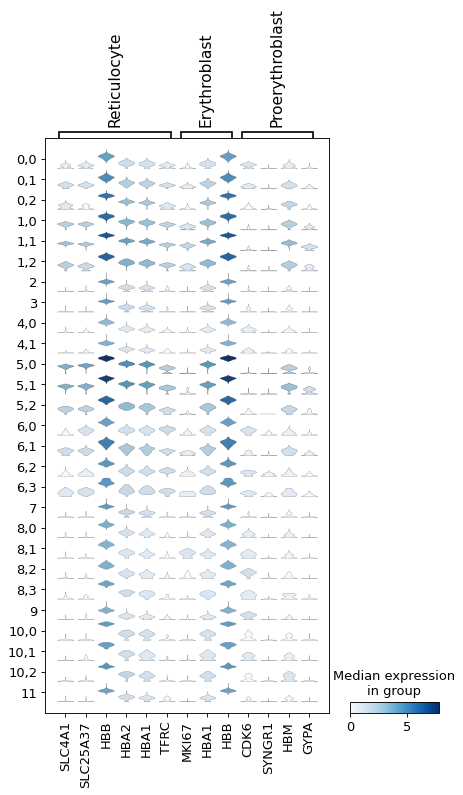

In [92]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Reticulocyte','Erythroblast', 'Proerythroblast']}, groupby=new_key)

Looks like 6,1 and 6,3 are doublet and the rest are Proerythroblast


### Summary

- 6,0 and 6,2: Proerythroblast
- 6,1 and 6,3: potentially doublet

## CD14+ cluster - Cluster 2

### Cluster 2

In [113]:
orig_key = 'leiden_res0.5_blast_6'
new_key = 'leiden_res0.5_CD14'
new_rg_key = 'rg_res0.5_CD14'
sub_key = '2'

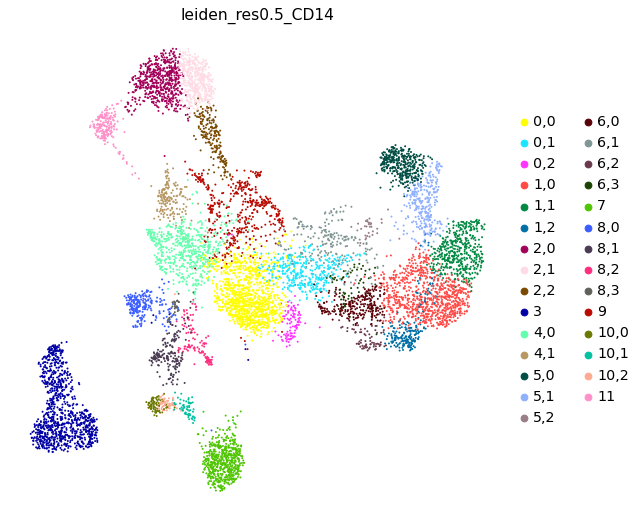

0,0     1122
3        980
1,0      852
4,0      589
7        585
2,0      581
1,1      449
9        445
2,1      429
0,1      393
5,0      360
5,1      302
6,0      258
8,0      221
6,1      216
1,2      216
2,2      202
11       196
8,1      181
4,1      161
8,2      111
0,2      105
10,0      77
6,2       74
10,1      63
6,3       62
10,2      57
5,2       33
8,3       30
Name: leiden_res0.5_CD14, dtype: int64

In [114]:
res = 0.3
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

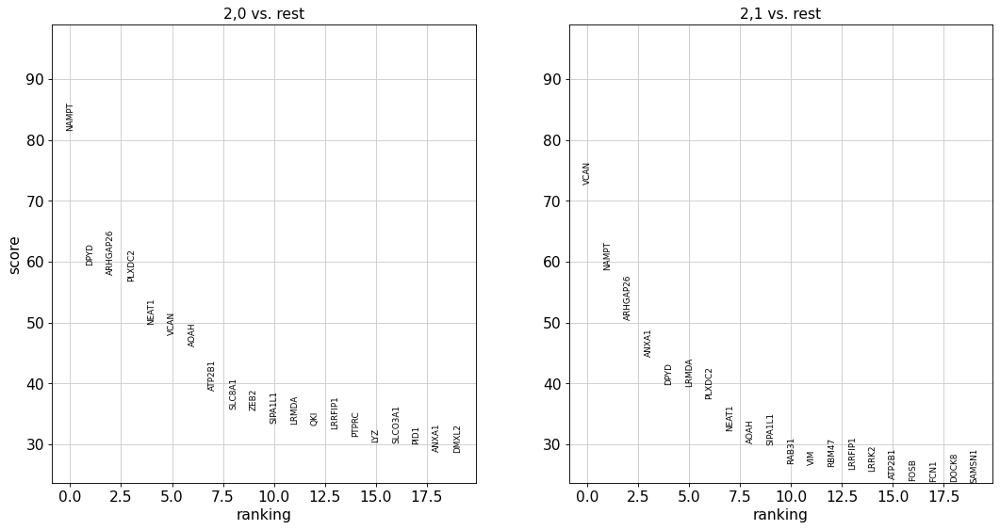

In [115]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

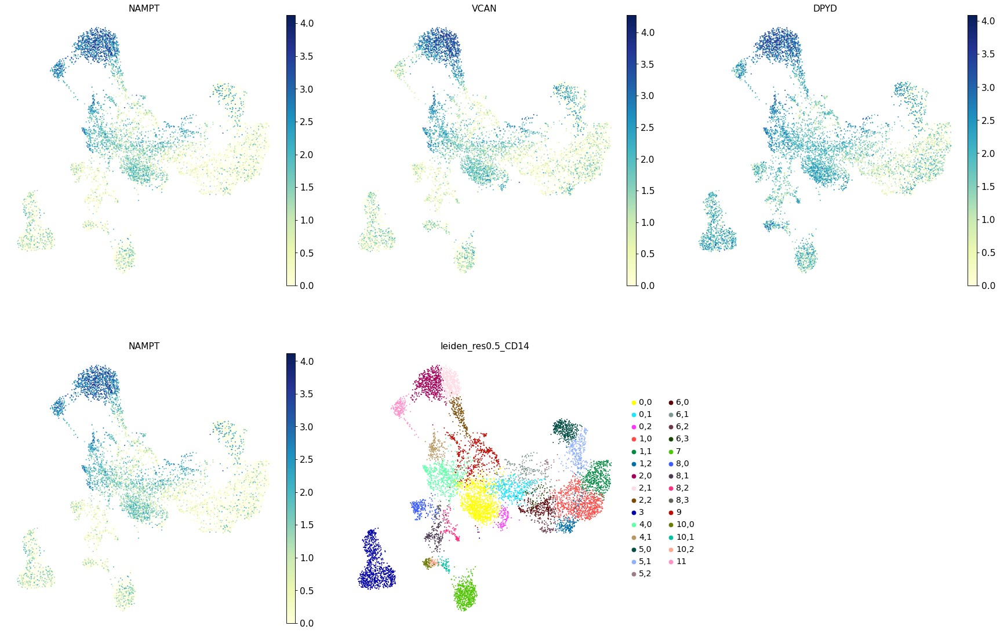

In [116]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

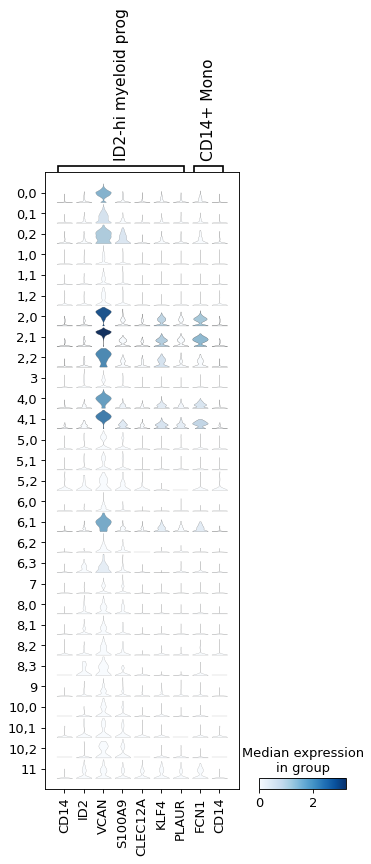

In [117]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['ID2-hi myeloid prog', 'CD14+ Mono']}, groupby=new_key)

Looks like 2,0 and 2,1 are closer to CD14+ Mono and 2,2 is CD14+ Mon prog


### Summary

- 2,0 and 2,1 are CD14+ Mono
- 2,2 is CD14+ Mon prog

## T cells - Cluster 3

### Cluster 3

In [118]:
orig_key = 'leiden_res0.5_CD14'
new_key = 'leiden_res0.5_T'
new_rg_key = 'rg_res0.5_T'
sub_key = '3'

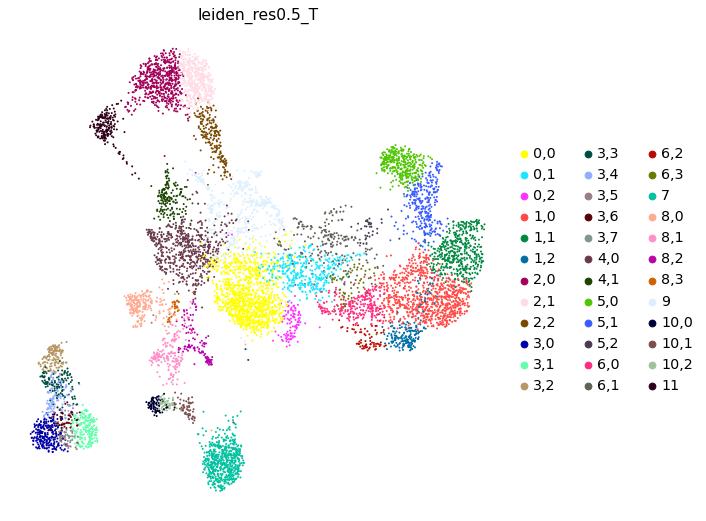

0,0     1122
1,0      852
4,0      589
7        585
2,0      581
1,1      449
9        445
2,1      429
0,1      393
5,0      360
5,1      302
6,0      258
3,0      244
8,0      221
1,2      216
6,1      216
3,1      215
2,2      202
11       196
8,1      181
4,1      161
3,2      139
3,3      120
3,4      117
8,2      111
0,2      105
10,0      77
6,2       74
10,1      63
6,3       62
3,5       59
10,2      57
3,6       56
5,2       33
8,3       30
3,7       30
Name: leiden_res0.5_T, dtype: int64

In [119]:
res = 1.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

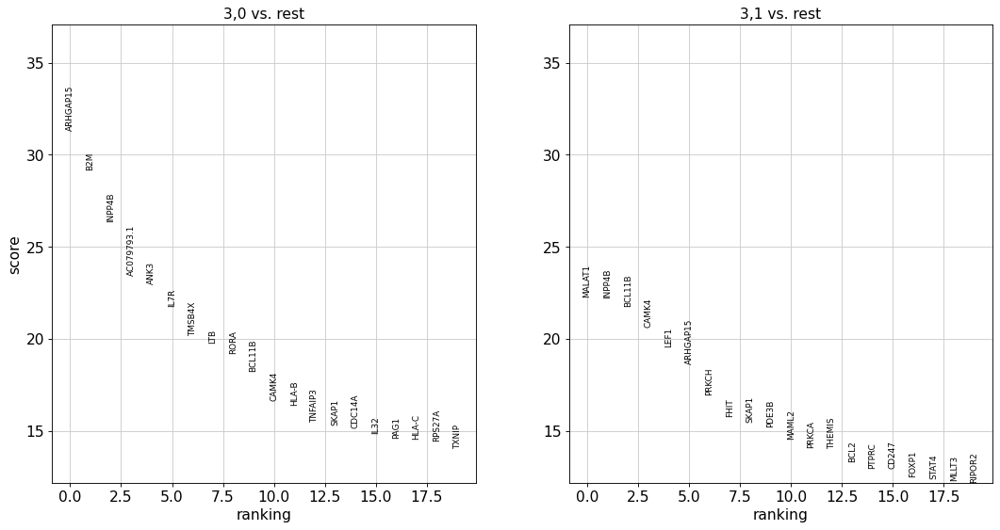

In [120]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

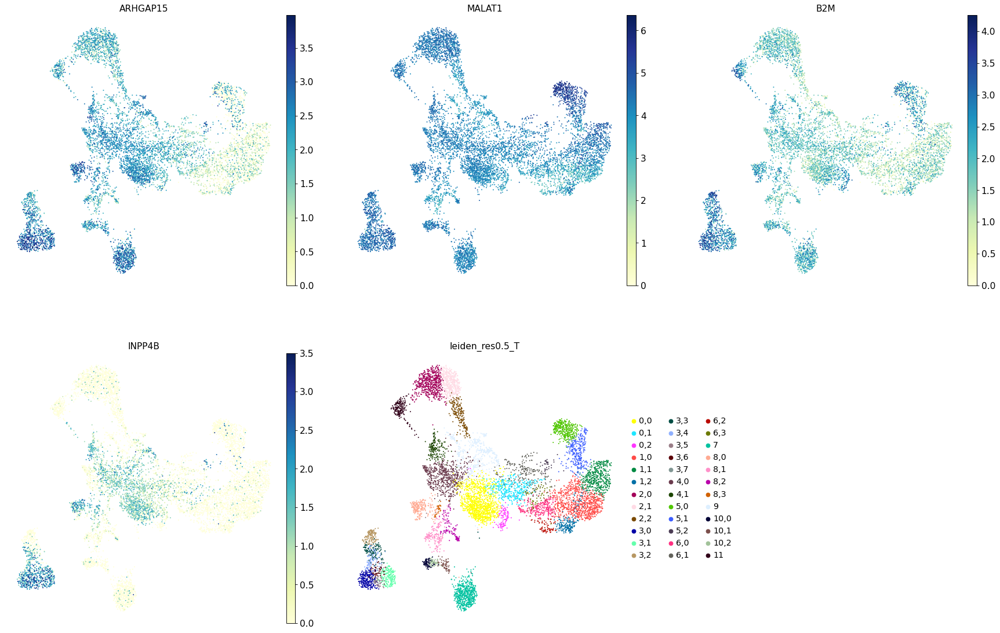

In [121]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

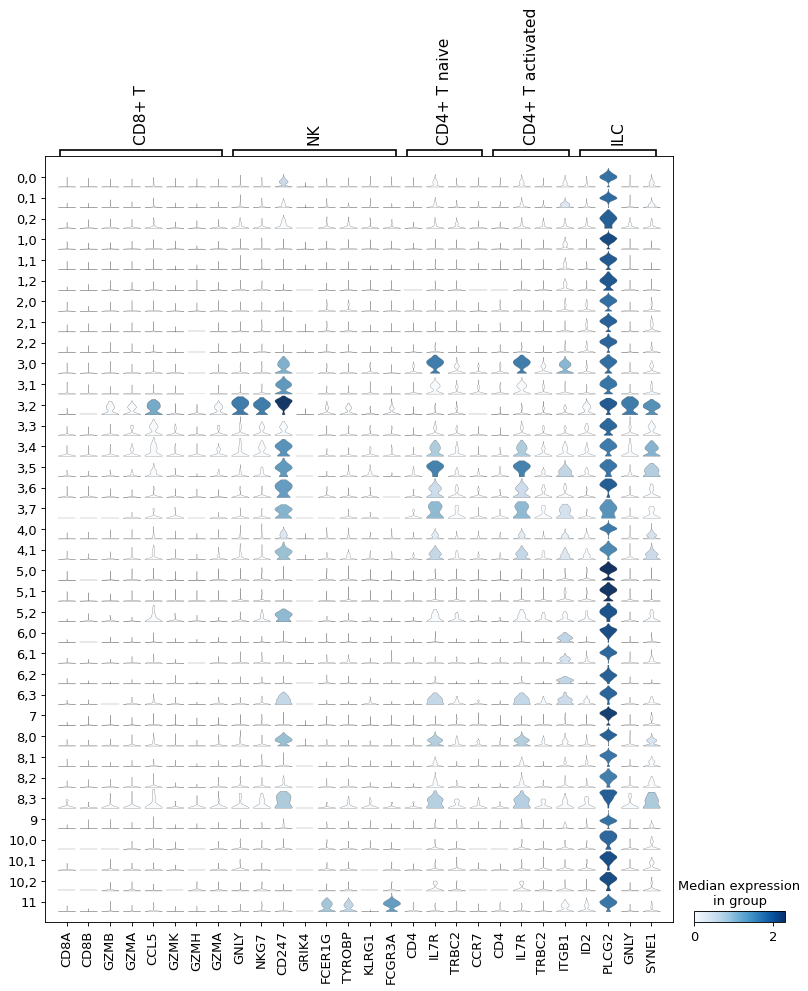

In [122]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD8+ T','NK','CD4+ T naive', 'CD4+ T activated' ,'ILC']}, groupby=new_key)

### Summary

- 3,0: CD4+ T activated
- 3,1: CD4+ T naive
- 3,2: CD8+ T / ILC
- 3,3: NK / ILC
- 3,4: NK / ILC
- 3,5: CD4+ T activated
- 3,6: CD4+ T activated
- 3,7: CD4+ T activated

## B cells - Cluster 7

### Cluster 7

In [123]:
orig_key = 'leiden_res0.5_T'
new_key = 'leiden_res0.5_CD20'
new_rg_key = 'rg_res0.5_CD20'
sub_key = '7'

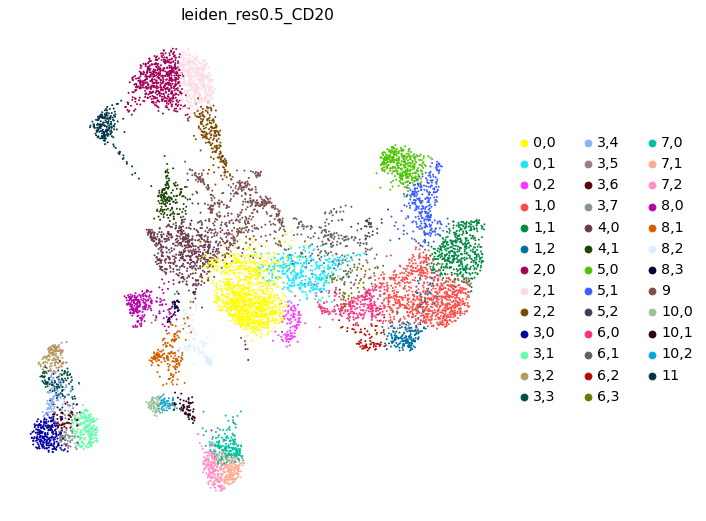

0,0     1122
1,0      852
4,0      589
2,0      581
1,1      449
9        445
2,1      429
0,1      393
5,0      360
5,1      302
6,0      258
3,0      244
8,0      221
1,2      216
6,1      216
3,1      215
7,0      211
2,2      202
11       196
7,1      190
7,2      184
8,1      181
4,1      161
3,2      139
3,3      120
3,4      117
8,2      111
0,2      105
10,0      77
6,2       74
10,1      63
6,3       62
3,5       59
10,2      57
3,6       56
5,2       33
8,3       30
3,7       30
Name: leiden_res0.5_CD20, dtype: int64

In [124]:
res = 0.5
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

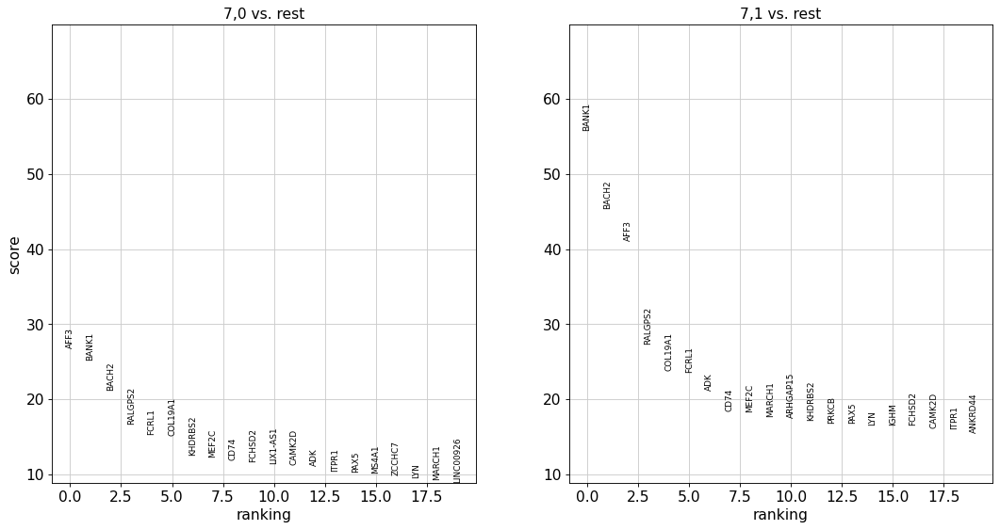

In [125]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

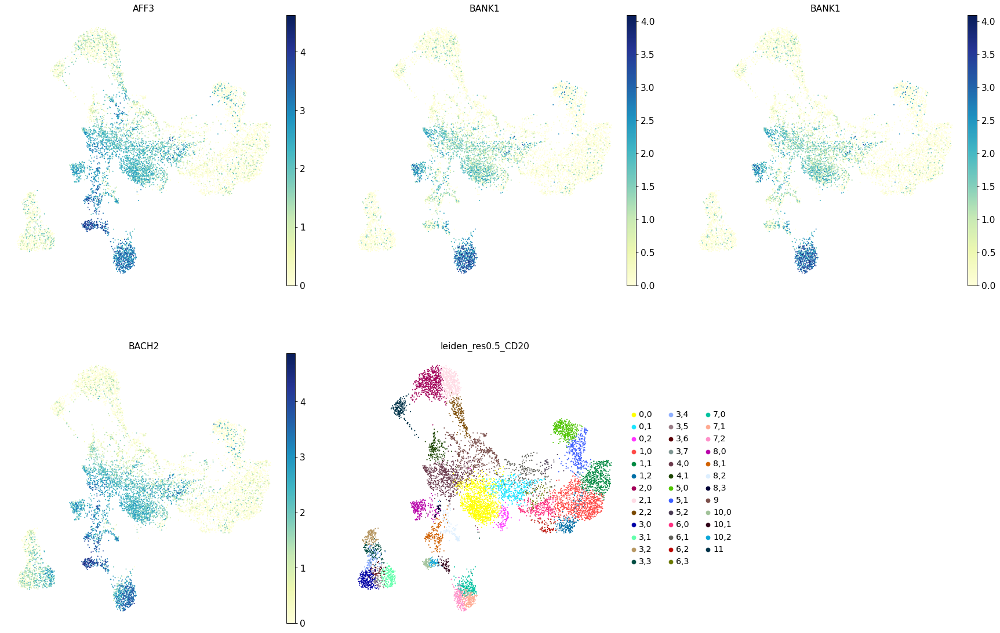

In [126]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

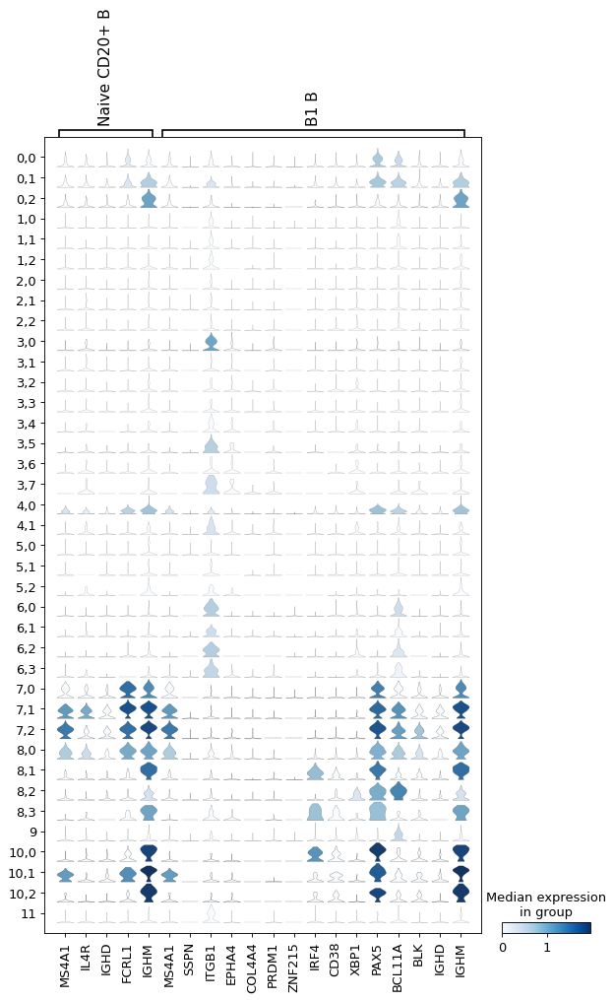

In [127]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B']}, groupby=new_key)

7 should be all Naive CD20+ B

### Summary

- 7 is Naive CD20+ B

## HSC/prog - Cluster 9

### Cluster 9

In [128]:
orig_key = 'leiden_res0.5_CD20'
new_key = 'leiden_res0.5_prog'
new_rg_key = 'rg_res0.5_prog'
sub_key = '9'

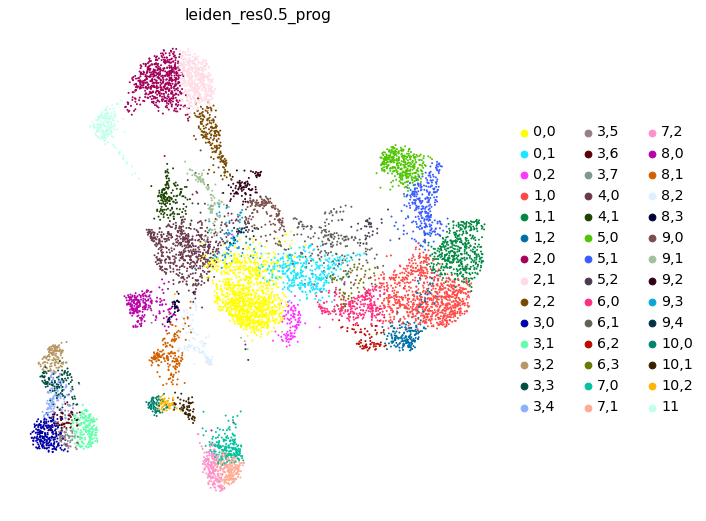

0,0     1122
1,0      852
4,0      589
2,0      581
1,1      449
2,1      429
0,1      393
5,0      360
5,1      302
6,0      258
3,0      244
8,0      221
1,2      216
6,1      216
3,1      215
7,0      211
2,2      202
11       196
7,1      190
7,2      184
8,1      181
4,1      161
9,0      143
3,2      139
3,3      120
3,4      117
8,2      111
9,1      107
0,2      105
9,2       89
9,3       78
10,0      77
6,2       74
10,1      63
6,3       62
3,5       59
10,2      57
3,6       56
5,2       33
3,7       30
8,3       30
9,4       28
Name: leiden_res0.5_prog, dtype: int64

In [129]:
res = 0.3
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

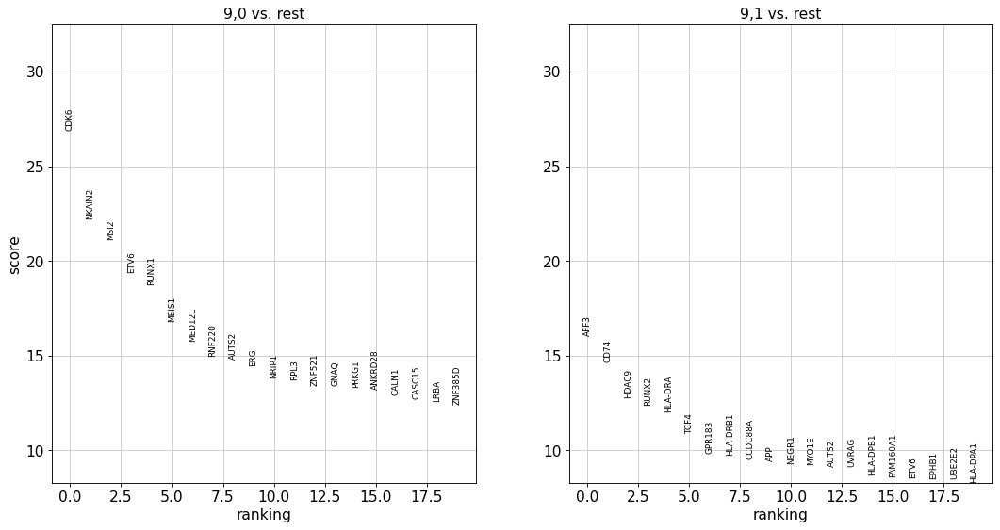

In [130]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

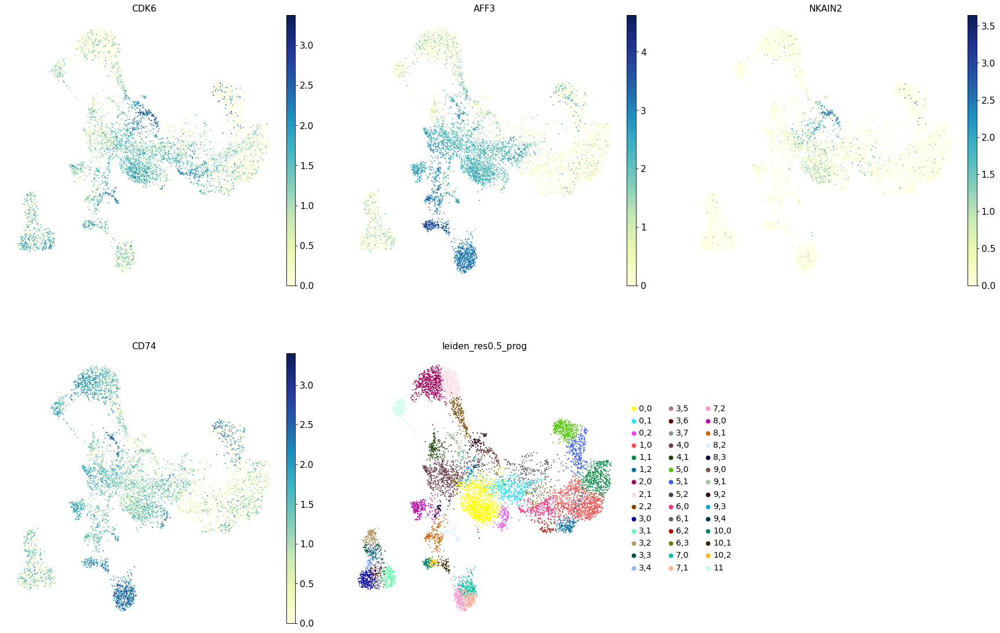

In [131]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

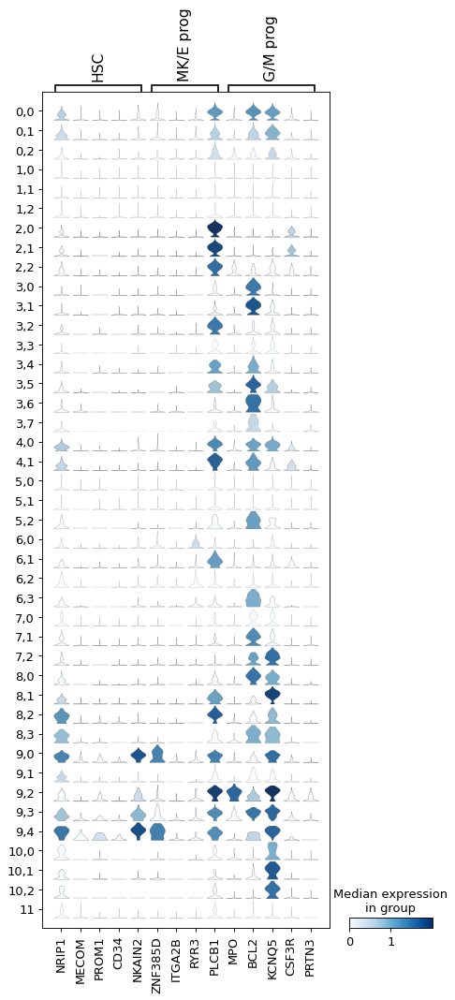

In [133]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['HSC','MK/E prog', 'G/M prog']}, groupby=new_key)

### Summary

- 9,0: 
- 9,1: HSCP/ Mono prog
- 9,2: HSCP/ Mono prog
- 9,3:
- 9,4: HSC

## CD16+ Mono/ cDC2 - Cluster 11

### Cluster 11

In [134]:
orig_key = 'leiden_res0.5_prog'
new_key = 'leiden_res0.5_CD16'
new_rg_key = 'rg_res0.5_CD16'
sub_key = '11'

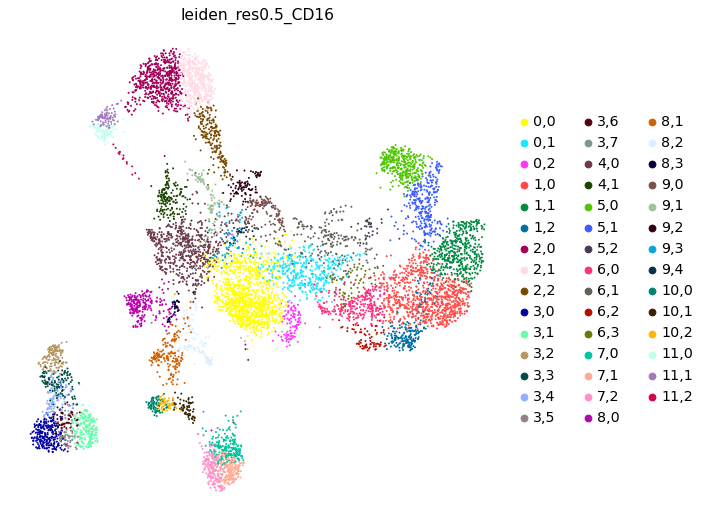

0,0     1122
1,0      852
4,0      589
2,0      581
1,1      449
2,1      429
0,1      393
5,0      360
5,1      302
6,0      258
3,0      244
8,0      221
6,1      216
1,2      216
3,1      215
7,0      211
2,2      202
7,1      190
7,2      184
8,1      181
4,1      161
9,0      143
3,2      139
3,3      120
3,4      117
8,2      111
9,1      107
0,2      105
11,0     100
9,2       89
11,1      81
9,3       78
10,0      77
6,2       74
10,1      63
6,3       62
3,5       59
10,2      57
3,6       56
5,2       33
8,3       30
3,7       30
9,4       28
11,2      15
Name: leiden_res0.5_CD16, dtype: int64

In [135]:
res = 0.5
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

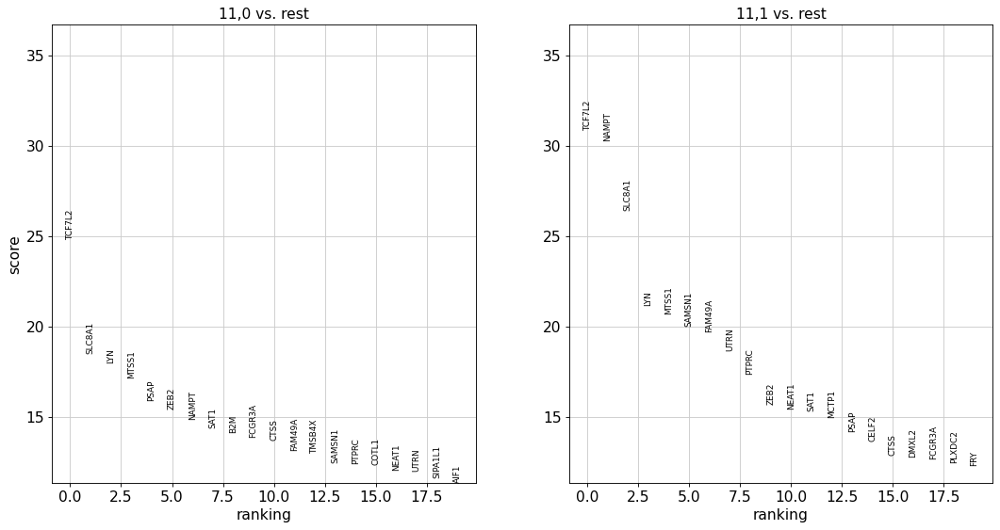

In [136]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

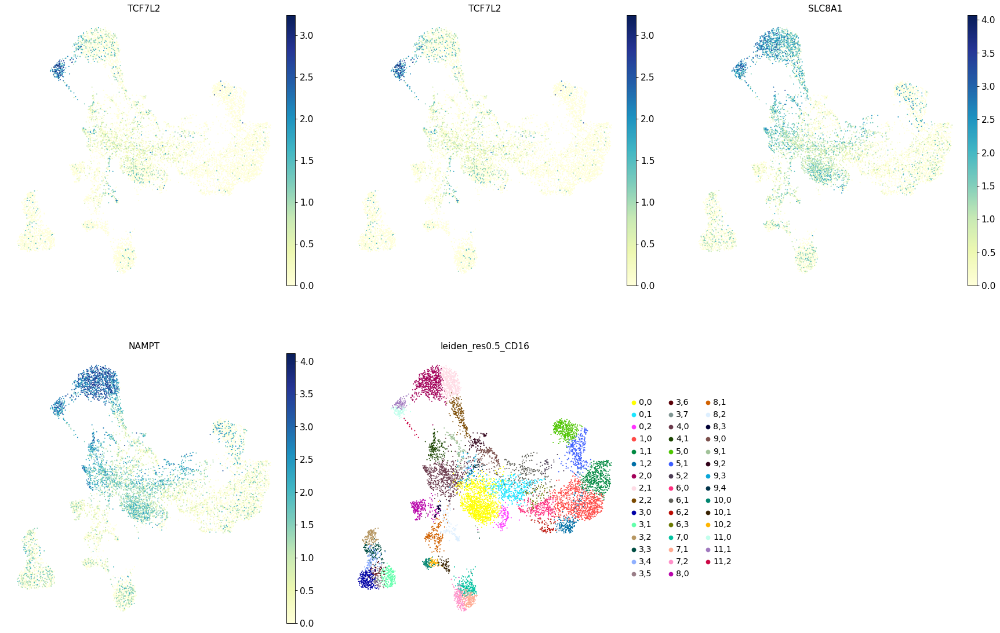

In [137]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

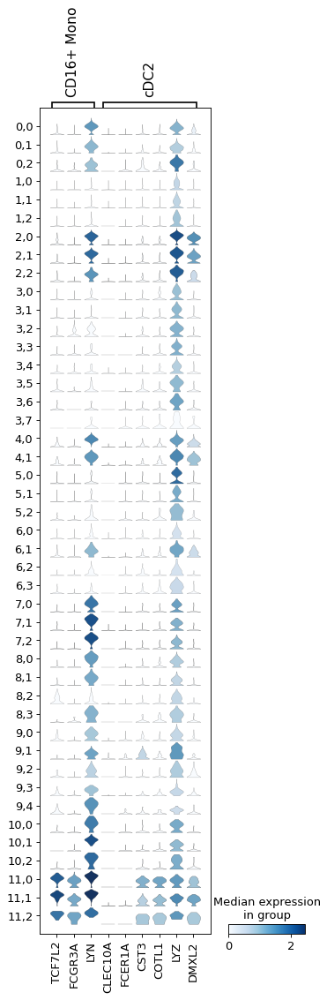

In [138]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['CD16+ Mono', 'cDC2']}, groupby=new_key)

### Summary

They all look like CD16+ Mono

## subclustering 9,0

In [139]:
orig_key = 'leiden_res0.5_CD16'
new_key = 'leiden_res0.5_prog_2'
new_rg_key = 'rg_res0.5_prog_2'
sub_key = '9,0'

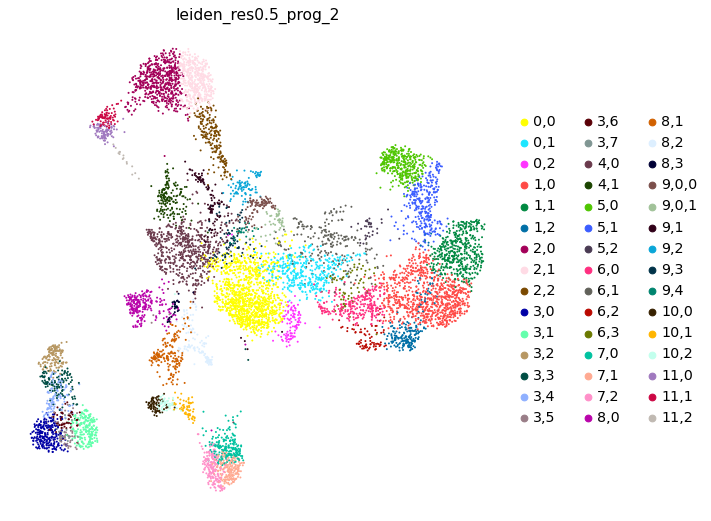

0,0      1122
1,0       852
4,0       589
2,0       581
1,1       449
2,1       429
0,1       393
5,0       360
5,1       302
6,0       258
3,0       244
8,0       221
6,1       216
1,2       216
3,1       215
7,0       211
2,2       202
7,1       190
7,2       184
8,1       181
4,1       161
3,2       139
3,3       120
3,4       117
8,2       111
9,1       107
0,2       105
11,0      100
9,0,0      93
9,2        89
11,1       81
9,3        78
10,0       77
6,2        74
10,1       63
6,3        62
3,5        59
10,2       57
3,6        56
9,0,1      50
5,2        33
8,3        30
3,7        30
9,4        28
11,2       15
Name: leiden_res0.5_prog_2, dtype: int64

In [140]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

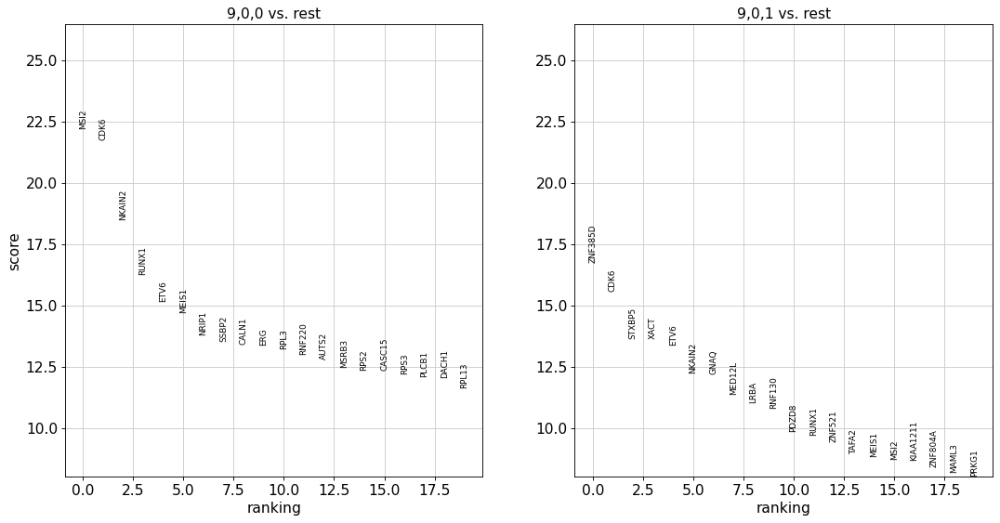

In [141]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

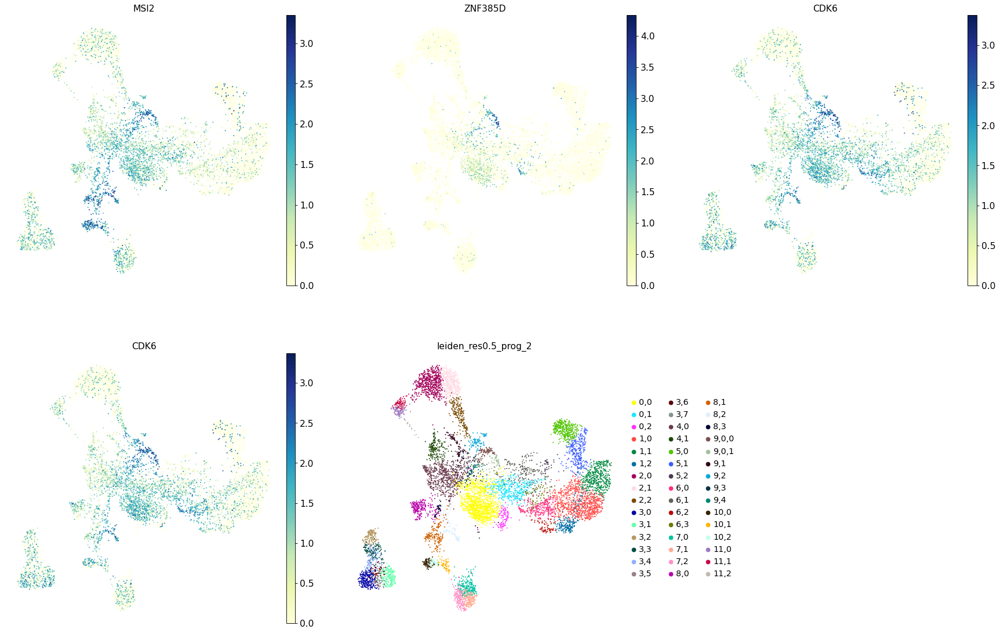

In [142]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

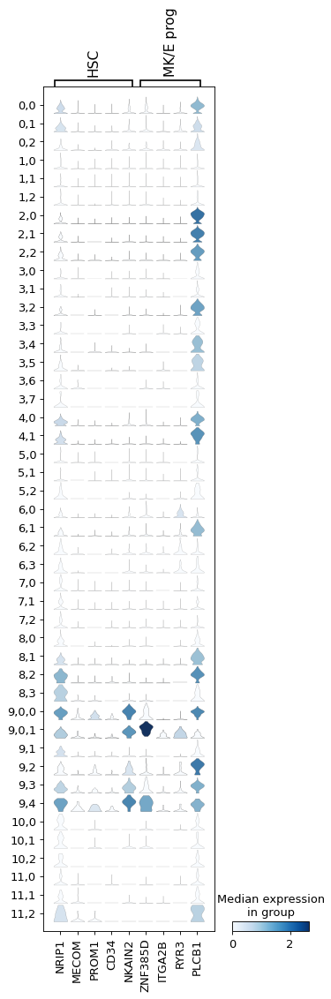

In [143]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['HSC','MK/E prog']}, groupby=new_key)

### Summary

- 9,0,0: HSC
- 9,0,1: MK/E prog


## subclustering 9,1

In [144]:
orig_key = 'leiden_res0.5_prog_2'
new_key = 'leiden_res0.5_prog_3'
new_rg_key = 'rg_res0.5_prog_3'
sub_key = '9,1'

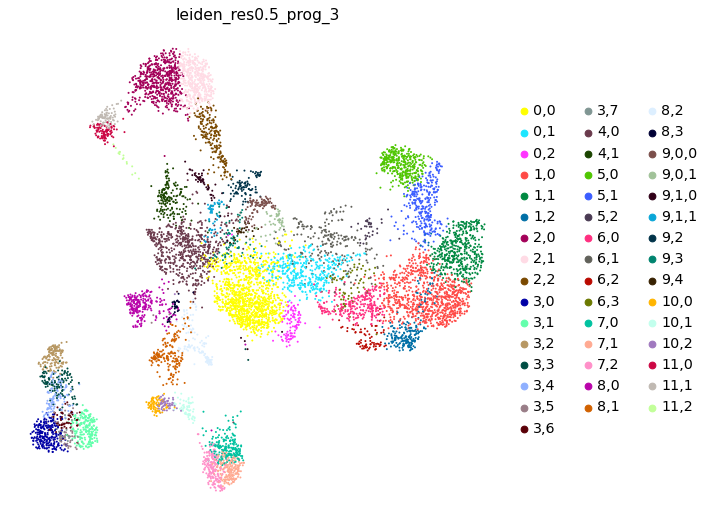

0,0      1122
1,0       852
4,0       589
2,0       581
1,1       449
2,1       429
0,1       393
5,0       360
5,1       302
6,0       258
3,0       244
8,0       221
6,1       216
1,2       216
3,1       215
7,0       211
2,2       202
7,1       190
7,2       184
8,1       181
4,1       161
3,2       139
3,3       120
3,4       117
8,2       111
0,2       105
11,0      100
9,0,0      93
9,2        89
11,1       81
9,3        78
10,0       77
6,2        74
10,1       63
6,3        62
3,5        59
9,1,0      58
10,2       57
3,6        56
9,0,1      50
9,1,1      49
5,2        33
8,3        30
3,7        30
9,4        28
11,2       15
Name: leiden_res0.5_prog_3, dtype: int64

In [145]:
res = 0.2
sc.tl.leiden(adata_gex, restrict_to=(orig_key,[sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata_gex, color=new_key)
adata_gex.obs[new_key].value_counts()

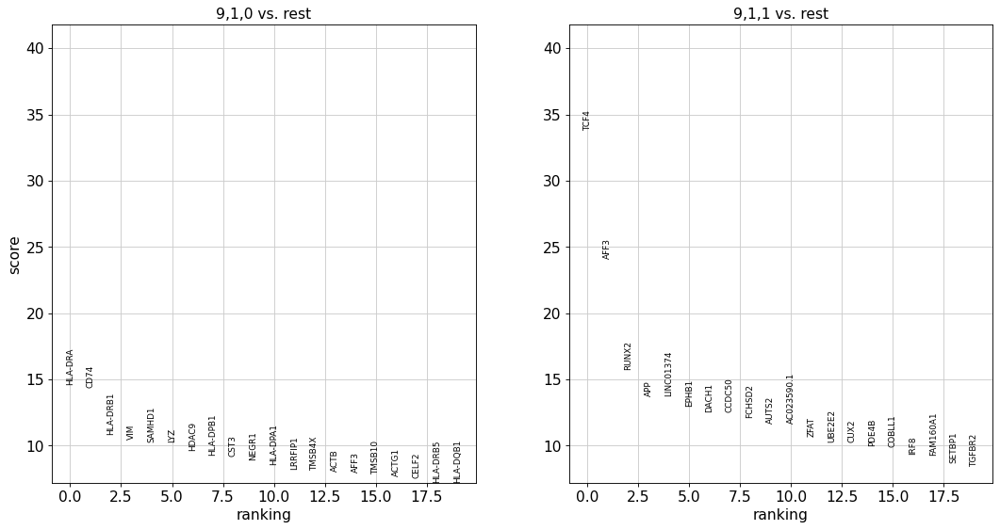

In [146]:
# Find markers of subclusters
num_subclusts = 2
new_groups = [sub_key+','+str(i) for i in range(num_subclusts)]
sc.tl.rank_genes_groups(adata_gex, groupby=new_key, key_added=new_rg_key, groups=new_groups)
sc.pl.rank_genes_groups(adata_gex, key=new_rg_key, groups=new_groups, ncols=3)

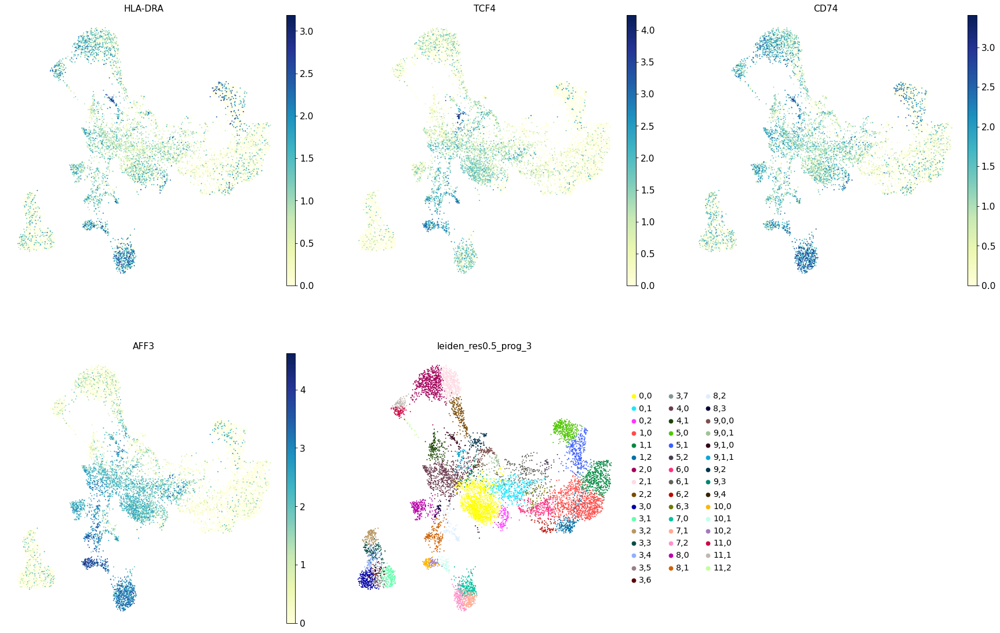

In [147]:
top_2_genes = list(adata_gex.uns[new_rg_key]['names'][0])+list(adata_gex.uns[new_rg_key]['names'][1])
sc.pl.umap(adata_gex, color=top_2_genes+[new_key], ncols=3)

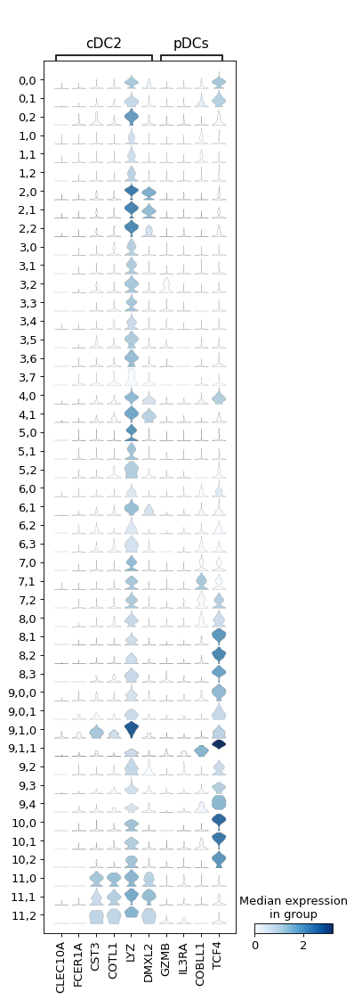

In [148]:
sc.pl.stacked_violin(adata_gex, var_names={a:marker_genes[a] for a in ['cDC2','pDCs']}, groupby=new_key)

### Summary

- 9,1,0: cDC2
- 9,1,1: PDCs


## The doublet cluster - Clusters 0.1, 4, 8.3, 5.2, 6.1, 6.3, 9.4, 9.3

### Summary

=> Filter out both!

# Cluster overview

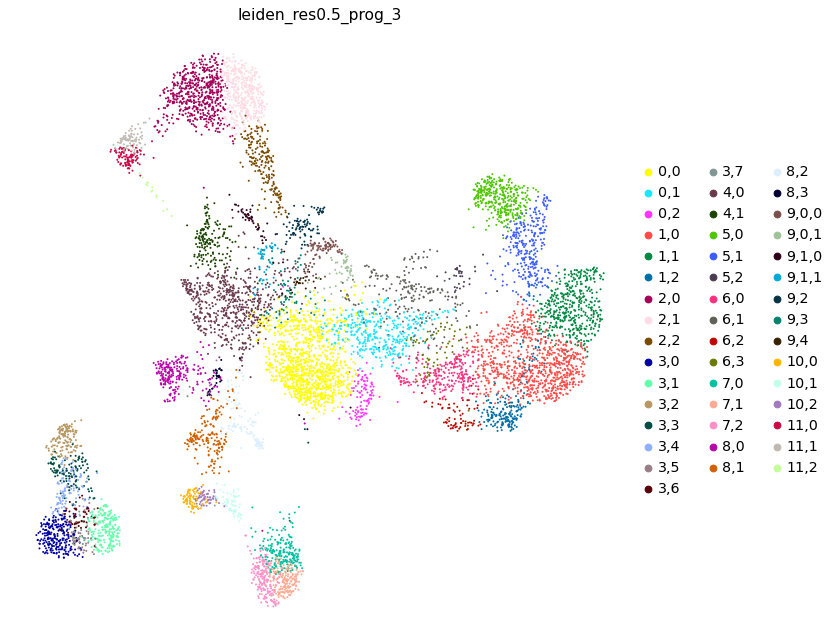

In [149]:
final_leiden = 'leiden_res0.5_prog_3'
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex, color=final_leiden)
plt.rcParams['figure.figsize'] = (8,8)

## Doublet filtering

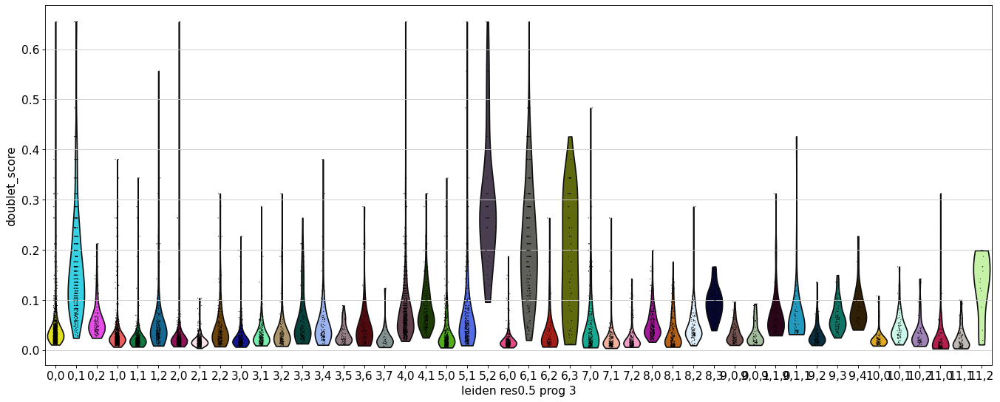

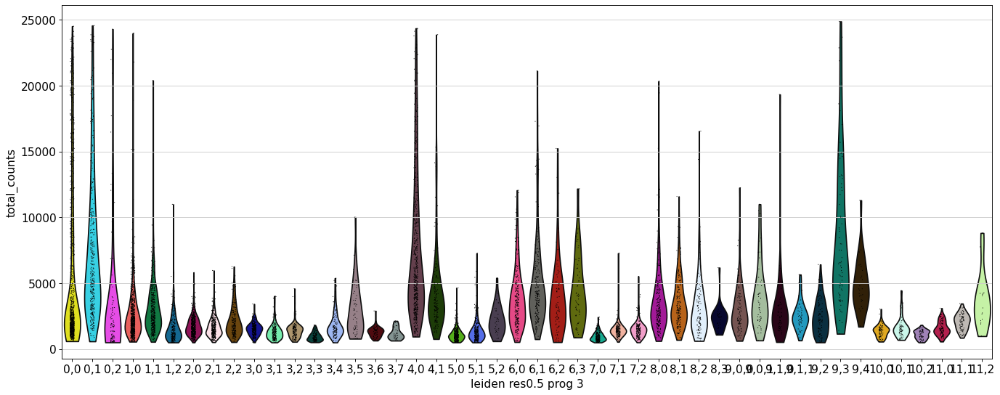

In [150]:
plt.rcParams['figure.figsize']=(16,8)
sc.pl.violin(adata_gex, keys='doublet_score', groupby=final_leiden)
sc.pl.violin(adata_gex, keys='total_counts', groupby=final_leiden)
plt.rcParams['figure.figsize']=(8,8)


Doublet clusters: Always lower expression than in their "parent" clusters; all RNA markers!
- B & T: 'CD24', 'CD22', 'ARHGAP24', 'BANK1', 'BACH2', 'AFF3', 'CD247', 'BCL11B', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R'
- Erythro+others: 'HBB', 'HBA1', 'ANK1'
- Mono+B: 'PLXDC2', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5'
- Mono+T: 'PLXDC2', 'ARHGAP26', 'FCN1', 'BCL11B', 'SKAP1', 'CD247'

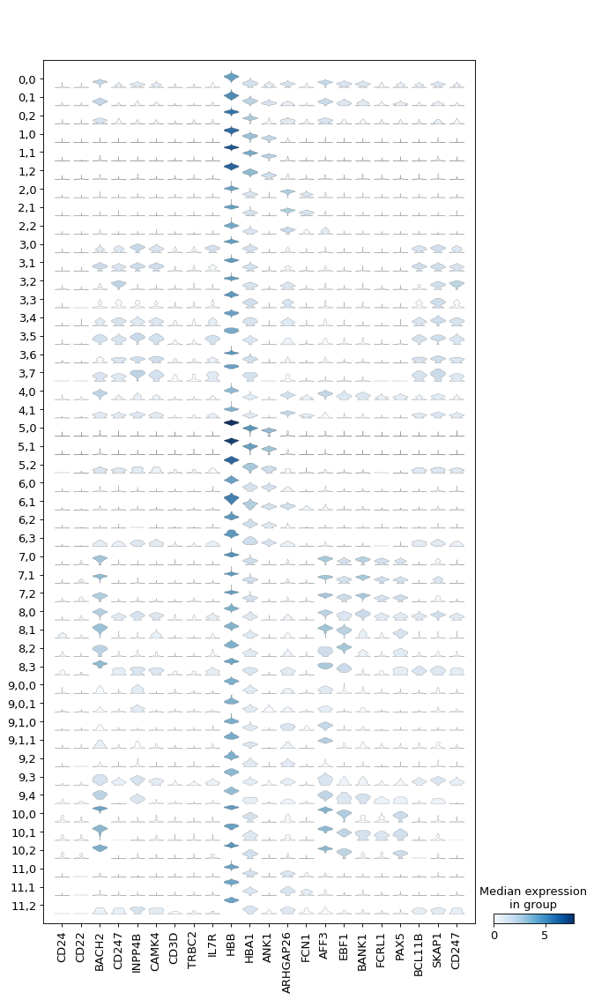

In [151]:
# Check the above markers again to make sure
sc.pl.stacked_violin(adata_gex, var_names=['CD24', 'CD22', 'BACH2', 'CD247', 'INPP4B', 'CAMK4', 'CD3D', 'TRBC2', 'IL7R', 
                                           'HBB', 'HBA1', 'ANK1', 'ARHGAP26', 'FCN1', 'AFF3', 'EBF1', 'BANK1', 'FCRL1', 'PAX5', 
                                           'BCL11B', 'SKAP1', 'CD247'], groupby=final_leiden)

Indeed the likely doublet clusters have broad expression of all markers, and don't express any marker more highly than any other cell cluster that is not designated as doublet.

In [181]:
adata_gex_filt = adata_gex[~adata_gex.obs[final_leiden].isin(['0,0', '0,1', '0,2','4,0','4,1', '8,0', '8,3', '5,2', '6,1','6,3','9,4','9,3','11,2'])].copy()

## Rename clusters

In [182]:
# Merge eythroblast subclusters
adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs[final_leiden]
adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].astype('category')
adata_gex_filt.obs['leiden_final'].cat.categories
#adata_gex_filt.obs['leiden_final'].value_counts()

Index(['1,0', '1,1', '1,2', '2,0', '2,1', '2,2', '3,0', '3,1', '3,2', '3,3',
       '3,4', '3,5', '3,6', '3,7', '5,0', '5,1', '6,0', '6,2', '7,0', '7,1',
       '7,2', '8,1', '8,2', '9,0,0', '9,0,1', '9,1,0', '9,1,1', '9,2', '10,0',
       '10,1', '10,2', '11,0', '11,1'],
      dtype='object')

In [183]:
rename_clust_dict = {
    '1,0':'Erythroblast',
    '1,1':'Erythroblast',
    '1,2':'Erythroblast',
    '11,0':'CD16+ mono',
    '11,1':'CD16+ mono',
    '2,0':'CD14+ mono', 
    '2,1':'CD14+ mono',
    '2,2':'CD14+ mono',
    '3,0':'CD4+ T activated', 
    '3,1': 'CD4+ T naive',
    '3,2': 'NK',
    '3,3': 'CD8+ T',
    '3,4': 'CD8+ T',
    '3,5': 'CD4+ T activated',
    '3,6': 'CD4+ T activated',
    '3,7': 'CD4+ T activated',
    '5,0':'Normoblast',
    '5,1':'Normoblast',
    '6,0':'Proerythroblast', 
    '6,2':'Proerythroblast',
    '7,0':'Naive CD20+ B',
    '7,1':'Naive CD20+ B',
    '7,2':'Naive CD20+ B', 
    '8,1':'Lymph prog', 
    '8,2':'Lymph prog', 
    '9,0,0':'HSC', 
    '9,0,1':'MK/E prog',
    '9,1,0':'cDC2', 
    '9,1,1':'pDCs', 
    '9,2':'G/M prog',  
    '10,0':'Transitional B', 
    '10,1':'Transitional B', 
    '10,2':'Transitional B'
}

In [184]:
adata_gex_filt.obs = adata_gex_filt.obs.replace({'leiden_final':rename_clust_dict})

In [185]:
# Note: this must be done in the same order as the categories above!
#adata_gex_filt.rename_categories('leiden_final', [rename_clust_dict[ct] for ct in adata_gex_filt.obs['leiden_final'].cat.categories])

In [186]:
adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].astype("category")

In [187]:
set(adata_gex_filt.obs['leiden_final'])

{'CD14+ mono',
 'CD16+ mono',
 'CD4+ T activated',
 'CD4+ T naive',
 'CD8+ T',
 'Erythroblast',
 'G/M prog',
 'HSC',
 'Lymph prog',
 'MK/E prog',
 'NK',
 'Naive CD20+ B',
 'Normoblast',
 'Proerythroblast',
 'Transitional B',
 'cDC2',
 'pDCs'}

In [188]:
#adata_gex_filt.obs['leiden_final'] = adata_gex_filt.obs['leiden_final'].cat.reorder_categories(['CD14+ Mono', 'CD14+ mono prog', 'CD16+ Mono', 'pDC', 'cDC2', 'naive CD20+ B', 'B1 B', 
#                            'Transitional B', 'Plasma cell', 'HSC', 'HSPC/Mono prog', 'Lymph prog', 'HSPC/Lymph prog?', 'MK/E prog', 
#                            'Proerythroblast', 'Erythroblast', 'Reticulocyte', 'CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC'])

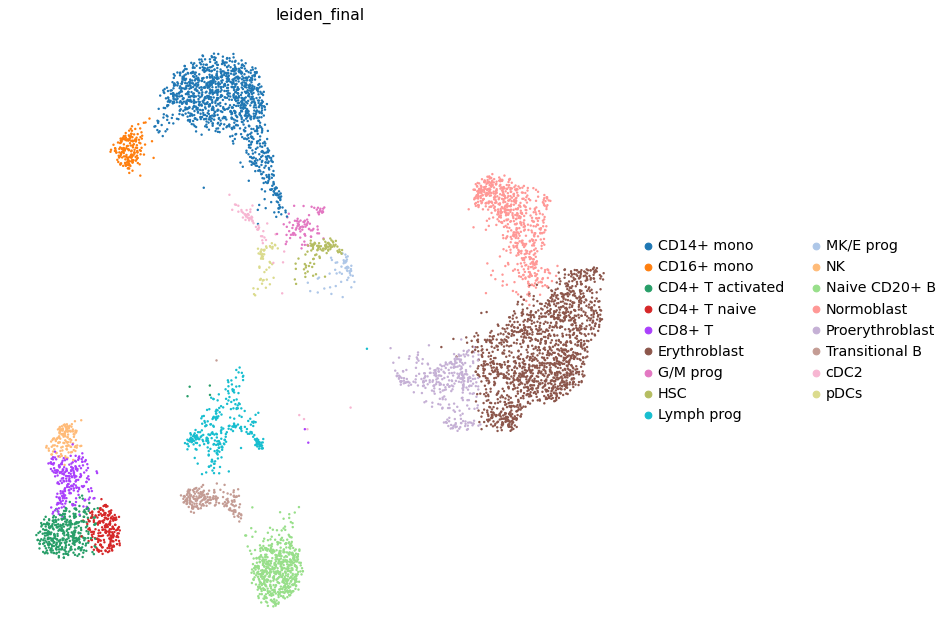

In [189]:
plt.rcParams['figure.figsize'] = (10,10)
sc.pl.umap(adata_gex_filt, color='leiden_final')
plt.rcParams['figure.figsize'] = (8,8)

# Marker overview

In [190]:
marker_genes.keys()

dict_keys(['CD14+ Mono', 'CD16+ Mono', 'ID2-hi myeloid prog', 'cDC1', 'cDC2', 'Reticulocyte', 'Erythroblast', 'Proerythroblast', 'NK', 'ILC', 'Lymph prog', 'Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells', 'Plasmablast', 'CD4+ T activated', 'CD4+ T naive', 'CD8+ T', 'T activation', 'T naive', 'pDCs', 'G/M prog', 'HSC', 'MK/E prog'])

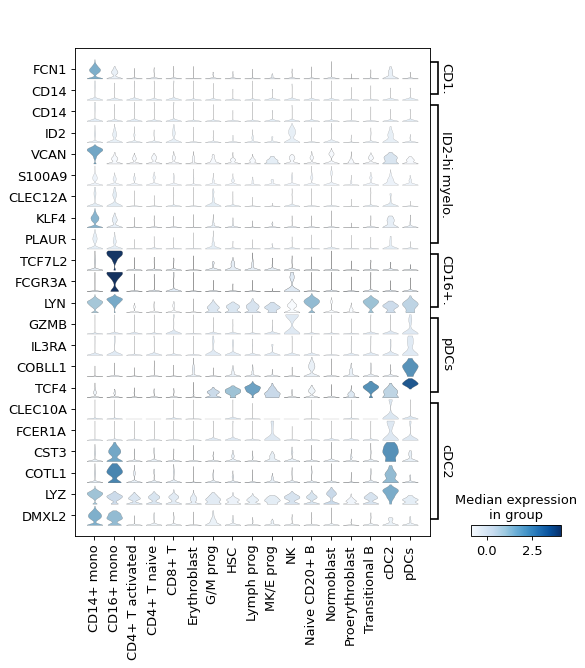

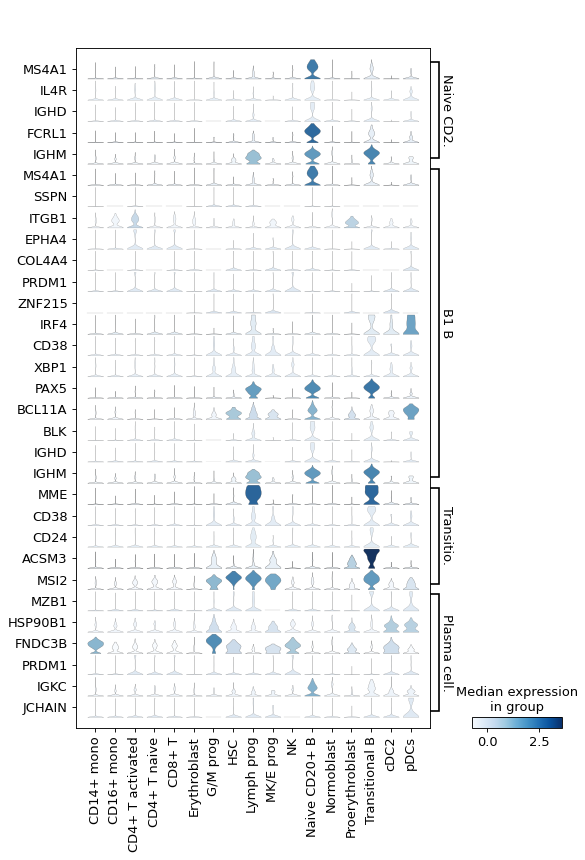

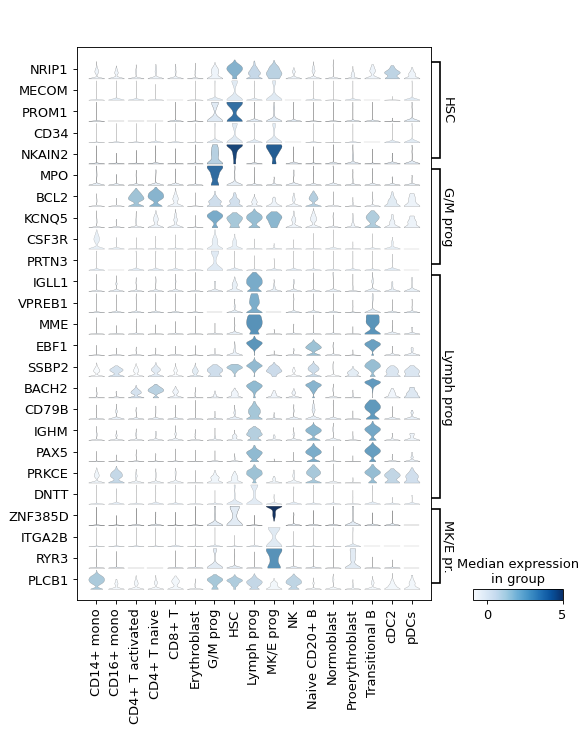

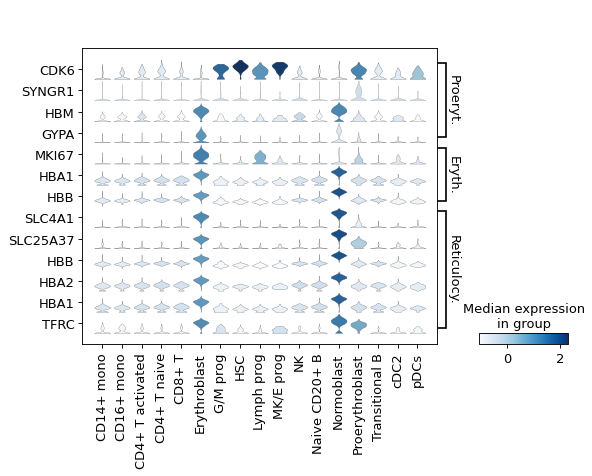

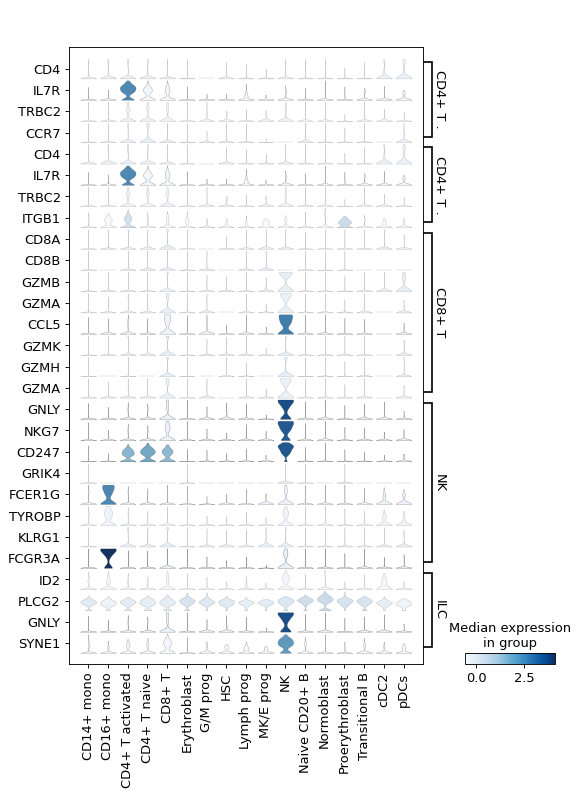

In [191]:
#Overview
adata_plot = adata_gex_filt.copy()
sc.pp.scale(adata_plot, max_value=5)

#Monocytes
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD14+ Mono', 'ID2-hi myeloid prog', 'CD16+ Mono', 'pDCs', 'cDC2']})

#B cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Naive CD20+ B', 'B1 B', 'Transitional B', 'Plasma cells']})

#Progenitors
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['HSC', 'G/M prog', 'Lymph prog', 'MK/E prog']})

#Erythropoiesis
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['Proerythroblast', 'Erythroblast', 'Reticulocyte']})


#T & NK cells
sc.pl.stacked_violin(adata_plot, groupby='leiden_final', use_raw=False, swap_axes=True,                     
                     var_names={a:marker_genes[a] for a in ['CD4+ T naive', 'CD4+ T activated', 'CD8+ T', 'NK', 'ILC']})



# Write output

In [192]:
adata_gex_filt

AnnData object with n_obs × n_vars = 6297 × 18507
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'S_score', 'G2M_score', 'phase', 'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 'predicted_doublet', 'leiden_res0.5_lymph_TrasB', 'leiden_res0.5_lymph_TrasB_4', 'leiden_res0.5_lymph_TrasB_8', 'leiden_res0.5_lymph_TrasB_10', 'leiden_res0.5_blast_1', 'leiden_res0.5_blast_5', 'leiden_res0.5_blast_6', 'leiden_res0.5_CD14', 'leiden_res0.5_T', 'leiden_res0.5_CD20', 'leiden_res0.5_prog', 'leiden_res0.5_CD16', 'leiden_res0.5_prog_2', 'leiden_res0.5_prog_3', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_d

In [193]:
adata_gex_filt_slim = adata_gex_filt.copy()
adata_gex_filt_slim.obs = adata_gex_filt_slim.obs.drop(columns=['log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 
                                                                'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'S_score', 'G2M_score', 
                                                                'leiden_res0.3', 'leiden_res0.5', 'leiden_res0.8', 'leiden_res1', 'doublet_score', 
                                                                'predicted_doublet', 'leiden_res0.5_lymph_TrasB', 'leiden_res0.5_lymph_TrasB_4', 'leiden_res0.5_lymph_TrasB_8', 
                                                                'leiden_res0.5_lymph_TrasB_10', 'leiden_res0.5_blast_1', 'leiden_res0.5_blast_5', 'leiden_res0.5_blast_6', 'leiden_res0.5_CD14'
                                                                , 'leiden_res0.5_T', 'leiden_res0.5_CD20', 'leiden_res0.5_prog', 'leiden_res0.5_CD16',])
adata_gex_filt_slim.var = adata_gex_filt_slim.var.drop(columns=['mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'means', 'dispersions', 'dispersions_norm'])

for i in ['phase_colors', 'leiden', 'leiden_res0.3_colors', 'leiden_res0.5_colors', 'leiden_res0.8_colors', 
          'leiden_res1_colors', 'predicted_doublet_colors', 'rank_genes_res0.5', 'leiden_res0.5_lymph_TrasB_colors', 
          'rg_res0.5_lymph_TrasB', 'leiden_res0.5_lymph_TrasB_4_colors', 'rg_res0.5_lymph_TrasB_4', 
          'leiden_res0.5_lymph_TrasB_8_colors', 'rg_res0.5_lymph_TrasB_8', 'leiden_res0.5_lymph_TrasB_10_colors', 
          'rg_res0.5_lymph_TrasB_10', 'leiden_res0.5_blast_1_colors', 'rg_res0.5_blast_1', 'leiden_res0.5_blast_5_colors', 'rg_res0.5_blast_5', 'leiden_res0.5_blast_6_colors', 'rg_res0.5_blast_6', 'leiden_res0.5_CD14_colors', 'rg_res0.5_CD14', 'leiden_res0.5_T_colors', 'rg_res0.5_T', 'leiden_res0.5_CD20_colors', 'rg_res0.5_CD20', 'leiden_res0.5_prog_colors'
          , 'rg_res0.5_prog', 'leiden_res0.5_CD16_colors', 'rg_res0.5_CD16', 'leiden_final_colors']:
    del adata_gex_filt_slim.uns[i]
    
adata_gex_filt_slim

AnnData object with n_obs × n_vars = 6297 × 18507
    obs: 'sample', 'n_genes_by_counts', 'pct_counts_mt', 'n_counts', 'n_genes', 'size_factors', 'phase', 'leiden_res0.5_prog_2', 'leiden_res0.5_prog_3', 'leiden_final'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'highly_variable'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'rg_res0.5_prog_2', 'rg_res0.5_prog_3', 'leiden_res0.5_prog_2_colors', 'leiden_res0.5_prog_3_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [194]:
adata_gex_filt_slim.write('../../data/S2D4_gex_updatedMarkers.h5ad')